# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

サブディレクトリまたはファイル data は既に存在します。


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

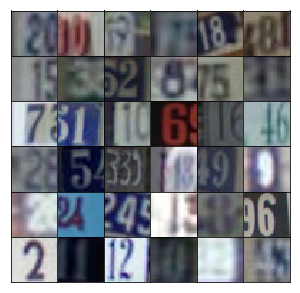

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        fc1 = tf.layers.dense(z, 4*4*512, activation=None)
        fc1 = tf.reshape(fc1, (-1, 4, 4, 512))
        fc1 = tf.layers.batch_normalization(fc1, training=training)
        fc1 = tf.maximum(alpha*fc1, fc1)
        
        conv1 = tf.layers.conv2d_transpose(fc1, 256, 5, strides=(2,2), padding='same', activation=None)
        conv1 = tf.layers.batch_normalization(conv1, training=training)
        conv1 = tf.maximum(alpha*conv1, conv1)
        
        conv2 = tf.layers.conv2d_transpose(conv1, 128, 5, strides=(2,2), padding='same', activation=None)
        conv2 = tf.layers.batch_normalization(conv2, training=training)
        conv2 = tf.maximum(alpha*conv2, conv2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv2, output_dim, 5, strides=(2,2), padding='same', activation=None)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        conv1 = tf.layers.conv2d(x, 64, 5, strides=(2,2), padding='same', activation=None)
        conv1 = tf.maximum(alpha*conv1, conv1)
        
        conv2 = tf.layers.conv2d(conv1, 128, 5, strides=(2,2), padding='same', activation=None)
        conv2 = tf.layers.batch_normalization(conv2)
        conv2 = tf.maximum(alpha*conv2, conv2)
        
        conv3 = tf.layers.conv2d(conv2, 256, 5, strides=(2,2), padding='same', activation=None)
        conv3 = tf.layers.batch_normalization(conv3)
        conv3 = tf.maximum(alpha*conv3, conv3)
        
        flat = tf.reshape(conv3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.2331... Generator Loss: 2.3212
Epoch 1/25... Discriminator Loss: 1.3468... Generator Loss: 0.6087
Epoch 1/25... Discriminator Loss: 1.0669... Generator Loss: 1.8855
Epoch 1/25... Discriminator Loss: 0.6191... Generator Loss: 4.1477
Epoch 1/25... Discriminator Loss: 1.1164... Generator Loss: 10.9279
Epoch 1/25... Discriminator Loss: 1.4476... Generator Loss: 6.0525
Epoch 1/25... Discriminator Loss: 0.6887... Generator Loss: 2.6465
Epoch 1/25... Discriminator Loss: 0.7844... Generator Loss: 1.4206
Epoch 1/25... Discriminator Loss: 0.4748... Generator Loss: 1.6753
Epoch 1/25... Discriminator Loss: 0.5941... Generator Loss: 1.7527


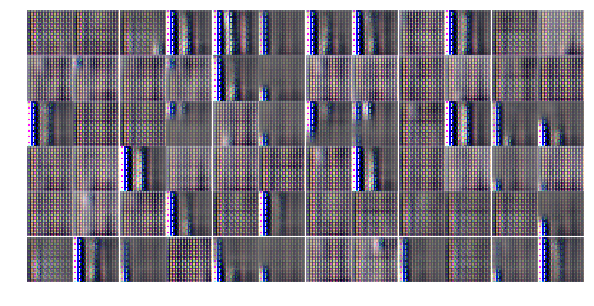

Epoch 1/25... Discriminator Loss: 0.9133... Generator Loss: 0.9780
Epoch 1/25... Discriminator Loss: 0.8800... Generator Loss: 1.0704
Epoch 1/25... Discriminator Loss: 1.1381... Generator Loss: 0.7031
Epoch 1/25... Discriminator Loss: 1.0218... Generator Loss: 1.3605
Epoch 1/25... Discriminator Loss: 0.8329... Generator Loss: 1.9830
Epoch 1/25... Discriminator Loss: 0.8601... Generator Loss: 1.3772
Epoch 1/25... Discriminator Loss: 0.8353... Generator Loss: 1.8112
Epoch 1/25... Discriminator Loss: 0.6344... Generator Loss: 1.8015
Epoch 1/25... Discriminator Loss: 0.7206... Generator Loss: 1.4716
Epoch 1/25... Discriminator Loss: 0.6624... Generator Loss: 1.7381


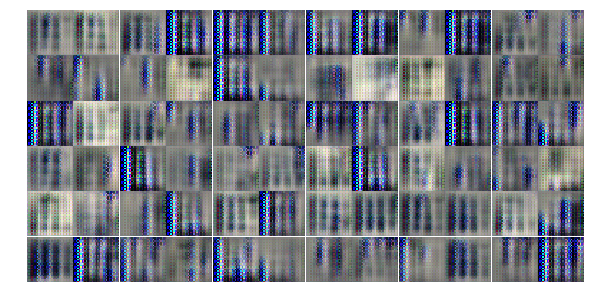

Epoch 1/25... Discriminator Loss: 0.7028... Generator Loss: 2.3177
Epoch 1/25... Discriminator Loss: 0.9639... Generator Loss: 2.1788
Epoch 1/25... Discriminator Loss: 0.8702... Generator Loss: 1.0351
Epoch 1/25... Discriminator Loss: 1.5434... Generator Loss: 1.0367
Epoch 1/25... Discriminator Loss: 0.8553... Generator Loss: 0.9027
Epoch 1/25... Discriminator Loss: 0.6967... Generator Loss: 1.3745
Epoch 1/25... Discriminator Loss: 0.6081... Generator Loss: 1.6591
Epoch 1/25... Discriminator Loss: 0.8190... Generator Loss: 1.2564
Epoch 1/25... Discriminator Loss: 0.7374... Generator Loss: 1.2097
Epoch 1/25... Discriminator Loss: 0.8649... Generator Loss: 1.5918


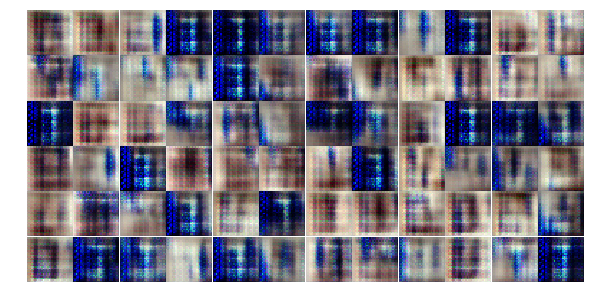

Epoch 1/25... Discriminator Loss: 0.6919... Generator Loss: 1.6663
Epoch 1/25... Discriminator Loss: 1.0154... Generator Loss: 2.6364
Epoch 1/25... Discriminator Loss: 0.7931... Generator Loss: 2.7829
Epoch 1/25... Discriminator Loss: 1.2342... Generator Loss: 1.1769
Epoch 1/25... Discriminator Loss: 0.6609... Generator Loss: 1.3731
Epoch 1/25... Discriminator Loss: 1.2345... Generator Loss: 0.9596
Epoch 1/25... Discriminator Loss: 0.7588... Generator Loss: 1.5762
Epoch 1/25... Discriminator Loss: 0.8281... Generator Loss: 1.7764
Epoch 1/25... Discriminator Loss: 1.2335... Generator Loss: 1.4518
Epoch 1/25... Discriminator Loss: 1.3457... Generator Loss: 0.8638


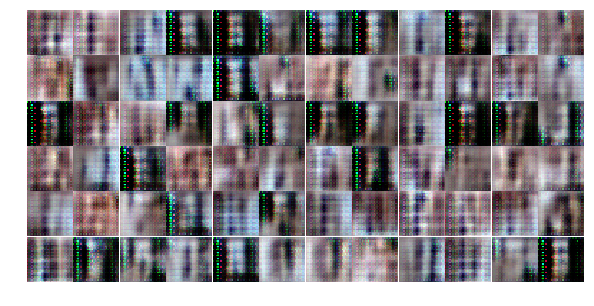

Epoch 1/25... Discriminator Loss: 1.0234... Generator Loss: 1.0642
Epoch 1/25... Discriminator Loss: 1.0283... Generator Loss: 1.2597
Epoch 1/25... Discriminator Loss: 0.8141... Generator Loss: 1.3540
Epoch 1/25... Discriminator Loss: 0.9969... Generator Loss: 1.2648
Epoch 1/25... Discriminator Loss: 2.6030... Generator Loss: 3.2506
Epoch 1/25... Discriminator Loss: 1.2001... Generator Loss: 0.8807
Epoch 1/25... Discriminator Loss: 1.0208... Generator Loss: 0.9136
Epoch 1/25... Discriminator Loss: 1.2715... Generator Loss: 1.6646
Epoch 1/25... Discriminator Loss: 1.1092... Generator Loss: 1.4855
Epoch 1/25... Discriminator Loss: 1.0615... Generator Loss: 0.8851


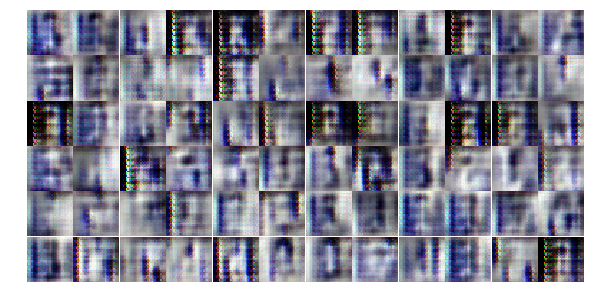

Epoch 1/25... Discriminator Loss: 1.2114... Generator Loss: 0.8772
Epoch 1/25... Discriminator Loss: 1.0416... Generator Loss: 0.9679
Epoch 1/25... Discriminator Loss: 0.7697... Generator Loss: 1.7232
Epoch 1/25... Discriminator Loss: 0.9710... Generator Loss: 1.1681
Epoch 1/25... Discriminator Loss: 0.8356... Generator Loss: 1.2489
Epoch 1/25... Discriminator Loss: 1.5495... Generator Loss: 0.8864
Epoch 1/25... Discriminator Loss: 0.9314... Generator Loss: 1.0864
Epoch 2/25... Discriminator Loss: 1.0969... Generator Loss: 0.8899
Epoch 2/25... Discriminator Loss: 0.9730... Generator Loss: 1.1176
Epoch 2/25... Discriminator Loss: 0.9574... Generator Loss: 1.2180


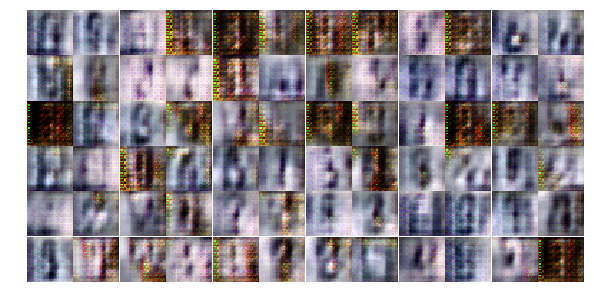

Epoch 2/25... Discriminator Loss: 3.3157... Generator Loss: 0.2875
Epoch 2/25... Discriminator Loss: 8.8034... Generator Loss: 0.0567
Epoch 2/25... Discriminator Loss: 188.6289... Generator Loss: 571.8164
Epoch 2/25... Discriminator Loss: 6.2686... Generator Loss: 14.0017
Epoch 2/25... Discriminator Loss: 0.6943... Generator Loss: 24.3175
Epoch 2/25... Discriminator Loss: 0.8296... Generator Loss: 16.3803
Epoch 2/25... Discriminator Loss: 0.1257... Generator Loss: 15.0831
Epoch 2/25... Discriminator Loss: 0.2809... Generator Loss: 9.8162
Epoch 2/25... Discriminator Loss: 1.0116... Generator Loss: 9.9159
Epoch 2/25... Discriminator Loss: 2.6558... Generator Loss: 12.9106


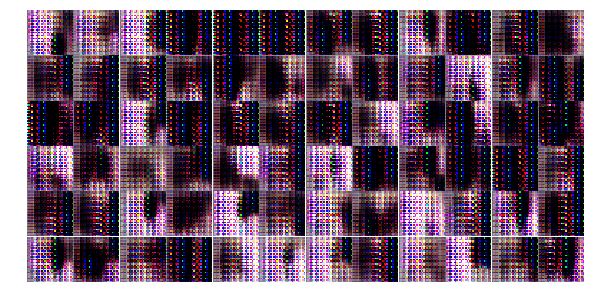

Epoch 2/25... Discriminator Loss: 0.1432... Generator Loss: 9.0353
Epoch 2/25... Discriminator Loss: 0.2928... Generator Loss: 7.3581
Epoch 2/25... Discriminator Loss: 0.0602... Generator Loss: 13.0668
Epoch 2/25... Discriminator Loss: 0.8055... Generator Loss: 8.1007
Epoch 2/25... Discriminator Loss: 1.7467... Generator Loss: 8.3022
Epoch 2/25... Discriminator Loss: 7.1394... Generator Loss: 1.7716
Epoch 2/25... Discriminator Loss: 0.6935... Generator Loss: 4.2236
Epoch 2/25... Discriminator Loss: 0.7316... Generator Loss: 3.0717
Epoch 2/25... Discriminator Loss: 0.6506... Generator Loss: 2.1973
Epoch 2/25... Discriminator Loss: 0.5384... Generator Loss: 3.5557


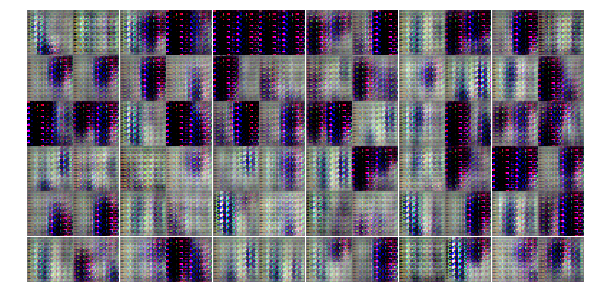

Epoch 2/25... Discriminator Loss: 0.7762... Generator Loss: 1.6814
Epoch 2/25... Discriminator Loss: 3.8217... Generator Loss: 3.4940
Epoch 2/25... Discriminator Loss: 0.6366... Generator Loss: 4.4204
Epoch 2/25... Discriminator Loss: 0.7430... Generator Loss: 3.1127
Epoch 2/25... Discriminator Loss: 0.7940... Generator Loss: 2.2014
Epoch 2/25... Discriminator Loss: 0.7253... Generator Loss: 2.1129
Epoch 2/25... Discriminator Loss: 1.2481... Generator Loss: 4.6122
Epoch 2/25... Discriminator Loss: 0.9363... Generator Loss: 2.9754
Epoch 2/25... Discriminator Loss: 0.7225... Generator Loss: 1.5317
Epoch 2/25... Discriminator Loss: 1.0074... Generator Loss: 1.5082


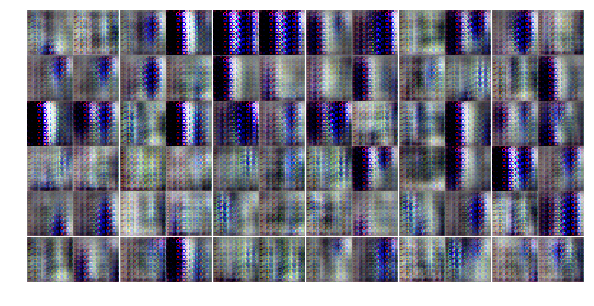

Epoch 2/25... Discriminator Loss: 1.1866... Generator Loss: 0.9459
Epoch 2/25... Discriminator Loss: 1.2351... Generator Loss: 0.7753
Epoch 2/25... Discriminator Loss: 0.9045... Generator Loss: 1.4075
Epoch 2/25... Discriminator Loss: 1.0112... Generator Loss: 1.0232
Epoch 2/25... Discriminator Loss: 0.8652... Generator Loss: 2.1084
Epoch 2/25... Discriminator Loss: 0.8983... Generator Loss: 1.5227
Epoch 2/25... Discriminator Loss: 1.2040... Generator Loss: 3.1203
Epoch 2/25... Discriminator Loss: 1.0600... Generator Loss: 2.5947
Epoch 2/25... Discriminator Loss: 1.6638... Generator Loss: 3.7170
Epoch 2/25... Discriminator Loss: 1.1345... Generator Loss: 0.9321


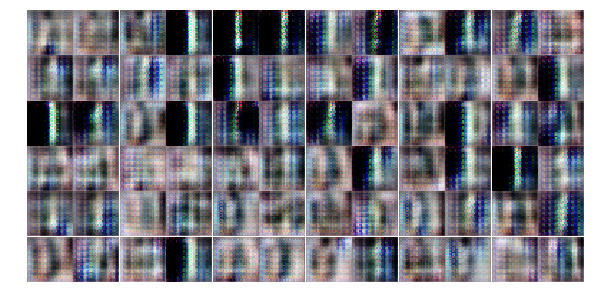

Epoch 2/25... Discriminator Loss: 0.9137... Generator Loss: 1.7466
Epoch 2/25... Discriminator Loss: 0.9162... Generator Loss: 1.3235
Epoch 2/25... Discriminator Loss: 0.8462... Generator Loss: 2.0908
Epoch 2/25... Discriminator Loss: 1.2428... Generator Loss: 2.7596
Epoch 2/25... Discriminator Loss: 1.4083... Generator Loss: 0.4853
Epoch 2/25... Discriminator Loss: 0.9610... Generator Loss: 1.4978
Epoch 2/25... Discriminator Loss: 1.1998... Generator Loss: 2.1841
Epoch 2/25... Discriminator Loss: 0.9487... Generator Loss: 1.8223
Epoch 2/25... Discriminator Loss: 1.0451... Generator Loss: 0.8768
Epoch 2/25... Discriminator Loss: 1.3174... Generator Loss: 2.8726


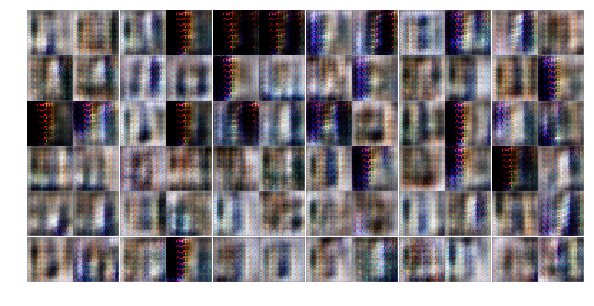

Epoch 2/25... Discriminator Loss: 1.0891... Generator Loss: 1.5192
Epoch 2/25... Discriminator Loss: 0.8922... Generator Loss: 1.5858
Epoch 2/25... Discriminator Loss: 0.9985... Generator Loss: 1.0988
Epoch 2/25... Discriminator Loss: 1.2457... Generator Loss: 0.7522
Epoch 3/25... Discriminator Loss: 0.4997... Generator Loss: 5.1928
Epoch 3/25... Discriminator Loss: 1.1931... Generator Loss: 1.0720
Epoch 3/25... Discriminator Loss: 0.9548... Generator Loss: 1.0042
Epoch 3/25... Discriminator Loss: 1.2678... Generator Loss: 2.6343
Epoch 3/25... Discriminator Loss: 0.7903... Generator Loss: 1.6751
Epoch 3/25... Discriminator Loss: 1.1024... Generator Loss: 0.8010


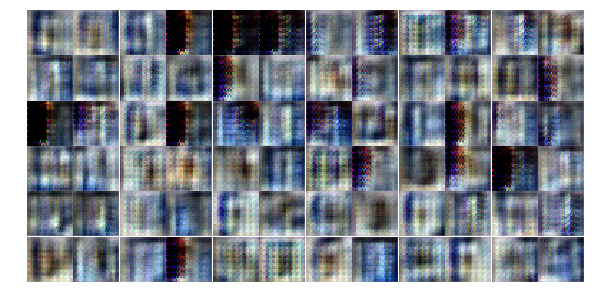

Epoch 3/25... Discriminator Loss: 1.0589... Generator Loss: 1.2433
Epoch 3/25... Discriminator Loss: 1.2334... Generator Loss: 1.5861
Epoch 3/25... Discriminator Loss: 1.0377... Generator Loss: 1.0620
Epoch 3/25... Discriminator Loss: 1.0726... Generator Loss: 1.1202
Epoch 3/25... Discriminator Loss: 0.9331... Generator Loss: 1.2755
Epoch 3/25... Discriminator Loss: 1.1332... Generator Loss: 1.5036
Epoch 3/25... Discriminator Loss: 1.0774... Generator Loss: 0.9806
Epoch 3/25... Discriminator Loss: 1.1436... Generator Loss: 1.4703
Epoch 3/25... Discriminator Loss: 1.1562... Generator Loss: 1.3413
Epoch 3/25... Discriminator Loss: 1.4407... Generator Loss: 2.1927


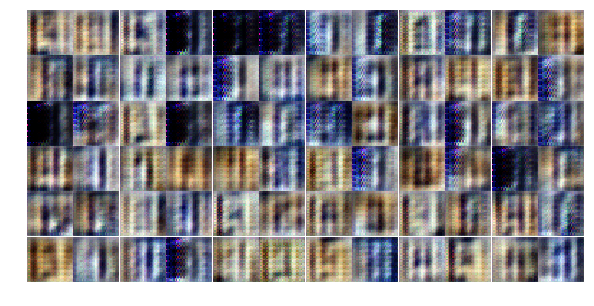

Epoch 3/25... Discriminator Loss: 1.2107... Generator Loss: 1.3975
Epoch 3/25... Discriminator Loss: 1.6739... Generator Loss: 0.9444
Epoch 3/25... Discriminator Loss: 1.1629... Generator Loss: 1.0948
Epoch 3/25... Discriminator Loss: 1.1701... Generator Loss: 0.9700
Epoch 3/25... Discriminator Loss: 1.3839... Generator Loss: 0.8619
Epoch 3/25... Discriminator Loss: 1.4150... Generator Loss: 2.0404
Epoch 3/25... Discriminator Loss: 1.1426... Generator Loss: 1.1351
Epoch 3/25... Discriminator Loss: 1.3395... Generator Loss: 0.7177
Epoch 3/25... Discriminator Loss: 1.3982... Generator Loss: 0.7670
Epoch 3/25... Discriminator Loss: 1.0576... Generator Loss: 1.0954


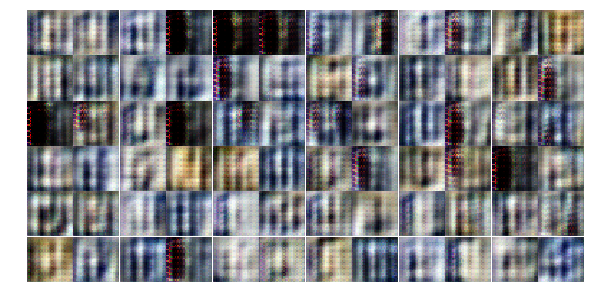

Epoch 3/25... Discriminator Loss: 1.0911... Generator Loss: 1.2257
Epoch 3/25... Discriminator Loss: 1.3252... Generator Loss: 1.1081
Epoch 3/25... Discriminator Loss: 1.2765... Generator Loss: 0.9802
Epoch 3/25... Discriminator Loss: 1.0571... Generator Loss: 1.2406
Epoch 3/25... Discriminator Loss: 1.2504... Generator Loss: 0.8256
Epoch 3/25... Discriminator Loss: 1.1430... Generator Loss: 0.8707
Epoch 3/25... Discriminator Loss: 1.1285... Generator Loss: 1.3791
Epoch 3/25... Discriminator Loss: 1.1809... Generator Loss: 0.7273
Epoch 3/25... Discriminator Loss: 1.2563... Generator Loss: 1.1252
Epoch 3/25... Discriminator Loss: 1.2008... Generator Loss: 0.6848


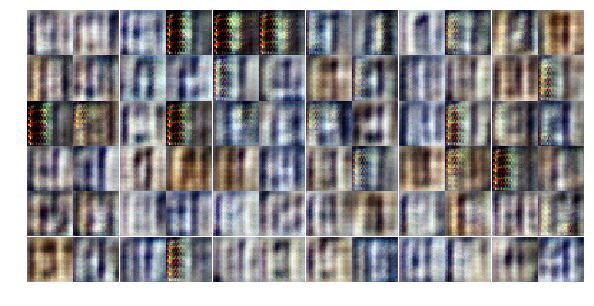

Epoch 3/25... Discriminator Loss: 1.1813... Generator Loss: 0.9744
Epoch 3/25... Discriminator Loss: 1.4062... Generator Loss: 1.2181
Epoch 3/25... Discriminator Loss: 1.5498... Generator Loss: 0.9084
Epoch 3/25... Discriminator Loss: 1.1838... Generator Loss: 1.1465
Epoch 3/25... Discriminator Loss: 1.1842... Generator Loss: 0.8135
Epoch 3/25... Discriminator Loss: 1.4512... Generator Loss: 0.5949
Epoch 3/25... Discriminator Loss: 1.1419... Generator Loss: 0.8419
Epoch 3/25... Discriminator Loss: 1.2406... Generator Loss: 0.8760
Epoch 3/25... Discriminator Loss: 1.2890... Generator Loss: 1.3165
Epoch 3/25... Discriminator Loss: 1.1354... Generator Loss: 0.9939


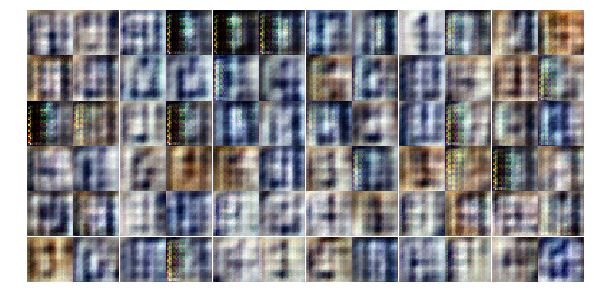

Epoch 3/25... Discriminator Loss: 1.3697... Generator Loss: 0.9921
Epoch 3/25... Discriminator Loss: 1.3640... Generator Loss: 0.5731
Epoch 3/25... Discriminator Loss: 0.7668... Generator Loss: 3.4845
Epoch 3/25... Discriminator Loss: 1.1610... Generator Loss: 1.0813
Epoch 3/25... Discriminator Loss: 1.4044... Generator Loss: 2.6366
Epoch 3/25... Discriminator Loss: 1.2716... Generator Loss: 0.8743
Epoch 3/25... Discriminator Loss: 1.1612... Generator Loss: 1.0626
Epoch 3/25... Discriminator Loss: 1.3341... Generator Loss: 1.2695
Epoch 3/25... Discriminator Loss: 1.4064... Generator Loss: 0.9180
Epoch 3/25... Discriminator Loss: 1.1287... Generator Loss: 1.1201


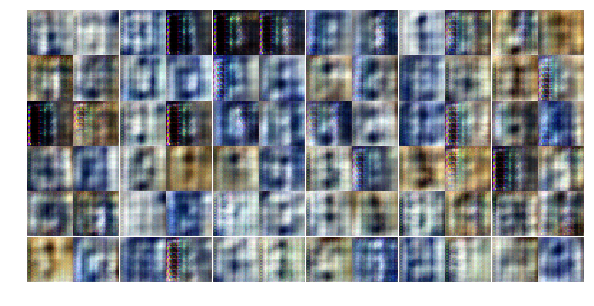

Epoch 3/25... Discriminator Loss: 1.3422... Generator Loss: 0.5885
Epoch 4/25... Discriminator Loss: 1.1174... Generator Loss: 0.6776
Epoch 4/25... Discriminator Loss: 0.9665... Generator Loss: 1.0610
Epoch 4/25... Discriminator Loss: 1.3515... Generator Loss: 0.6488
Epoch 4/25... Discriminator Loss: 0.9725... Generator Loss: 1.3208
Epoch 4/25... Discriminator Loss: 1.1059... Generator Loss: 1.1527
Epoch 4/25... Discriminator Loss: 1.3910... Generator Loss: 0.7011
Epoch 4/25... Discriminator Loss: 1.1888... Generator Loss: 1.1339
Epoch 4/25... Discriminator Loss: 1.2934... Generator Loss: 1.0599
Epoch 4/25... Discriminator Loss: 1.1648... Generator Loss: 0.8179


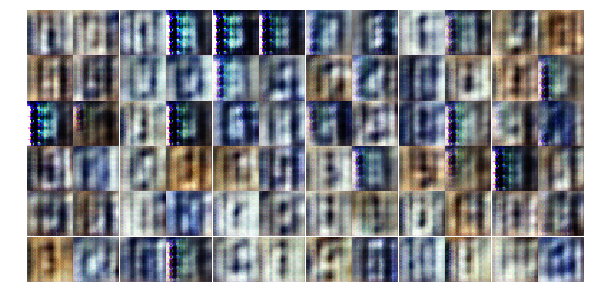

Epoch 4/25... Discriminator Loss: 1.2121... Generator Loss: 0.7701
Epoch 4/25... Discriminator Loss: 1.2742... Generator Loss: 0.7556
Epoch 4/25... Discriminator Loss: 1.1771... Generator Loss: 1.4729
Epoch 4/25... Discriminator Loss: 1.4069... Generator Loss: 1.4279
Epoch 4/25... Discriminator Loss: 1.2135... Generator Loss: 1.1111
Epoch 4/25... Discriminator Loss: 1.1639... Generator Loss: 0.8475
Epoch 4/25... Discriminator Loss: 1.3248... Generator Loss: 0.7278
Epoch 4/25... Discriminator Loss: 1.1775... Generator Loss: 1.0466
Epoch 4/25... Discriminator Loss: 1.0732... Generator Loss: 0.9883
Epoch 4/25... Discriminator Loss: 1.2481... Generator Loss: 0.9568


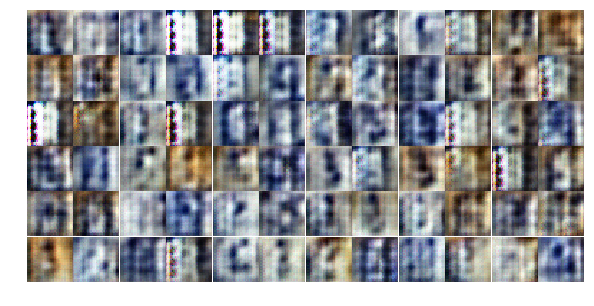

Epoch 4/25... Discriminator Loss: 1.3141... Generator Loss: 0.7240
Epoch 4/25... Discriminator Loss: 1.2601... Generator Loss: 0.7047
Epoch 4/25... Discriminator Loss: 1.2004... Generator Loss: 0.6844
Epoch 4/25... Discriminator Loss: 1.1260... Generator Loss: 0.9450
Epoch 4/25... Discriminator Loss: 1.1636... Generator Loss: 1.0699
Epoch 4/25... Discriminator Loss: 1.1915... Generator Loss: 1.5867
Epoch 4/25... Discriminator Loss: 1.1671... Generator Loss: 0.9668
Epoch 4/25... Discriminator Loss: 1.2559... Generator Loss: 0.8108
Epoch 4/25... Discriminator Loss: 1.1897... Generator Loss: 1.0049
Epoch 4/25... Discriminator Loss: 1.2504... Generator Loss: 0.9147


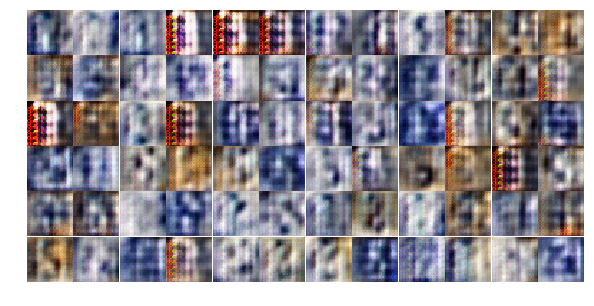

Epoch 4/25... Discriminator Loss: 1.2481... Generator Loss: 1.0650
Epoch 4/25... Discriminator Loss: 1.2192... Generator Loss: 0.9474
Epoch 4/25... Discriminator Loss: 1.3219... Generator Loss: 0.8015
Epoch 4/25... Discriminator Loss: 1.2502... Generator Loss: 0.9638
Epoch 4/25... Discriminator Loss: 1.2543... Generator Loss: 1.2674
Epoch 4/25... Discriminator Loss: 1.2796... Generator Loss: 1.5966
Epoch 4/25... Discriminator Loss: 1.4194... Generator Loss: 0.9006
Epoch 4/25... Discriminator Loss: 1.1732... Generator Loss: 0.9999
Epoch 4/25... Discriminator Loss: 1.2754... Generator Loss: 0.7043
Epoch 4/25... Discriminator Loss: 1.4517... Generator Loss: 0.5380


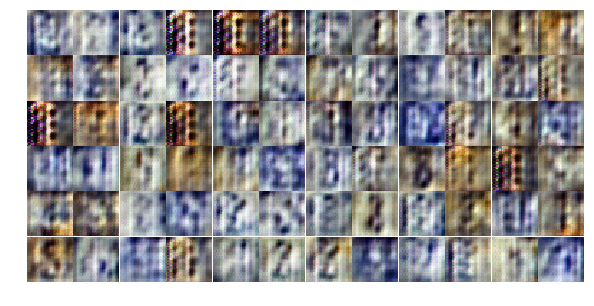

Epoch 4/25... Discriminator Loss: 1.2333... Generator Loss: 0.7765
Epoch 4/25... Discriminator Loss: 1.3646... Generator Loss: 0.9554
Epoch 4/25... Discriminator Loss: 1.2755... Generator Loss: 0.7983
Epoch 4/25... Discriminator Loss: 1.3198... Generator Loss: 0.7011
Epoch 4/25... Discriminator Loss: 1.2574... Generator Loss: 0.7605
Epoch 4/25... Discriminator Loss: 1.4965... Generator Loss: 0.6879
Epoch 4/25... Discriminator Loss: 1.3018... Generator Loss: 0.7674
Epoch 4/25... Discriminator Loss: 1.2473... Generator Loss: 1.0350
Epoch 4/25... Discriminator Loss: 1.3043... Generator Loss: 0.8972
Epoch 4/25... Discriminator Loss: 1.2898... Generator Loss: 0.7128


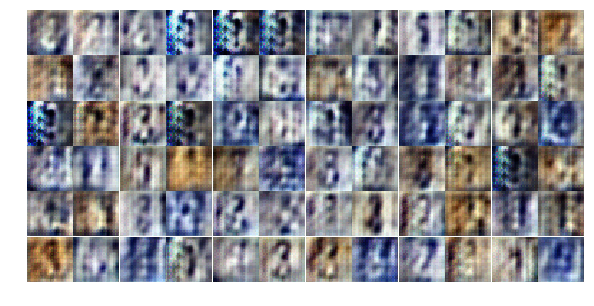

Epoch 4/25... Discriminator Loss: 1.2162... Generator Loss: 0.8679
Epoch 4/25... Discriminator Loss: 1.2092... Generator Loss: 1.1385
Epoch 4/25... Discriminator Loss: 1.3215... Generator Loss: 0.8243
Epoch 4/25... Discriminator Loss: 1.2710... Generator Loss: 1.0379
Epoch 4/25... Discriminator Loss: 1.4340... Generator Loss: 0.7178
Epoch 4/25... Discriminator Loss: 1.2383... Generator Loss: 1.2760
Epoch 4/25... Discriminator Loss: 1.4079... Generator Loss: 0.5232
Epoch 4/25... Discriminator Loss: 1.3074... Generator Loss: 0.7909
Epoch 4/25... Discriminator Loss: 1.3514... Generator Loss: 0.9540
Epoch 5/25... Discriminator Loss: 1.3042... Generator Loss: 0.7224


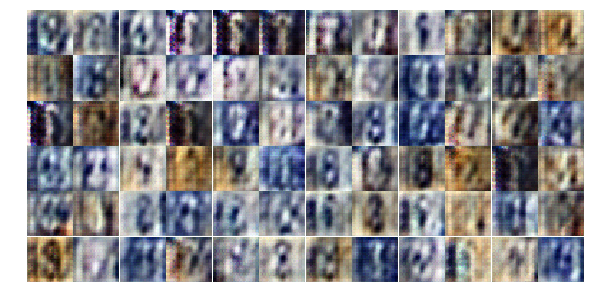

Epoch 5/25... Discriminator Loss: 1.3685... Generator Loss: 0.7392
Epoch 5/25... Discriminator Loss: 1.5215... Generator Loss: 0.6477
Epoch 5/25... Discriminator Loss: 1.4530... Generator Loss: 0.7794
Epoch 5/25... Discriminator Loss: 1.2329... Generator Loss: 0.9355
Epoch 5/25... Discriminator Loss: 1.2769... Generator Loss: 0.7809
Epoch 5/25... Discriminator Loss: 1.3804... Generator Loss: 0.6609
Epoch 5/25... Discriminator Loss: 1.4096... Generator Loss: 0.7384
Epoch 5/25... Discriminator Loss: 1.3097... Generator Loss: 0.8497
Epoch 5/25... Discriminator Loss: 1.3986... Generator Loss: 0.8146
Epoch 5/25... Discriminator Loss: 1.4737... Generator Loss: 0.6353


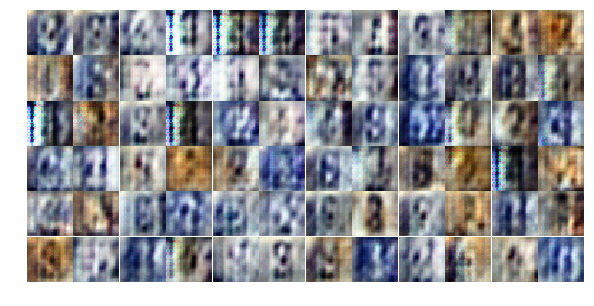

Epoch 5/25... Discriminator Loss: 1.3420... Generator Loss: 0.6588
Epoch 5/25... Discriminator Loss: 1.2105... Generator Loss: 0.8646
Epoch 5/25... Discriminator Loss: 1.3738... Generator Loss: 0.8618
Epoch 5/25... Discriminator Loss: 1.2304... Generator Loss: 0.8114
Epoch 5/25... Discriminator Loss: 1.2791... Generator Loss: 0.7992
Epoch 5/25... Discriminator Loss: 1.3670... Generator Loss: 0.8230
Epoch 5/25... Discriminator Loss: 1.2896... Generator Loss: 0.8571
Epoch 5/25... Discriminator Loss: 1.3078... Generator Loss: 1.0624
Epoch 5/25... Discriminator Loss: 1.2873... Generator Loss: 0.8467
Epoch 5/25... Discriminator Loss: 1.3383... Generator Loss: 0.8391


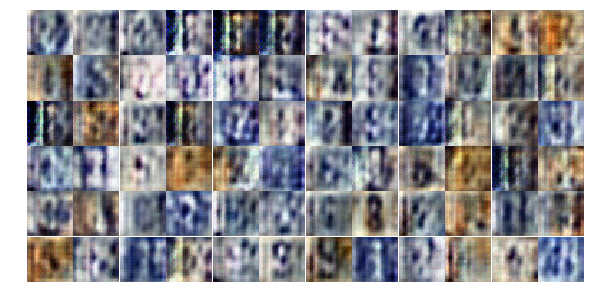

Epoch 5/25... Discriminator Loss: 1.2743... Generator Loss: 0.8689
Epoch 5/25... Discriminator Loss: 1.3279... Generator Loss: 0.7591
Epoch 5/25... Discriminator Loss: 1.3261... Generator Loss: 0.6909
Epoch 5/25... Discriminator Loss: 1.3991... Generator Loss: 0.8391
Epoch 5/25... Discriminator Loss: 1.2524... Generator Loss: 0.7640
Epoch 5/25... Discriminator Loss: 1.3690... Generator Loss: 0.9419
Epoch 5/25... Discriminator Loss: 1.2493... Generator Loss: 0.7122
Epoch 5/25... Discriminator Loss: 1.1614... Generator Loss: 0.9870
Epoch 5/25... Discriminator Loss: 1.2145... Generator Loss: 0.7119
Epoch 5/25... Discriminator Loss: 1.3030... Generator Loss: 0.8437


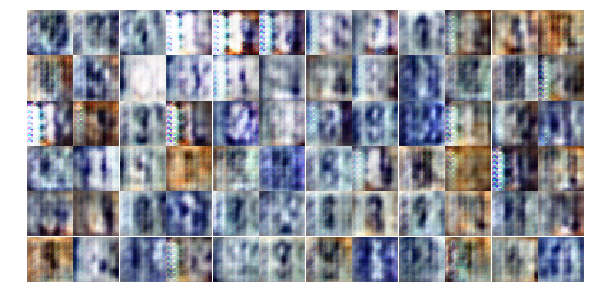

Epoch 5/25... Discriminator Loss: 1.2307... Generator Loss: 0.9340
Epoch 5/25... Discriminator Loss: 1.2328... Generator Loss: 0.8269
Epoch 5/25... Discriminator Loss: 1.2331... Generator Loss: 0.8354
Epoch 5/25... Discriminator Loss: 1.3084... Generator Loss: 0.6920
Epoch 5/25... Discriminator Loss: 1.2540... Generator Loss: 0.8137
Epoch 5/25... Discriminator Loss: 1.3458... Generator Loss: 0.7030
Epoch 5/25... Discriminator Loss: 1.3376... Generator Loss: 0.8037
Epoch 5/25... Discriminator Loss: 1.2697... Generator Loss: 0.7865
Epoch 5/25... Discriminator Loss: 1.2889... Generator Loss: 0.7839
Epoch 5/25... Discriminator Loss: 1.3211... Generator Loss: 0.7916


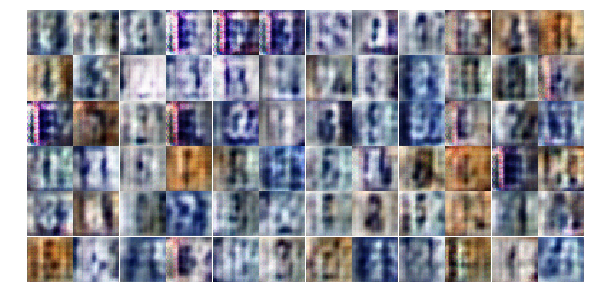

Epoch 5/25... Discriminator Loss: 1.2172... Generator Loss: 0.9146
Epoch 5/25... Discriminator Loss: 1.4254... Generator Loss: 0.8207
Epoch 5/25... Discriminator Loss: 1.3284... Generator Loss: 0.6938
Epoch 5/25... Discriminator Loss: 1.2898... Generator Loss: 0.7491
Epoch 5/25... Discriminator Loss: 1.3377... Generator Loss: 0.7166
Epoch 5/25... Discriminator Loss: 1.3768... Generator Loss: 0.7309
Epoch 5/25... Discriminator Loss: 1.3430... Generator Loss: 0.7085
Epoch 5/25... Discriminator Loss: 1.3450... Generator Loss: 0.6644
Epoch 5/25... Discriminator Loss: 1.3186... Generator Loss: 0.7330
Epoch 5/25... Discriminator Loss: 1.5227... Generator Loss: 0.9777


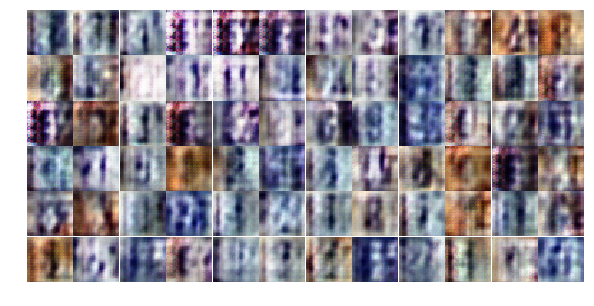

Epoch 5/25... Discriminator Loss: 1.2799... Generator Loss: 0.7756
Epoch 5/25... Discriminator Loss: 1.2565... Generator Loss: 0.8256
Epoch 5/25... Discriminator Loss: 1.2430... Generator Loss: 0.8455
Epoch 5/25... Discriminator Loss: 1.3560... Generator Loss: 0.7227
Epoch 5/25... Discriminator Loss: 1.3231... Generator Loss: 0.7284
Epoch 5/25... Discriminator Loss: 1.2986... Generator Loss: 0.6975
Epoch 6/25... Discriminator Loss: 1.2455... Generator Loss: 0.8206
Epoch 6/25... Discriminator Loss: 1.3731... Generator Loss: 0.6677
Epoch 6/25... Discriminator Loss: 1.2255... Generator Loss: 0.9378
Epoch 6/25... Discriminator Loss: 1.3124... Generator Loss: 0.7130


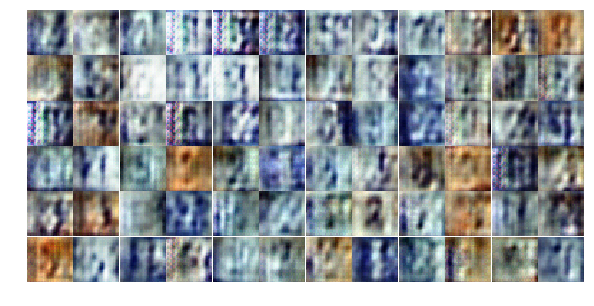

Epoch 6/25... Discriminator Loss: 1.2206... Generator Loss: 0.7912
Epoch 6/25... Discriminator Loss: 1.2932... Generator Loss: 0.7543
Epoch 6/25... Discriminator Loss: 1.2637... Generator Loss: 0.7017
Epoch 6/25... Discriminator Loss: 1.2349... Generator Loss: 1.0981
Epoch 6/25... Discriminator Loss: 1.2145... Generator Loss: 0.8249
Epoch 6/25... Discriminator Loss: 1.2283... Generator Loss: 0.8612
Epoch 6/25... Discriminator Loss: 1.2430... Generator Loss: 0.8726
Epoch 6/25... Discriminator Loss: 1.3295... Generator Loss: 0.8328
Epoch 6/25... Discriminator Loss: 1.2532... Generator Loss: 0.6182
Epoch 6/25... Discriminator Loss: 1.5207... Generator Loss: 0.4944


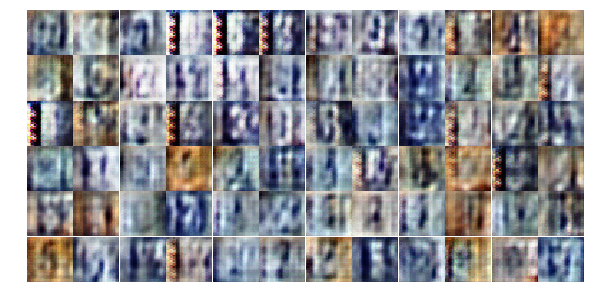

Epoch 6/25... Discriminator Loss: 1.1775... Generator Loss: 0.7952
Epoch 6/25... Discriminator Loss: 1.3183... Generator Loss: 0.8712
Epoch 6/25... Discriminator Loss: 1.3579... Generator Loss: 0.6238
Epoch 6/25... Discriminator Loss: 1.3513... Generator Loss: 0.8063
Epoch 6/25... Discriminator Loss: 1.2939... Generator Loss: 0.7068
Epoch 6/25... Discriminator Loss: 1.2909... Generator Loss: 1.0147
Epoch 6/25... Discriminator Loss: 1.3040... Generator Loss: 1.2475
Epoch 6/25... Discriminator Loss: 1.3063... Generator Loss: 0.6982
Epoch 6/25... Discriminator Loss: 1.3596... Generator Loss: 0.7400
Epoch 6/25... Discriminator Loss: 1.2910... Generator Loss: 0.7813


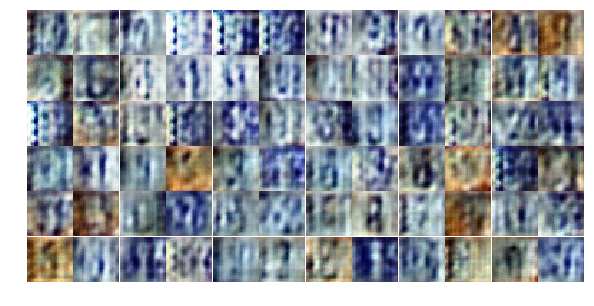

Epoch 6/25... Discriminator Loss: 1.2917... Generator Loss: 0.8817
Epoch 6/25... Discriminator Loss: 1.3092... Generator Loss: 0.8060
Epoch 6/25... Discriminator Loss: 1.3081... Generator Loss: 0.8904
Epoch 6/25... Discriminator Loss: 1.3985... Generator Loss: 0.7210
Epoch 6/25... Discriminator Loss: 1.3177... Generator Loss: 0.8785
Epoch 6/25... Discriminator Loss: 1.5218... Generator Loss: 0.6748
Epoch 6/25... Discriminator Loss: 1.3563... Generator Loss: 0.6931
Epoch 6/25... Discriminator Loss: 1.2978... Generator Loss: 0.7262
Epoch 6/25... Discriminator Loss: 1.3453... Generator Loss: 0.7441
Epoch 6/25... Discriminator Loss: 1.2361... Generator Loss: 0.8685


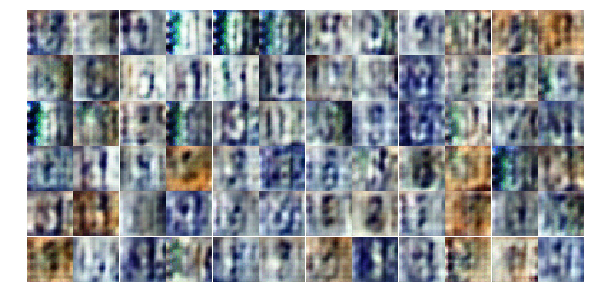

Epoch 6/25... Discriminator Loss: 1.2942... Generator Loss: 0.8748
Epoch 6/25... Discriminator Loss: 1.4470... Generator Loss: 0.6469
Epoch 6/25... Discriminator Loss: 1.2719... Generator Loss: 0.7749
Epoch 6/25... Discriminator Loss: 1.3529... Generator Loss: 0.7803
Epoch 6/25... Discriminator Loss: 1.3534... Generator Loss: 0.7175
Epoch 6/25... Discriminator Loss: 1.4118... Generator Loss: 0.6121
Epoch 6/25... Discriminator Loss: 1.3062... Generator Loss: 0.7786
Epoch 6/25... Discriminator Loss: 1.2711... Generator Loss: 0.6836
Epoch 6/25... Discriminator Loss: 1.3701... Generator Loss: 0.8328
Epoch 6/25... Discriminator Loss: 1.0736... Generator Loss: 0.9894


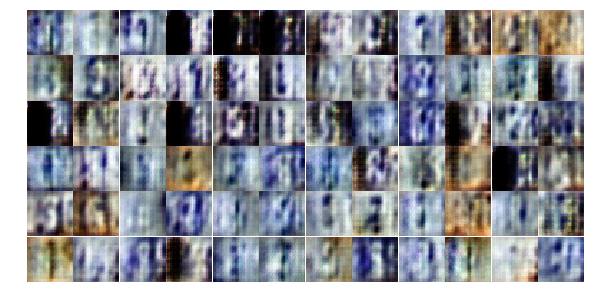

Epoch 6/25... Discriminator Loss: 1.2557... Generator Loss: 0.7304
Epoch 6/25... Discriminator Loss: 1.2578... Generator Loss: 0.9951
Epoch 6/25... Discriminator Loss: 1.2622... Generator Loss: 0.9284
Epoch 6/25... Discriminator Loss: 1.2991... Generator Loss: 0.8088
Epoch 6/25... Discriminator Loss: 1.2555... Generator Loss: 0.8730
Epoch 6/25... Discriminator Loss: 1.2412... Generator Loss: 0.7481
Epoch 6/25... Discriminator Loss: 1.2926... Generator Loss: 0.8597
Epoch 6/25... Discriminator Loss: 1.3392... Generator Loss: 0.6648
Epoch 6/25... Discriminator Loss: 1.3194... Generator Loss: 0.7428
Epoch 6/25... Discriminator Loss: 1.2777... Generator Loss: 0.8088


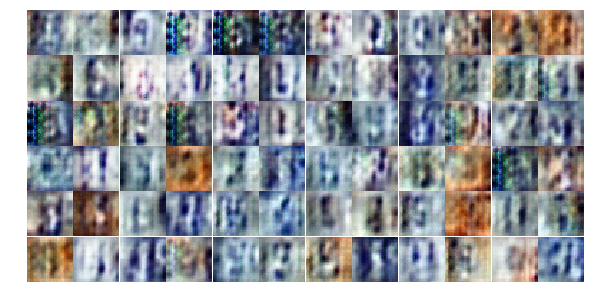

Epoch 6/25... Discriminator Loss: 1.2130... Generator Loss: 0.8387
Epoch 6/25... Discriminator Loss: 1.3497... Generator Loss: 0.6441
Epoch 6/25... Discriminator Loss: 1.2641... Generator Loss: 0.9098
Epoch 7/25... Discriminator Loss: 1.2798... Generator Loss: 0.7306
Epoch 7/25... Discriminator Loss: 1.2340... Generator Loss: 0.8501
Epoch 7/25... Discriminator Loss: 1.2444... Generator Loss: 0.7954
Epoch 7/25... Discriminator Loss: 1.3767... Generator Loss: 0.7210
Epoch 7/25... Discriminator Loss: 1.3489... Generator Loss: 0.7295
Epoch 7/25... Discriminator Loss: 1.3657... Generator Loss: 0.9977
Epoch 7/25... Discriminator Loss: 1.3057... Generator Loss: 0.6824


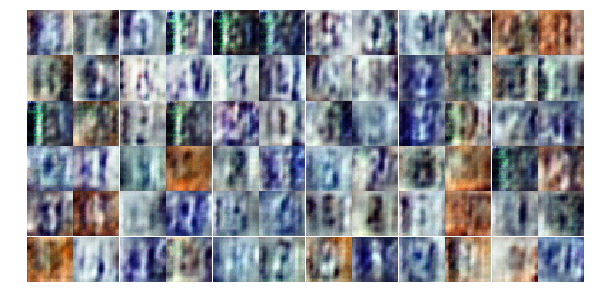

Epoch 7/25... Discriminator Loss: 1.4809... Generator Loss: 1.3112
Epoch 7/25... Discriminator Loss: 1.3442... Generator Loss: 0.7314
Epoch 7/25... Discriminator Loss: 1.3347... Generator Loss: 0.8320
Epoch 7/25... Discriminator Loss: 1.3764... Generator Loss: 0.6952
Epoch 7/25... Discriminator Loss: 1.2799... Generator Loss: 0.9357
Epoch 7/25... Discriminator Loss: 1.2230... Generator Loss: 0.8966
Epoch 7/25... Discriminator Loss: 1.3062... Generator Loss: 0.8080
Epoch 7/25... Discriminator Loss: 0.9852... Generator Loss: 1.4849
Epoch 7/25... Discriminator Loss: 1.3194... Generator Loss: 0.6667
Epoch 7/25... Discriminator Loss: 1.2228... Generator Loss: 0.8165


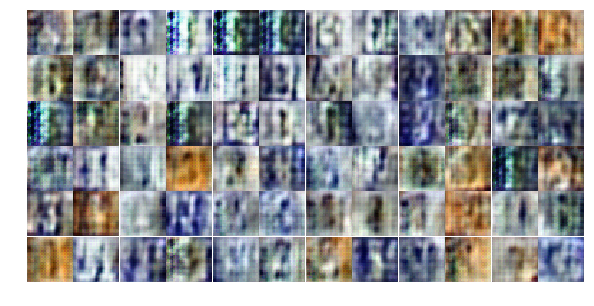

Epoch 7/25... Discriminator Loss: 1.4146... Generator Loss: 0.7020
Epoch 7/25... Discriminator Loss: 1.3042... Generator Loss: 0.7022
Epoch 7/25... Discriminator Loss: 1.2204... Generator Loss: 0.8431
Epoch 7/25... Discriminator Loss: 1.2359... Generator Loss: 0.9293
Epoch 7/25... Discriminator Loss: 1.3838... Generator Loss: 0.9600
Epoch 7/25... Discriminator Loss: 1.3551... Generator Loss: 0.8370
Epoch 7/25... Discriminator Loss: 1.3113... Generator Loss: 0.7619
Epoch 7/25... Discriminator Loss: 1.5692... Generator Loss: 0.4544
Epoch 7/25... Discriminator Loss: 1.3517... Generator Loss: 0.8805
Epoch 7/25... Discriminator Loss: 1.3446... Generator Loss: 0.9316


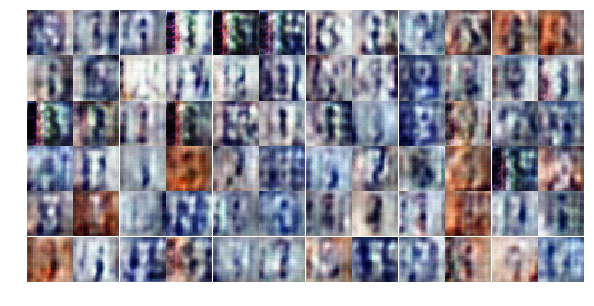

Epoch 7/25... Discriminator Loss: 1.2759... Generator Loss: 0.7727
Epoch 7/25... Discriminator Loss: 1.3078... Generator Loss: 0.7563
Epoch 7/25... Discriminator Loss: 1.3220... Generator Loss: 0.9103
Epoch 7/25... Discriminator Loss: 1.2675... Generator Loss: 0.7808
Epoch 7/25... Discriminator Loss: 1.2241... Generator Loss: 1.0343
Epoch 7/25... Discriminator Loss: 1.2896... Generator Loss: 0.7469
Epoch 7/25... Discriminator Loss: 1.3056... Generator Loss: 0.8770
Epoch 7/25... Discriminator Loss: 1.2224... Generator Loss: 0.8108
Epoch 7/25... Discriminator Loss: 1.3805... Generator Loss: 0.8923
Epoch 7/25... Discriminator Loss: 1.2504... Generator Loss: 0.7167


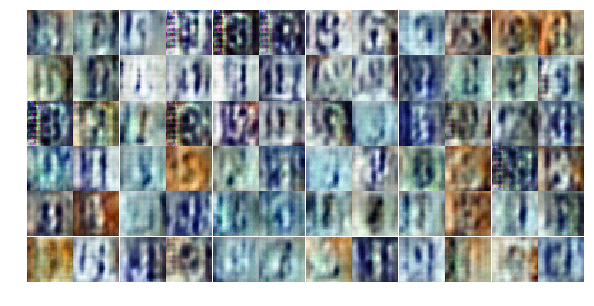

Epoch 7/25... Discriminator Loss: 1.4463... Generator Loss: 0.8858
Epoch 7/25... Discriminator Loss: 1.2421... Generator Loss: 0.7659
Epoch 7/25... Discriminator Loss: 1.3421... Generator Loss: 0.6361
Epoch 7/25... Discriminator Loss: 1.4481... Generator Loss: 0.9105
Epoch 7/25... Discriminator Loss: 1.3126... Generator Loss: 0.8203
Epoch 7/25... Discriminator Loss: 1.3113... Generator Loss: 0.7530
Epoch 7/25... Discriminator Loss: 1.3050... Generator Loss: 0.7624
Epoch 7/25... Discriminator Loss: 1.3334... Generator Loss: 0.7660
Epoch 7/25... Discriminator Loss: 1.1769... Generator Loss: 0.9748
Epoch 7/25... Discriminator Loss: 1.4142... Generator Loss: 1.0215


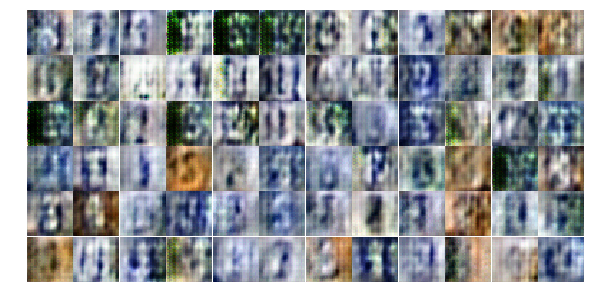

Epoch 7/25... Discriminator Loss: 1.3175... Generator Loss: 0.7514
Epoch 7/25... Discriminator Loss: 1.3081... Generator Loss: 0.7557
Epoch 7/25... Discriminator Loss: 1.3156... Generator Loss: 0.8629
Epoch 7/25... Discriminator Loss: 1.2266... Generator Loss: 0.8687
Epoch 7/25... Discriminator Loss: 1.2660... Generator Loss: 0.7656
Epoch 7/25... Discriminator Loss: 1.2831... Generator Loss: 0.7351
Epoch 7/25... Discriminator Loss: 1.3298... Generator Loss: 0.7521
Epoch 7/25... Discriminator Loss: 1.1580... Generator Loss: 1.1751
Epoch 7/25... Discriminator Loss: 1.2941... Generator Loss: 0.7527
Epoch 7/25... Discriminator Loss: 1.3835... Generator Loss: 0.6518


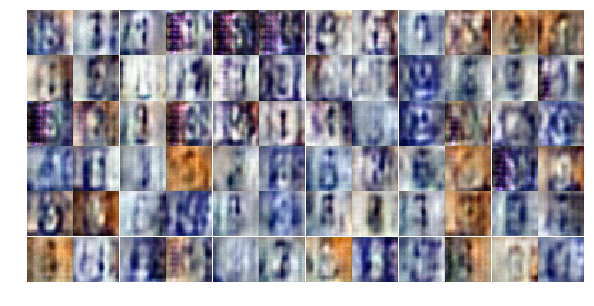

Epoch 7/25... Discriminator Loss: 1.2339... Generator Loss: 0.7908
Epoch 8/25... Discriminator Loss: 1.3042... Generator Loss: 0.8218
Epoch 8/25... Discriminator Loss: 1.2823... Generator Loss: 0.7088
Epoch 8/25... Discriminator Loss: 1.3328... Generator Loss: 0.9934
Epoch 8/25... Discriminator Loss: 1.2052... Generator Loss: 0.7349
Epoch 8/25... Discriminator Loss: 1.3022... Generator Loss: 0.7922
Epoch 8/25... Discriminator Loss: 1.3209... Generator Loss: 0.8093
Epoch 8/25... Discriminator Loss: 1.2739... Generator Loss: 0.7448
Epoch 8/25... Discriminator Loss: 1.2815... Generator Loss: 0.7704
Epoch 8/25... Discriminator Loss: 1.2745... Generator Loss: 0.7472


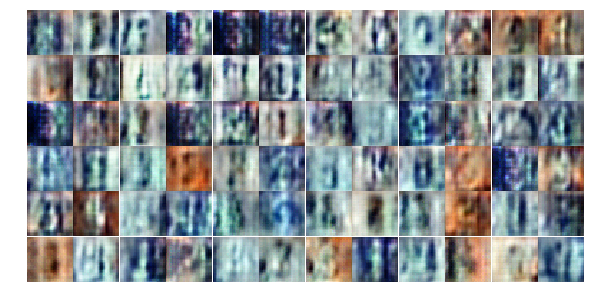

Epoch 8/25... Discriminator Loss: 1.2063... Generator Loss: 0.9822
Epoch 8/25... Discriminator Loss: 1.4378... Generator Loss: 1.2779
Epoch 8/25... Discriminator Loss: 1.3418... Generator Loss: 0.6639
Epoch 8/25... Discriminator Loss: 1.2732... Generator Loss: 0.7843
Epoch 8/25... Discriminator Loss: 1.2288... Generator Loss: 1.3439
Epoch 8/25... Discriminator Loss: 1.2412... Generator Loss: 0.7295
Epoch 8/25... Discriminator Loss: 1.6652... Generator Loss: 1.3921
Epoch 8/25... Discriminator Loss: 1.2379... Generator Loss: 1.2425
Epoch 8/25... Discriminator Loss: 1.1884... Generator Loss: 0.8918
Epoch 8/25... Discriminator Loss: 303.1475... Generator Loss: 1.5902


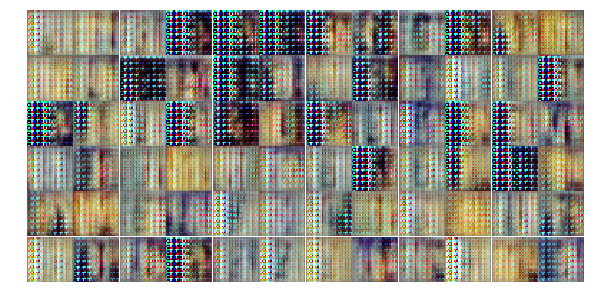

Epoch 8/25... Discriminator Loss: 940.4131... Generator Loss: 6.7583
Epoch 8/25... Discriminator Loss: 365.9232... Generator Loss: 745.4342
Epoch 8/25... Discriminator Loss: 0.9886... Generator Loss: 75.6306
Epoch 8/25... Discriminator Loss: 1.8487... Generator Loss: 49.1487
Epoch 8/25... Discriminator Loss: 2.0530... Generator Loss: 40.9761
Epoch 8/25... Discriminator Loss: 0.9523... Generator Loss: 37.5926
Epoch 8/25... Discriminator Loss: 1.5306... Generator Loss: 44.8192
Epoch 8/25... Discriminator Loss: 0.5609... Generator Loss: 19.8317
Epoch 8/25... Discriminator Loss: 1.8070... Generator Loss: 19.0185
Epoch 8/25... Discriminator Loss: 0.9356... Generator Loss: 18.6605


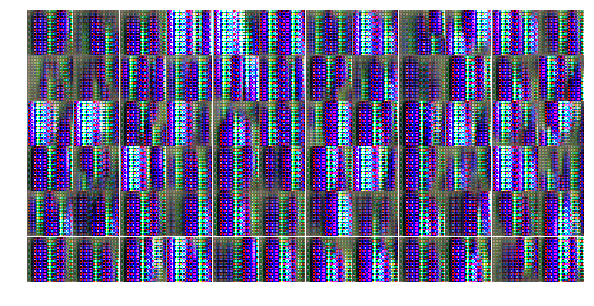

Epoch 8/25... Discriminator Loss: 0.9607... Generator Loss: 22.0256
Epoch 8/25... Discriminator Loss: 1.0015... Generator Loss: 16.4125
Epoch 8/25... Discriminator Loss: 0.5357... Generator Loss: 13.7397
Epoch 8/25... Discriminator Loss: 0.5991... Generator Loss: 9.2066
Epoch 8/25... Discriminator Loss: 2.1838... Generator Loss: 16.9531
Epoch 8/25... Discriminator Loss: 0.4167... Generator Loss: 10.4685
Epoch 8/25... Discriminator Loss: 0.2952... Generator Loss: 12.4405
Epoch 8/25... Discriminator Loss: 0.2943... Generator Loss: 10.1716
Epoch 8/25... Discriminator Loss: 0.1907... Generator Loss: 9.2602
Epoch 8/25... Discriminator Loss: 0.0567... Generator Loss: 9.3824


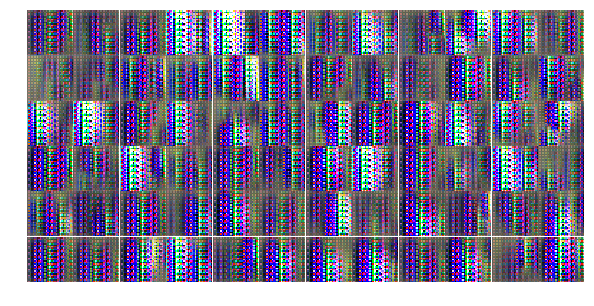

Epoch 8/25... Discriminator Loss: 0.1117... Generator Loss: 8.7760
Epoch 8/25... Discriminator Loss: 0.2206... Generator Loss: 9.2030
Epoch 8/25... Discriminator Loss: 0.2116... Generator Loss: 10.6557
Epoch 8/25... Discriminator Loss: 0.1005... Generator Loss: 9.5016
Epoch 8/25... Discriminator Loss: 0.1808... Generator Loss: 10.0327
Epoch 8/25... Discriminator Loss: 0.4170... Generator Loss: 9.3161
Epoch 8/25... Discriminator Loss: 0.0452... Generator Loss: 10.0589
Epoch 8/25... Discriminator Loss: 0.2020... Generator Loss: 10.0218
Epoch 8/25... Discriminator Loss: 0.1479... Generator Loss: 9.0169
Epoch 8/25... Discriminator Loss: 0.0680... Generator Loss: 9.2911


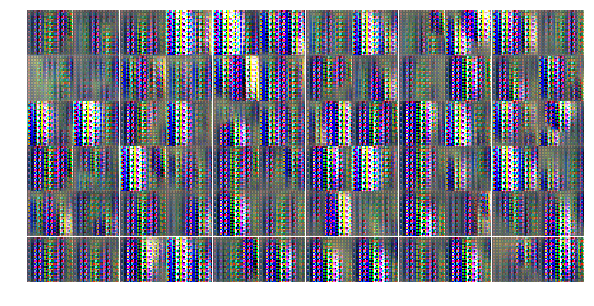

Epoch 8/25... Discriminator Loss: 0.1792... Generator Loss: 9.0151
Epoch 8/25... Discriminator Loss: 0.1937... Generator Loss: 8.9035
Epoch 8/25... Discriminator Loss: 0.6245... Generator Loss: 10.0513
Epoch 8/25... Discriminator Loss: 0.5235... Generator Loss: 9.4567
Epoch 8/25... Discriminator Loss: 3.0518... Generator Loss: 16.2363
Epoch 8/25... Discriminator Loss: 0.0989... Generator Loss: 8.5800
Epoch 8/25... Discriminator Loss: 0.0874... Generator Loss: 10.7201
Epoch 8/25... Discriminator Loss: 0.3515... Generator Loss: 9.5633
Epoch 9/25... Discriminator Loss: 0.2150... Generator Loss: 11.0612
Epoch 9/25... Discriminator Loss: 0.2072... Generator Loss: 9.2140


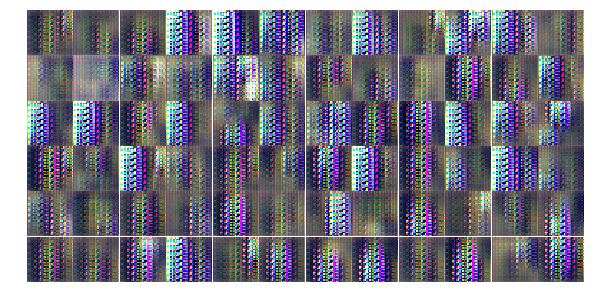

Epoch 9/25... Discriminator Loss: 0.2702... Generator Loss: 7.9828
Epoch 9/25... Discriminator Loss: 0.2759... Generator Loss: 10.0547
Epoch 9/25... Discriminator Loss: 0.1233... Generator Loss: 7.1107
Epoch 9/25... Discriminator Loss: 0.2043... Generator Loss: 6.7683
Epoch 9/25... Discriminator Loss: 0.2059... Generator Loss: 8.8453
Epoch 9/25... Discriminator Loss: 1.2738... Generator Loss: 3.2185
Epoch 9/25... Discriminator Loss: 0.5841... Generator Loss: 4.3399
Epoch 9/25... Discriminator Loss: 2.2571... Generator Loss: 12.3588
Epoch 9/25... Discriminator Loss: 0.2360... Generator Loss: 5.8806
Epoch 9/25... Discriminator Loss: 1.7124... Generator Loss: 12.9051


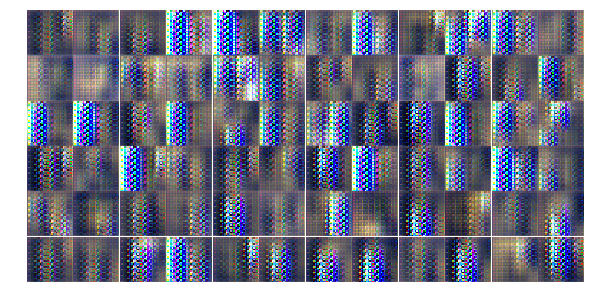

Epoch 9/25... Discriminator Loss: 0.5250... Generator Loss: 4.9106
Epoch 9/25... Discriminator Loss: 0.9673... Generator Loss: 3.5874
Epoch 9/25... Discriminator Loss: 1.6076... Generator Loss: 2.2757
Epoch 9/25... Discriminator Loss: 0.1626... Generator Loss: 5.5461
Epoch 9/25... Discriminator Loss: 0.2885... Generator Loss: 4.6149
Epoch 9/25... Discriminator Loss: 0.2130... Generator Loss: 6.1123
Epoch 9/25... Discriminator Loss: 0.6016... Generator Loss: 5.5607
Epoch 9/25... Discriminator Loss: 0.1590... Generator Loss: 4.4557
Epoch 9/25... Discriminator Loss: 0.5316... Generator Loss: 7.0175
Epoch 9/25... Discriminator Loss: 0.3256... Generator Loss: 4.8856


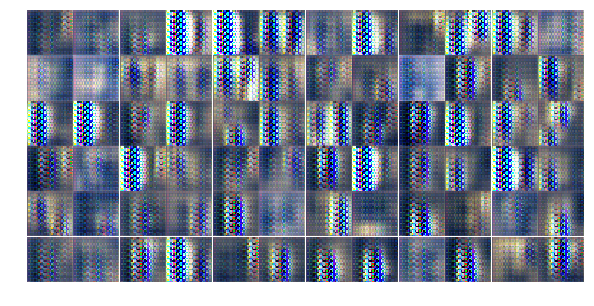

Epoch 9/25... Discriminator Loss: 0.1806... Generator Loss: 6.1737
Epoch 9/25... Discriminator Loss: 1.1371... Generator Loss: 7.3506
Epoch 9/25... Discriminator Loss: 0.4141... Generator Loss: 3.8172
Epoch 9/25... Discriminator Loss: 0.6567... Generator Loss: 4.5670
Epoch 9/25... Discriminator Loss: 0.4604... Generator Loss: 2.9206
Epoch 9/25... Discriminator Loss: 0.7110... Generator Loss: 5.8308
Epoch 9/25... Discriminator Loss: 0.3780... Generator Loss: 3.5145
Epoch 9/25... Discriminator Loss: 0.8011... Generator Loss: 7.1748
Epoch 9/25... Discriminator Loss: 0.6962... Generator Loss: 3.3428
Epoch 9/25... Discriminator Loss: 0.6324... Generator Loss: 2.7273


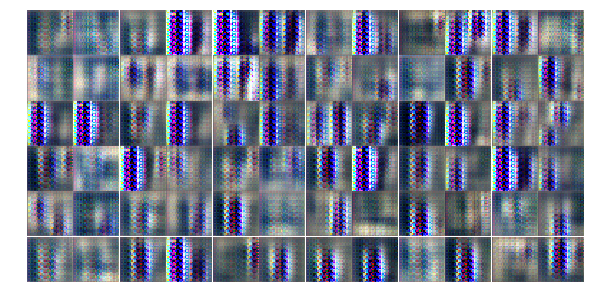

Epoch 9/25... Discriminator Loss: 0.3393... Generator Loss: 2.6738
Epoch 9/25... Discriminator Loss: 1.8301... Generator Loss: 7.7719
Epoch 9/25... Discriminator Loss: 0.9623... Generator Loss: 6.0488
Epoch 9/25... Discriminator Loss: 1.4168... Generator Loss: 0.9106
Epoch 9/25... Discriminator Loss: 1.5975... Generator Loss: 2.1614
Epoch 9/25... Discriminator Loss: 0.5660... Generator Loss: 2.3217
Epoch 9/25... Discriminator Loss: 0.7276... Generator Loss: 2.2444
Epoch 9/25... Discriminator Loss: 1.0164... Generator Loss: 1.8304
Epoch 9/25... Discriminator Loss: 2.6238... Generator Loss: 7.0121
Epoch 9/25... Discriminator Loss: 0.8097... Generator Loss: 1.1122


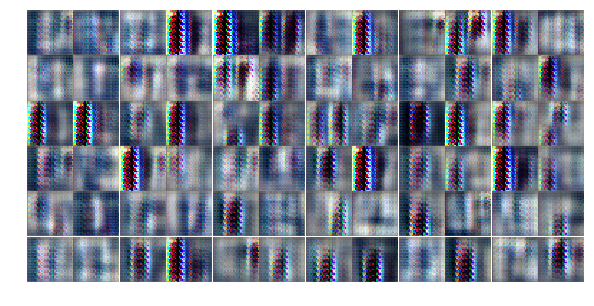

Epoch 9/25... Discriminator Loss: 0.6704... Generator Loss: 2.0142
Epoch 9/25... Discriminator Loss: 2.2326... Generator Loss: 5.8260
Epoch 9/25... Discriminator Loss: 0.6282... Generator Loss: 3.2504
Epoch 9/25... Discriminator Loss: 1.9432... Generator Loss: 1.7497
Epoch 9/25... Discriminator Loss: 4.4381... Generator Loss: 0.4779
Epoch 9/25... Discriminator Loss: 2.0599... Generator Loss: 5.6651
Epoch 9/25... Discriminator Loss: 0.8940... Generator Loss: 2.9166
Epoch 9/25... Discriminator Loss: 1.1182... Generator Loss: 3.1587
Epoch 9/25... Discriminator Loss: 0.5438... Generator Loss: 5.0121
Epoch 9/25... Discriminator Loss: 2.6133... Generator Loss: 6.0976


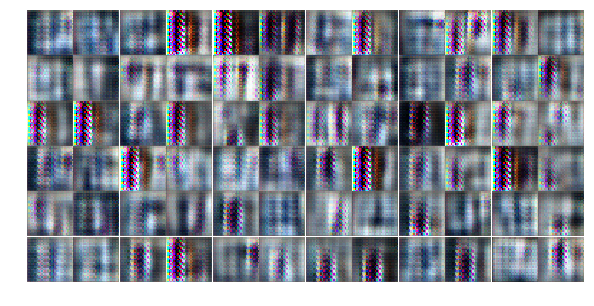

Epoch 9/25... Discriminator Loss: 1.4075... Generator Loss: 3.5444
Epoch 9/25... Discriminator Loss: 0.7543... Generator Loss: 1.5860
Epoch 9/25... Discriminator Loss: 0.2012... Generator Loss: 5.8243
Epoch 9/25... Discriminator Loss: 1.8961... Generator Loss: 5.7850
Epoch 9/25... Discriminator Loss: 1.4724... Generator Loss: 4.6433
Epoch 10/25... Discriminator Loss: 0.6244... Generator Loss: 1.7751
Epoch 10/25... Discriminator Loss: 0.5763... Generator Loss: 2.0170
Epoch 10/25... Discriminator Loss: 0.5122... Generator Loss: 5.0880
Epoch 10/25... Discriminator Loss: 0.7874... Generator Loss: 2.6190
Epoch 10/25... Discriminator Loss: 1.2141... Generator Loss: 2.5969


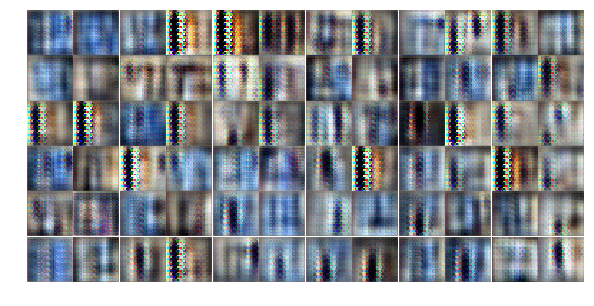

Epoch 10/25... Discriminator Loss: 1.0009... Generator Loss: 1.4885
Epoch 10/25... Discriminator Loss: 0.7143... Generator Loss: 2.7508
Epoch 10/25... Discriminator Loss: 0.9196... Generator Loss: 2.0437
Epoch 10/25... Discriminator Loss: 0.6652... Generator Loss: 2.6844
Epoch 10/25... Discriminator Loss: 0.9665... Generator Loss: 1.1828
Epoch 10/25... Discriminator Loss: 0.9794... Generator Loss: 1.5206
Epoch 10/25... Discriminator Loss: 0.8223... Generator Loss: 2.4616
Epoch 10/25... Discriminator Loss: 0.9497... Generator Loss: 1.8950
Epoch 10/25... Discriminator Loss: 1.4536... Generator Loss: 2.0429
Epoch 10/25... Discriminator Loss: 1.6146... Generator Loss: 2.9421


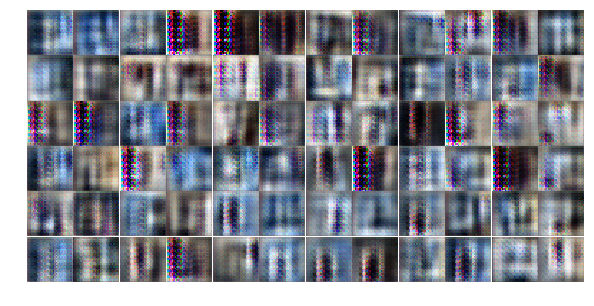

Epoch 10/25... Discriminator Loss: 1.9823... Generator Loss: 0.4442
Epoch 10/25... Discriminator Loss: 1.8322... Generator Loss: 0.3402
Epoch 10/25... Discriminator Loss: 1.1114... Generator Loss: 0.7987
Epoch 10/25... Discriminator Loss: 1.0884... Generator Loss: 0.8884
Epoch 10/25... Discriminator Loss: 0.7656... Generator Loss: 2.6299
Epoch 10/25... Discriminator Loss: 1.1987... Generator Loss: 0.8678
Epoch 10/25... Discriminator Loss: 0.6774... Generator Loss: 2.1732
Epoch 10/25... Discriminator Loss: 0.8118... Generator Loss: 2.0426
Epoch 10/25... Discriminator Loss: 0.8733... Generator Loss: 1.3975
Epoch 10/25... Discriminator Loss: 0.8683... Generator Loss: 2.0013


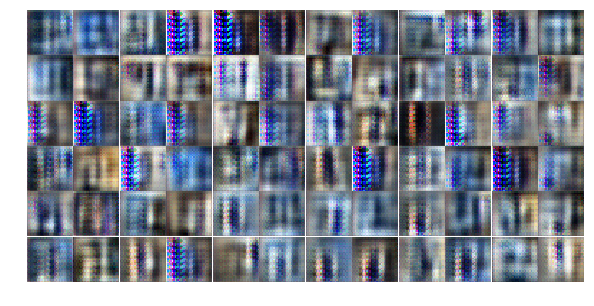

Epoch 10/25... Discriminator Loss: 0.9963... Generator Loss: 0.8773
Epoch 10/25... Discriminator Loss: 0.5141... Generator Loss: 5.5408
Epoch 10/25... Discriminator Loss: 0.7155... Generator Loss: 1.7579
Epoch 10/25... Discriminator Loss: 0.8356... Generator Loss: 1.2995
Epoch 10/25... Discriminator Loss: 0.9504... Generator Loss: 1.1591
Epoch 10/25... Discriminator Loss: 0.6394... Generator Loss: 2.5705
Epoch 10/25... Discriminator Loss: 0.8436... Generator Loss: 2.3240
Epoch 10/25... Discriminator Loss: 0.9296... Generator Loss: 2.2223
Epoch 10/25... Discriminator Loss: 0.9654... Generator Loss: 1.4206
Epoch 10/25... Discriminator Loss: 1.2749... Generator Loss: 4.4095


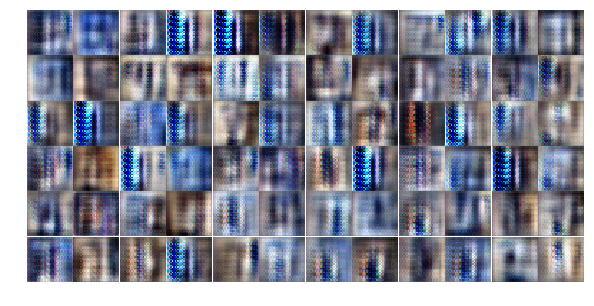

Epoch 10/25... Discriminator Loss: 0.8818... Generator Loss: 1.0755
Epoch 10/25... Discriminator Loss: 0.7376... Generator Loss: 2.0266
Epoch 10/25... Discriminator Loss: 0.7248... Generator Loss: 2.6419
Epoch 10/25... Discriminator Loss: 0.8524... Generator Loss: 1.2406
Epoch 10/25... Discriminator Loss: 1.1891... Generator Loss: 0.8336
Epoch 10/25... Discriminator Loss: 0.9025... Generator Loss: 1.7536
Epoch 10/25... Discriminator Loss: 1.1944... Generator Loss: 3.1631
Epoch 10/25... Discriminator Loss: 0.9640... Generator Loss: 0.8038
Epoch 10/25... Discriminator Loss: 0.7838... Generator Loss: 2.4473
Epoch 10/25... Discriminator Loss: 0.9478... Generator Loss: 2.4441


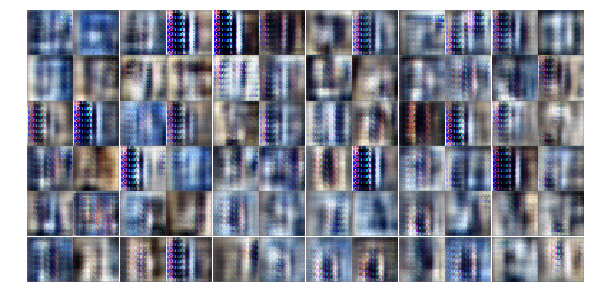

Epoch 10/25... Discriminator Loss: 1.0759... Generator Loss: 2.6307
Epoch 10/25... Discriminator Loss: 1.2981... Generator Loss: 1.2131
Epoch 10/25... Discriminator Loss: 0.9483... Generator Loss: 1.6362
Epoch 10/25... Discriminator Loss: 0.8833... Generator Loss: 1.4431
Epoch 10/25... Discriminator Loss: 0.8660... Generator Loss: 0.9697
Epoch 10/25... Discriminator Loss: 0.9723... Generator Loss: 2.1101
Epoch 10/25... Discriminator Loss: 1.5759... Generator Loss: 1.4986
Epoch 10/25... Discriminator Loss: 0.7967... Generator Loss: 1.9381
Epoch 10/25... Discriminator Loss: 0.7968... Generator Loss: 1.8644
Epoch 10/25... Discriminator Loss: 0.9429... Generator Loss: 0.8396


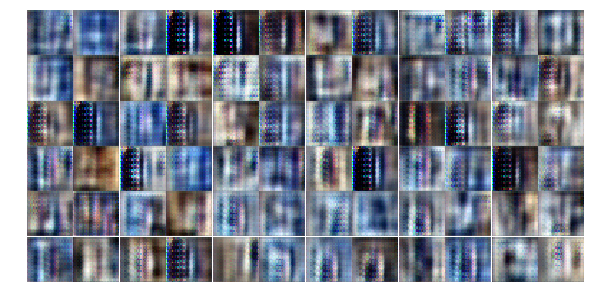

Epoch 10/25... Discriminator Loss: 1.1197... Generator Loss: 0.7816
Epoch 10/25... Discriminator Loss: 1.4788... Generator Loss: 4.0967
Epoch 10/25... Discriminator Loss: 0.8503... Generator Loss: 1.7203
Epoch 11/25... Discriminator Loss: 1.1770... Generator Loss: 0.5890
Epoch 11/25... Discriminator Loss: 1.0998... Generator Loss: 3.3289
Epoch 11/25... Discriminator Loss: 0.9099... Generator Loss: 1.0077
Epoch 11/25... Discriminator Loss: 0.8578... Generator Loss: 1.4639
Epoch 11/25... Discriminator Loss: 0.8337... Generator Loss: 1.6616
Epoch 11/25... Discriminator Loss: 1.0792... Generator Loss: 2.6550
Epoch 11/25... Discriminator Loss: 0.7577... Generator Loss: 1.5938


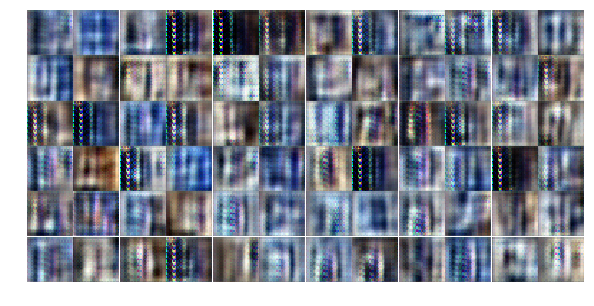

Epoch 11/25... Discriminator Loss: 0.7912... Generator Loss: 2.2338
Epoch 11/25... Discriminator Loss: 0.7218... Generator Loss: 1.7326
Epoch 11/25... Discriminator Loss: 0.7672... Generator Loss: 1.8616
Epoch 11/25... Discriminator Loss: 1.1185... Generator Loss: 0.7651
Epoch 11/25... Discriminator Loss: 0.9016... Generator Loss: 1.2521
Epoch 11/25... Discriminator Loss: 0.7680... Generator Loss: 2.3332
Epoch 11/25... Discriminator Loss: 0.8970... Generator Loss: 1.3326
Epoch 11/25... Discriminator Loss: 0.9224... Generator Loss: 2.1640
Epoch 11/25... Discriminator Loss: 0.9789... Generator Loss: 1.3010
Epoch 11/25... Discriminator Loss: 0.8955... Generator Loss: 1.5130


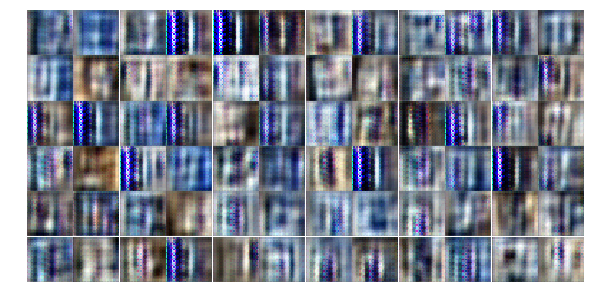

Epoch 11/25... Discriminator Loss: 0.7884... Generator Loss: 1.6628
Epoch 11/25... Discriminator Loss: 1.3638... Generator Loss: 0.8878
Epoch 11/25... Discriminator Loss: 0.8672... Generator Loss: 1.4561
Epoch 11/25... Discriminator Loss: 0.8079... Generator Loss: 1.3747
Epoch 11/25... Discriminator Loss: 1.6169... Generator Loss: 3.3396
Epoch 11/25... Discriminator Loss: 0.5357... Generator Loss: 2.7091
Epoch 11/25... Discriminator Loss: 1.4412... Generator Loss: 3.0749
Epoch 11/25... Discriminator Loss: 0.9079... Generator Loss: 1.7491
Epoch 11/25... Discriminator Loss: 1.0354... Generator Loss: 1.1671
Epoch 11/25... Discriminator Loss: 0.9041... Generator Loss: 1.7013


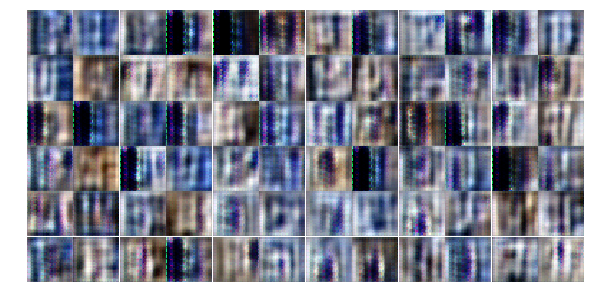

Epoch 11/25... Discriminator Loss: 0.9855... Generator Loss: 1.0586
Epoch 11/25... Discriminator Loss: 0.9976... Generator Loss: 1.9054
Epoch 11/25... Discriminator Loss: 1.0389... Generator Loss: 1.2698
Epoch 11/25... Discriminator Loss: 1.3479... Generator Loss: 2.3703
Epoch 11/25... Discriminator Loss: 0.9486... Generator Loss: 1.3300
Epoch 11/25... Discriminator Loss: 1.0464... Generator Loss: 0.8333
Epoch 11/25... Discriminator Loss: 0.8772... Generator Loss: 1.6315
Epoch 11/25... Discriminator Loss: 1.0593... Generator Loss: 1.2503
Epoch 11/25... Discriminator Loss: 0.8945... Generator Loss: 1.5438
Epoch 11/25... Discriminator Loss: 0.9918... Generator Loss: 1.3408


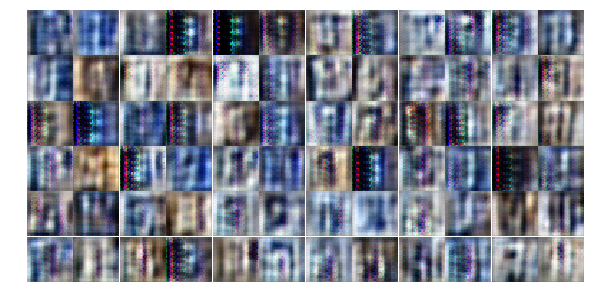

Epoch 11/25... Discriminator Loss: 1.0806... Generator Loss: 1.6933
Epoch 11/25... Discriminator Loss: 0.7360... Generator Loss: 2.3889
Epoch 11/25... Discriminator Loss: 0.9791... Generator Loss: 1.6237
Epoch 11/25... Discriminator Loss: 1.3178... Generator Loss: 0.6209
Epoch 11/25... Discriminator Loss: 0.9035... Generator Loss: 1.8048
Epoch 11/25... Discriminator Loss: 0.6328... Generator Loss: 4.0742
Epoch 11/25... Discriminator Loss: 0.9818... Generator Loss: 0.9085
Epoch 11/25... Discriminator Loss: 0.8242... Generator Loss: 1.3240
Epoch 11/25... Discriminator Loss: 2.1158... Generator Loss: 0.2261
Epoch 11/25... Discriminator Loss: 0.9751... Generator Loss: 1.4342


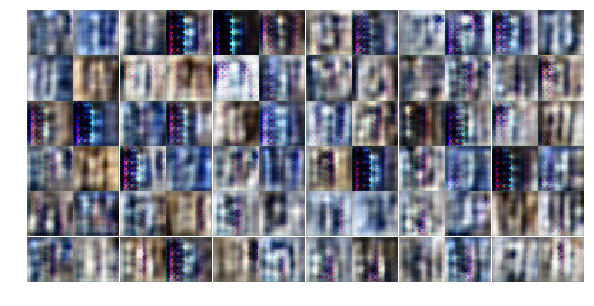

Epoch 11/25... Discriminator Loss: 1.0603... Generator Loss: 1.2277
Epoch 11/25... Discriminator Loss: 1.2130... Generator Loss: 0.8858
Epoch 11/25... Discriminator Loss: 0.9066... Generator Loss: 1.1402
Epoch 11/25... Discriminator Loss: 1.0062... Generator Loss: 1.2068
Epoch 11/25... Discriminator Loss: 1.1207... Generator Loss: 0.7770
Epoch 11/25... Discriminator Loss: 0.9629... Generator Loss: 1.0911
Epoch 11/25... Discriminator Loss: 1.3673... Generator Loss: 2.6937
Epoch 11/25... Discriminator Loss: 0.9724... Generator Loss: 1.2357
Epoch 11/25... Discriminator Loss: 0.7590... Generator Loss: 2.1984
Epoch 11/25... Discriminator Loss: 1.0210... Generator Loss: 1.1428


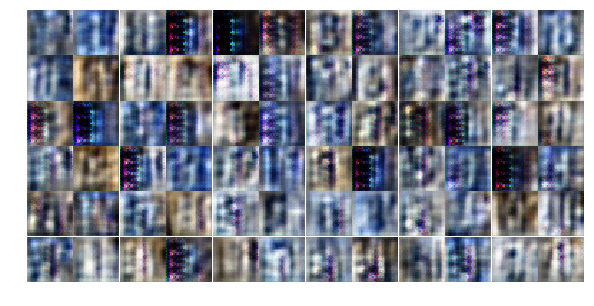

Epoch 12/25... Discriminator Loss: 1.0152... Generator Loss: 1.2087
Epoch 12/25... Discriminator Loss: 1.0315... Generator Loss: 0.9907
Epoch 12/25... Discriminator Loss: 1.0167... Generator Loss: 0.9403
Epoch 12/25... Discriminator Loss: 1.0702... Generator Loss: 0.9054
Epoch 12/25... Discriminator Loss: 1.2501... Generator Loss: 0.5775
Epoch 12/25... Discriminator Loss: 0.9932... Generator Loss: 1.2406
Epoch 12/25... Discriminator Loss: 1.1149... Generator Loss: 1.0320
Epoch 12/25... Discriminator Loss: 0.9395... Generator Loss: 1.2082
Epoch 12/25... Discriminator Loss: 1.0490... Generator Loss: 0.9997
Epoch 12/25... Discriminator Loss: 0.9799... Generator Loss: 1.1821


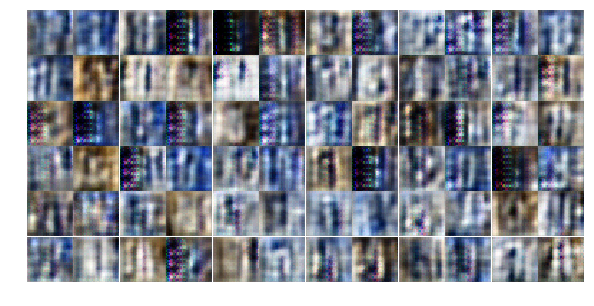

Epoch 12/25... Discriminator Loss: 1.2212... Generator Loss: 2.3995
Epoch 12/25... Discriminator Loss: 0.9930... Generator Loss: 1.0282
Epoch 12/25... Discriminator Loss: 1.3535... Generator Loss: 2.0043
Epoch 12/25... Discriminator Loss: 0.9050... Generator Loss: 1.3910
Epoch 12/25... Discriminator Loss: 1.4255... Generator Loss: 2.2558
Epoch 12/25... Discriminator Loss: 1.1337... Generator Loss: 1.5923
Epoch 12/25... Discriminator Loss: 1.0357... Generator Loss: 1.0771
Epoch 12/25... Discriminator Loss: 0.8804... Generator Loss: 1.4013
Epoch 12/25... Discriminator Loss: 1.0024... Generator Loss: 1.7135
Epoch 12/25... Discriminator Loss: 1.0952... Generator Loss: 1.6663


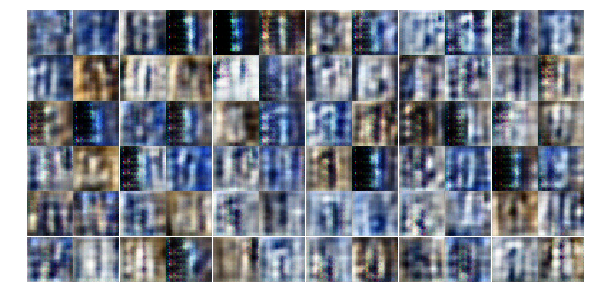

Epoch 12/25... Discriminator Loss: 1.0757... Generator Loss: 0.8297
Epoch 12/25... Discriminator Loss: 1.5536... Generator Loss: 2.4555
Epoch 12/25... Discriminator Loss: 0.9604... Generator Loss: 1.2432
Epoch 12/25... Discriminator Loss: 1.1405... Generator Loss: 1.9722
Epoch 12/25... Discriminator Loss: 0.8413... Generator Loss: 1.6167
Epoch 12/25... Discriminator Loss: 1.2891... Generator Loss: 3.0347
Epoch 12/25... Discriminator Loss: 1.0297... Generator Loss: 1.1419
Epoch 12/25... Discriminator Loss: 0.9923... Generator Loss: 1.4161
Epoch 12/25... Discriminator Loss: 0.9404... Generator Loss: 1.3096
Epoch 12/25... Discriminator Loss: 1.3395... Generator Loss: 1.8361


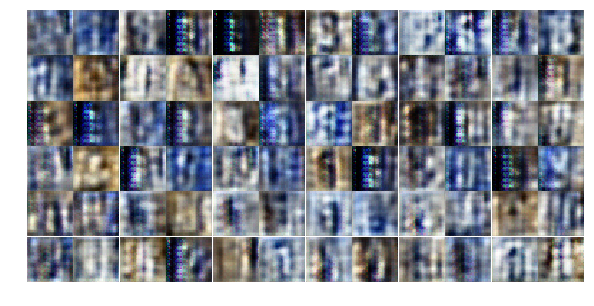

Epoch 12/25... Discriminator Loss: 1.0362... Generator Loss: 0.7742
Epoch 12/25... Discriminator Loss: 0.9707... Generator Loss: 1.2319
Epoch 12/25... Discriminator Loss: 1.0184... Generator Loss: 1.1089
Epoch 12/25... Discriminator Loss: 1.3269... Generator Loss: 0.8015
Epoch 12/25... Discriminator Loss: 1.2006... Generator Loss: 1.0752
Epoch 12/25... Discriminator Loss: 0.9034... Generator Loss: 2.0767
Epoch 12/25... Discriminator Loss: 0.9881... Generator Loss: 1.3267
Epoch 12/25... Discriminator Loss: 1.1848... Generator Loss: 2.5509
Epoch 12/25... Discriminator Loss: 0.8802... Generator Loss: 1.6309
Epoch 12/25... Discriminator Loss: 1.0606... Generator Loss: 2.1947


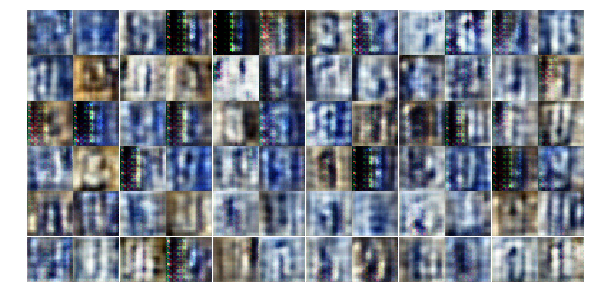

Epoch 12/25... Discriminator Loss: 1.0295... Generator Loss: 1.9641
Epoch 12/25... Discriminator Loss: 1.1638... Generator Loss: 0.6995
Epoch 12/25... Discriminator Loss: 1.0022... Generator Loss: 0.8302
Epoch 12/25... Discriminator Loss: 0.8963... Generator Loss: 1.5604
Epoch 12/25... Discriminator Loss: 1.0504... Generator Loss: 1.4443
Epoch 12/25... Discriminator Loss: 0.9265... Generator Loss: 1.6251
Epoch 12/25... Discriminator Loss: 1.0401... Generator Loss: 1.2879
Epoch 12/25... Discriminator Loss: 1.0901... Generator Loss: 1.1220
Epoch 12/25... Discriminator Loss: 1.5172... Generator Loss: 0.4367
Epoch 12/25... Discriminator Loss: 0.8378... Generator Loss: 1.1294


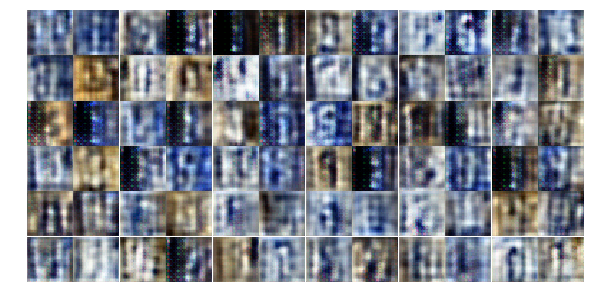

Epoch 12/25... Discriminator Loss: 1.1175... Generator Loss: 1.2929
Epoch 12/25... Discriminator Loss: 1.1270... Generator Loss: 0.7989
Epoch 12/25... Discriminator Loss: 0.6750... Generator Loss: 2.7352
Epoch 12/25... Discriminator Loss: 0.7786... Generator Loss: 1.6291
Epoch 12/25... Discriminator Loss: 1.5858... Generator Loss: 0.8547
Epoch 12/25... Discriminator Loss: 1.6955... Generator Loss: 0.3495
Epoch 12/25... Discriminator Loss: 0.9636... Generator Loss: 1.2387
Epoch 13/25... Discriminator Loss: 1.0053... Generator Loss: 1.3760
Epoch 13/25... Discriminator Loss: 0.9669... Generator Loss: 1.3708
Epoch 13/25... Discriminator Loss: 1.0522... Generator Loss: 1.0963


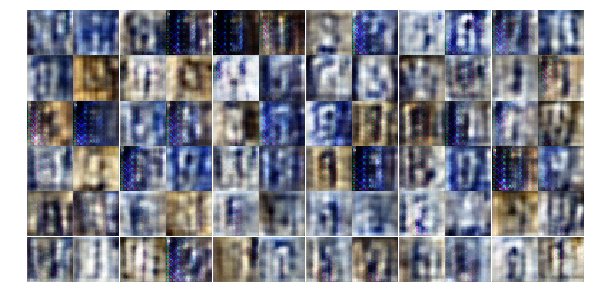

Epoch 13/25... Discriminator Loss: 1.2429... Generator Loss: 2.3371
Epoch 13/25... Discriminator Loss: 0.9612... Generator Loss: 1.4814
Epoch 13/25... Discriminator Loss: 1.1224... Generator Loss: 0.7033
Epoch 13/25... Discriminator Loss: 1.1460... Generator Loss: 1.1792
Epoch 13/25... Discriminator Loss: 1.1491... Generator Loss: 0.7577
Epoch 13/25... Discriminator Loss: 1.0573... Generator Loss: 1.1429
Epoch 13/25... Discriminator Loss: 1.1305... Generator Loss: 0.7818
Epoch 13/25... Discriminator Loss: 1.0420... Generator Loss: 0.8640
Epoch 13/25... Discriminator Loss: 1.0824... Generator Loss: 1.1078
Epoch 13/25... Discriminator Loss: 0.8350... Generator Loss: 1.6426


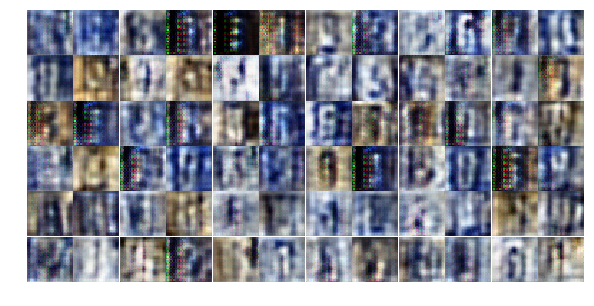

Epoch 13/25... Discriminator Loss: 1.9646... Generator Loss: 2.9343
Epoch 13/25... Discriminator Loss: 0.8242... Generator Loss: 1.7878
Epoch 13/25... Discriminator Loss: 1.0475... Generator Loss: 1.5936
Epoch 13/25... Discriminator Loss: 1.1537... Generator Loss: 2.2284
Epoch 13/25... Discriminator Loss: 0.8950... Generator Loss: 1.2645
Epoch 13/25... Discriminator Loss: 1.0923... Generator Loss: 0.8573
Epoch 13/25... Discriminator Loss: 0.9541... Generator Loss: 1.1049
Epoch 13/25... Discriminator Loss: 0.8891... Generator Loss: 1.7273
Epoch 13/25... Discriminator Loss: 0.9930... Generator Loss: 1.0579
Epoch 13/25... Discriminator Loss: 1.0101... Generator Loss: 0.9027


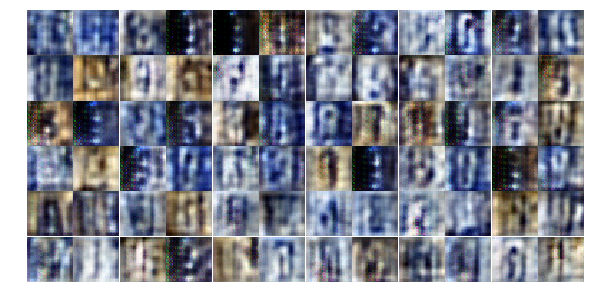

Epoch 13/25... Discriminator Loss: 1.1783... Generator Loss: 1.3382
Epoch 13/25... Discriminator Loss: 1.0626... Generator Loss: 1.4808
Epoch 13/25... Discriminator Loss: 1.0114... Generator Loss: 1.1174
Epoch 13/25... Discriminator Loss: 0.9498... Generator Loss: 1.4313
Epoch 13/25... Discriminator Loss: 0.9248... Generator Loss: 1.5130
Epoch 13/25... Discriminator Loss: 1.0164... Generator Loss: 0.9973
Epoch 13/25... Discriminator Loss: 1.2236... Generator Loss: 0.7178
Epoch 13/25... Discriminator Loss: 1.1254... Generator Loss: 1.2129
Epoch 13/25... Discriminator Loss: 1.0572... Generator Loss: 1.8378
Epoch 13/25... Discriminator Loss: 0.8855... Generator Loss: 1.5357


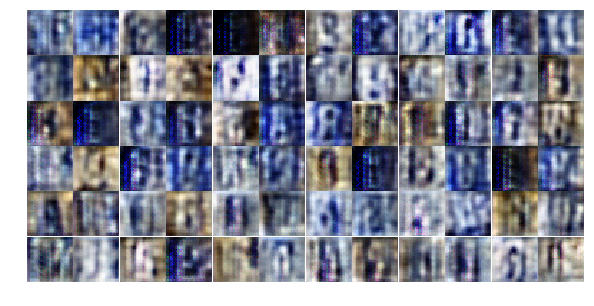

Epoch 13/25... Discriminator Loss: 0.9844... Generator Loss: 1.6129
Epoch 13/25... Discriminator Loss: 2.1313... Generator Loss: 2.8398
Epoch 13/25... Discriminator Loss: 1.3827... Generator Loss: 0.4352
Epoch 13/25... Discriminator Loss: 0.9322... Generator Loss: 1.3500
Epoch 13/25... Discriminator Loss: 1.1163... Generator Loss: 1.8137
Epoch 13/25... Discriminator Loss: 1.0813... Generator Loss: 1.5822
Epoch 13/25... Discriminator Loss: 0.9650... Generator Loss: 1.2707
Epoch 13/25... Discriminator Loss: 0.9792... Generator Loss: 1.4928
Epoch 13/25... Discriminator Loss: 1.0927... Generator Loss: 1.2033
Epoch 13/25... Discriminator Loss: 0.8219... Generator Loss: 2.1562


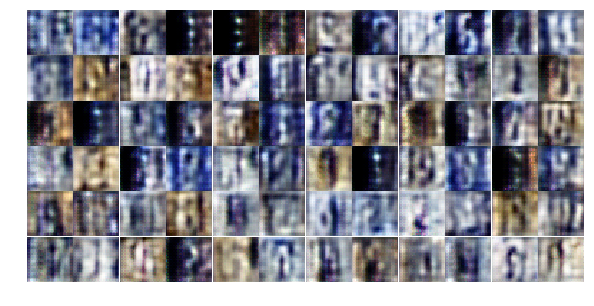

Epoch 13/25... Discriminator Loss: 0.9017... Generator Loss: 1.3614
Epoch 13/25... Discriminator Loss: 1.5029... Generator Loss: 1.0696
Epoch 13/25... Discriminator Loss: 1.1085... Generator Loss: 1.3093
Epoch 13/25... Discriminator Loss: 1.0055... Generator Loss: 1.4389
Epoch 13/25... Discriminator Loss: 0.8510... Generator Loss: 1.7951
Epoch 13/25... Discriminator Loss: 0.9221... Generator Loss: 2.1903
Epoch 13/25... Discriminator Loss: 0.9847... Generator Loss: 1.4190
Epoch 13/25... Discriminator Loss: 1.2317... Generator Loss: 1.9474
Epoch 13/25... Discriminator Loss: 1.6761... Generator Loss: 1.6142
Epoch 13/25... Discriminator Loss: 1.0374... Generator Loss: 0.8695


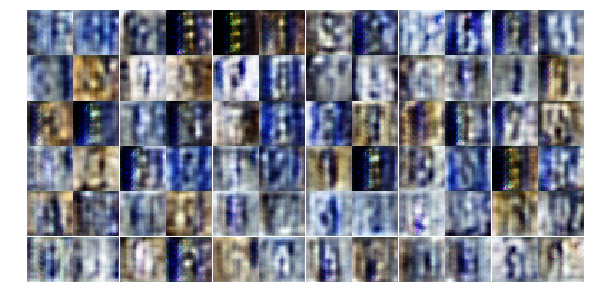

Epoch 13/25... Discriminator Loss: 0.7275... Generator Loss: 2.2925
Epoch 13/25... Discriminator Loss: 1.0225... Generator Loss: 1.3189
Epoch 13/25... Discriminator Loss: 1.2855... Generator Loss: 1.3455
Epoch 13/25... Discriminator Loss: 0.9813... Generator Loss: 0.9880
Epoch 14/25... Discriminator Loss: 1.0156... Generator Loss: 0.9142
Epoch 14/25... Discriminator Loss: 0.6323... Generator Loss: 2.9718
Epoch 14/25... Discriminator Loss: 1.1276... Generator Loss: 0.7963
Epoch 14/25... Discriminator Loss: 0.9313... Generator Loss: 2.1038
Epoch 14/25... Discriminator Loss: 0.9361... Generator Loss: 1.0591
Epoch 14/25... Discriminator Loss: 1.1256... Generator Loss: 0.7312


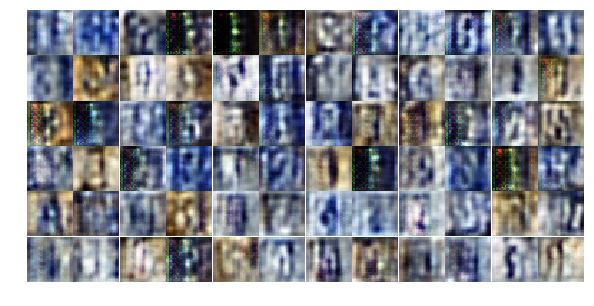

Epoch 14/25... Discriminator Loss: 1.3996... Generator Loss: 1.7753
Epoch 14/25... Discriminator Loss: 0.9988... Generator Loss: 1.1230
Epoch 14/25... Discriminator Loss: 0.8023... Generator Loss: 1.6386
Epoch 14/25... Discriminator Loss: 1.7341... Generator Loss: 0.7176
Epoch 14/25... Discriminator Loss: 1.1985... Generator Loss: 0.6854
Epoch 14/25... Discriminator Loss: 1.0919... Generator Loss: 1.0314
Epoch 14/25... Discriminator Loss: 1.0814... Generator Loss: 1.8442
Epoch 14/25... Discriminator Loss: 1.0043... Generator Loss: 2.1767
Epoch 14/25... Discriminator Loss: 1.0414... Generator Loss: 1.1046
Epoch 14/25... Discriminator Loss: 1.2107... Generator Loss: 0.6347


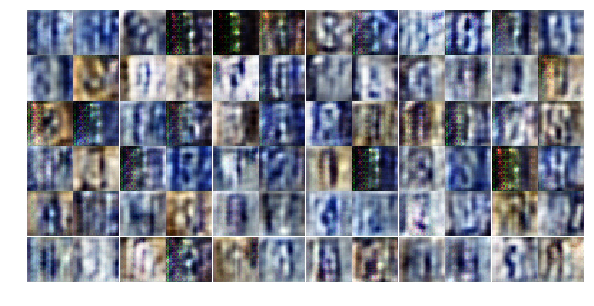

Epoch 14/25... Discriminator Loss: 0.8516... Generator Loss: 2.4271
Epoch 14/25... Discriminator Loss: 0.9569... Generator Loss: 1.1727
Epoch 14/25... Discriminator Loss: 1.0780... Generator Loss: 0.9895
Epoch 14/25... Discriminator Loss: 1.1575... Generator Loss: 1.0552
Epoch 14/25... Discriminator Loss: 1.2043... Generator Loss: 1.1203
Epoch 14/25... Discriminator Loss: 1.2408... Generator Loss: 1.1787
Epoch 14/25... Discriminator Loss: 1.0398... Generator Loss: 1.4292
Epoch 14/25... Discriminator Loss: 0.9133... Generator Loss: 1.6668
Epoch 14/25... Discriminator Loss: 1.0520... Generator Loss: 1.5261
Epoch 14/25... Discriminator Loss: 0.7877... Generator Loss: 1.6811


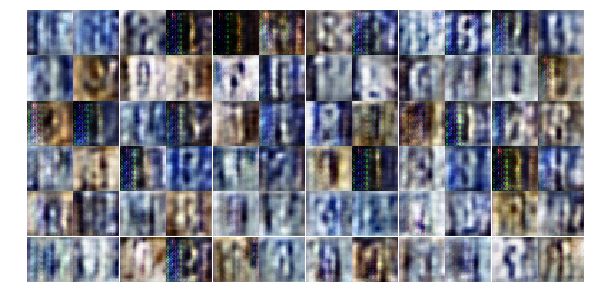

Epoch 14/25... Discriminator Loss: 1.0463... Generator Loss: 1.2521
Epoch 14/25... Discriminator Loss: 0.9641... Generator Loss: 1.5784
Epoch 14/25... Discriminator Loss: 0.9720... Generator Loss: 1.1128
Epoch 14/25... Discriminator Loss: 0.9774... Generator Loss: 1.2737
Epoch 14/25... Discriminator Loss: 0.9442... Generator Loss: 1.6300
Epoch 14/25... Discriminator Loss: 1.1257... Generator Loss: 1.1390
Epoch 14/25... Discriminator Loss: 0.8636... Generator Loss: 1.5411
Epoch 14/25... Discriminator Loss: 1.1907... Generator Loss: 1.7798
Epoch 14/25... Discriminator Loss: 0.9741... Generator Loss: 1.2355
Epoch 14/25... Discriminator Loss: 1.2608... Generator Loss: 0.7199


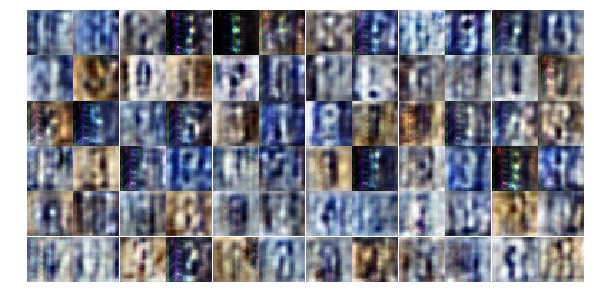

Epoch 14/25... Discriminator Loss: 1.2609... Generator Loss: 0.5842
Epoch 14/25... Discriminator Loss: 1.1111... Generator Loss: 0.6973
Epoch 14/25... Discriminator Loss: 0.7414... Generator Loss: 2.8347
Epoch 14/25... Discriminator Loss: 1.0756... Generator Loss: 1.4421
Epoch 14/25... Discriminator Loss: 1.2295... Generator Loss: 0.7758
Epoch 14/25... Discriminator Loss: 0.9429... Generator Loss: 1.3970
Epoch 14/25... Discriminator Loss: 1.0622... Generator Loss: 0.9002
Epoch 14/25... Discriminator Loss: 1.0197... Generator Loss: 1.2745
Epoch 14/25... Discriminator Loss: 0.9159... Generator Loss: 1.6486
Epoch 14/25... Discriminator Loss: 2.1679... Generator Loss: 2.6059


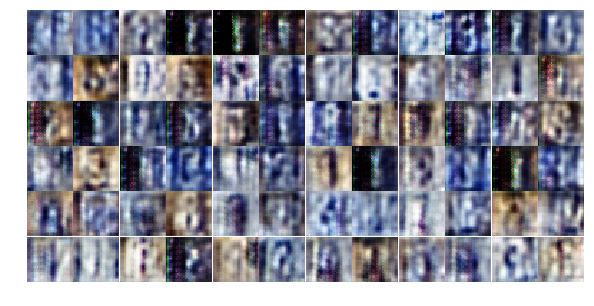

Epoch 14/25... Discriminator Loss: 1.2220... Generator Loss: 1.1083
Epoch 14/25... Discriminator Loss: 0.8496... Generator Loss: 1.6598
Epoch 14/25... Discriminator Loss: 1.0378... Generator Loss: 0.9955
Epoch 14/25... Discriminator Loss: 1.0672... Generator Loss: 1.5658
Epoch 14/25... Discriminator Loss: 1.0323... Generator Loss: 1.4111
Epoch 14/25... Discriminator Loss: 0.8699... Generator Loss: 1.4619
Epoch 14/25... Discriminator Loss: 1.0714... Generator Loss: 2.0418
Epoch 14/25... Discriminator Loss: 1.1356... Generator Loss: 0.8038
Epoch 14/25... Discriminator Loss: 0.7901... Generator Loss: 1.7891
Epoch 14/25... Discriminator Loss: 1.0475... Generator Loss: 1.2810


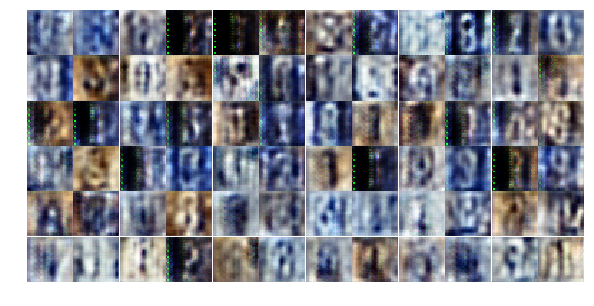

Epoch 14/25... Discriminator Loss: 1.0723... Generator Loss: 0.9135
Epoch 14/25... Discriminator Loss: 1.4677... Generator Loss: 2.2890
Epoch 15/25... Discriminator Loss: 1.2316... Generator Loss: 0.7785
Epoch 15/25... Discriminator Loss: 0.9803... Generator Loss: 1.5739
Epoch 15/25... Discriminator Loss: 0.9973... Generator Loss: 0.9987
Epoch 15/25... Discriminator Loss: 1.0001... Generator Loss: 1.1775
Epoch 15/25... Discriminator Loss: 0.9567... Generator Loss: 1.2477
Epoch 15/25... Discriminator Loss: 0.9596... Generator Loss: 1.2292
Epoch 15/25... Discriminator Loss: 1.1105... Generator Loss: 1.0822
Epoch 15/25... Discriminator Loss: 1.1284... Generator Loss: 1.1774


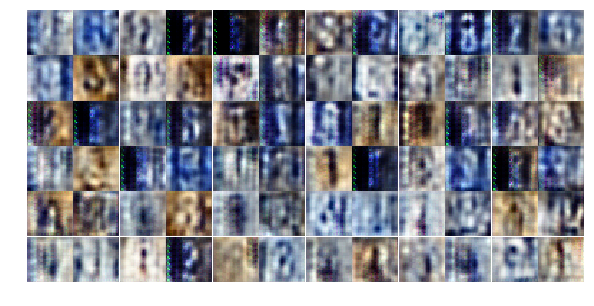

Epoch 15/25... Discriminator Loss: 0.9080... Generator Loss: 1.2879
Epoch 15/25... Discriminator Loss: 1.0888... Generator Loss: 0.9790
Epoch 15/25... Discriminator Loss: 1.0856... Generator Loss: 1.0369
Epoch 15/25... Discriminator Loss: 0.8355... Generator Loss: 1.4997
Epoch 15/25... Discriminator Loss: 0.8147... Generator Loss: 1.8188
Epoch 15/25... Discriminator Loss: 1.2332... Generator Loss: 0.6364
Epoch 15/25... Discriminator Loss: 2.6360... Generator Loss: 1.1444
Epoch 15/25... Discriminator Loss: 1.1958... Generator Loss: 0.7349
Epoch 15/25... Discriminator Loss: 1.0754... Generator Loss: 0.7804
Epoch 15/25... Discriminator Loss: 1.2199... Generator Loss: 0.7696


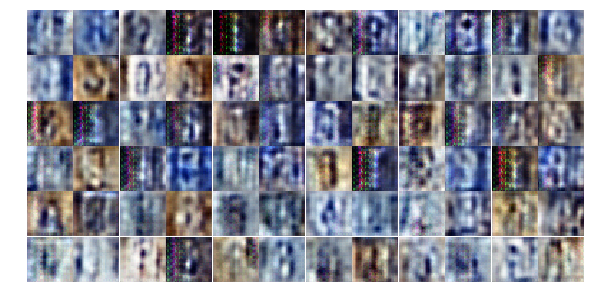

Epoch 15/25... Discriminator Loss: 0.9884... Generator Loss: 1.0162
Epoch 15/25... Discriminator Loss: 1.0409... Generator Loss: 1.2491
Epoch 15/25... Discriminator Loss: 1.0328... Generator Loss: 1.9314
Epoch 15/25... Discriminator Loss: 0.8930... Generator Loss: 1.3995
Epoch 15/25... Discriminator Loss: 0.9080... Generator Loss: 1.1324
Epoch 15/25... Discriminator Loss: 1.8692... Generator Loss: 4.1459
Epoch 15/25... Discriminator Loss: 0.9086... Generator Loss: 1.3425
Epoch 15/25... Discriminator Loss: 1.3121... Generator Loss: 0.8341
Epoch 15/25... Discriminator Loss: 0.9282... Generator Loss: 2.0732
Epoch 15/25... Discriminator Loss: 1.0265... Generator Loss: 1.1557


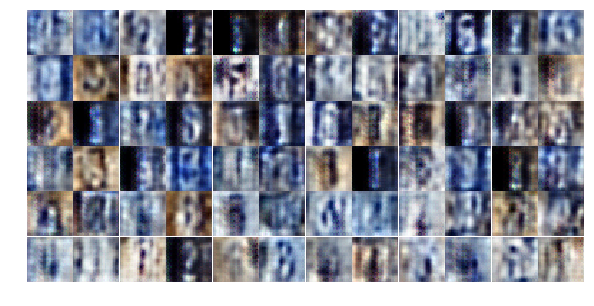

Epoch 15/25... Discriminator Loss: 0.9229... Generator Loss: 1.3433
Epoch 15/25... Discriminator Loss: 1.0810... Generator Loss: 0.9922
Epoch 15/25... Discriminator Loss: 2.1019... Generator Loss: 3.3625
Epoch 15/25... Discriminator Loss: 0.9333... Generator Loss: 1.3289
Epoch 15/25... Discriminator Loss: 0.9103... Generator Loss: 1.1146
Epoch 15/25... Discriminator Loss: 0.8850... Generator Loss: 2.1550
Epoch 15/25... Discriminator Loss: 5.8716... Generator Loss: 0.0518
Epoch 15/25... Discriminator Loss: 1.4058... Generator Loss: 0.6394
Epoch 15/25... Discriminator Loss: 1.2881... Generator Loss: 1.0550
Epoch 15/25... Discriminator Loss: 1.2072... Generator Loss: 1.3851


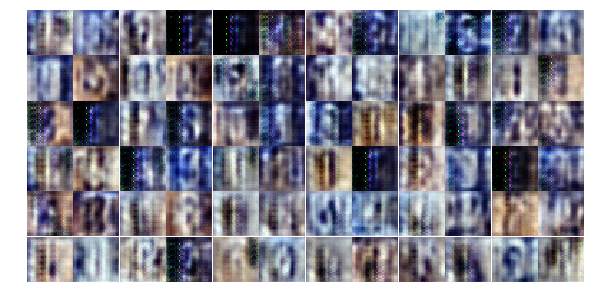

Epoch 15/25... Discriminator Loss: 0.9979... Generator Loss: 1.0379
Epoch 15/25... Discriminator Loss: 1.4791... Generator Loss: 0.4729
Epoch 15/25... Discriminator Loss: 1.1427... Generator Loss: 0.9428
Epoch 15/25... Discriminator Loss: 1.1179... Generator Loss: 1.1395
Epoch 15/25... Discriminator Loss: 1.2090... Generator Loss: 0.7590
Epoch 15/25... Discriminator Loss: 1.2538... Generator Loss: 0.8009
Epoch 15/25... Discriminator Loss: 1.0313... Generator Loss: 1.0229
Epoch 15/25... Discriminator Loss: 1.0867... Generator Loss: 1.0962
Epoch 15/25... Discriminator Loss: 1.3693... Generator Loss: 0.7054
Epoch 15/25... Discriminator Loss: 1.1874... Generator Loss: 1.0079


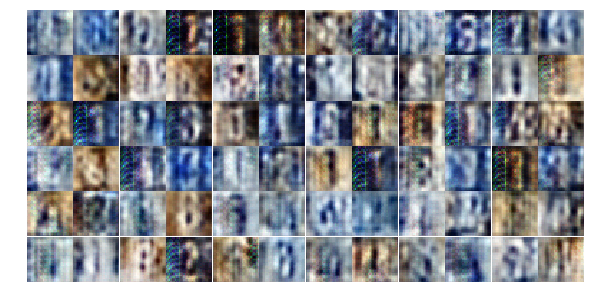

Epoch 15/25... Discriminator Loss: 1.1282... Generator Loss: 0.9309
Epoch 15/25... Discriminator Loss: 1.0818... Generator Loss: 0.8458
Epoch 15/25... Discriminator Loss: 0.9419... Generator Loss: 1.2911
Epoch 15/25... Discriminator Loss: 0.9985... Generator Loss: 1.8226
Epoch 15/25... Discriminator Loss: 0.9845... Generator Loss: 1.1024
Epoch 15/25... Discriminator Loss: 0.9365... Generator Loss: 1.9994
Epoch 15/25... Discriminator Loss: 0.9924... Generator Loss: 1.1193
Epoch 15/25... Discriminator Loss: 0.8780... Generator Loss: 1.4649
Epoch 15/25... Discriminator Loss: 1.1939... Generator Loss: 1.6531
Epoch 16/25... Discriminator Loss: 1.0704... Generator Loss: 1.0849


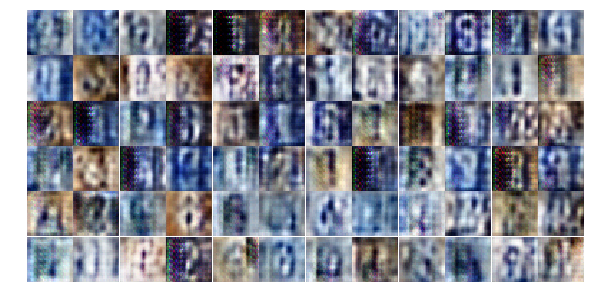

Epoch 16/25... Discriminator Loss: 1.0637... Generator Loss: 1.3307
Epoch 16/25... Discriminator Loss: 1.0168... Generator Loss: 1.1692
Epoch 16/25... Discriminator Loss: 1.0008... Generator Loss: 1.1657
Epoch 16/25... Discriminator Loss: 1.0522... Generator Loss: 1.0312
Epoch 16/25... Discriminator Loss: 1.0085... Generator Loss: 1.2547
Epoch 16/25... Discriminator Loss: 0.9793... Generator Loss: 1.0542
Epoch 16/25... Discriminator Loss: 1.2453... Generator Loss: 1.6468
Epoch 16/25... Discriminator Loss: 0.9719... Generator Loss: 1.1934
Epoch 16/25... Discriminator Loss: 0.9923... Generator Loss: 1.2017
Epoch 16/25... Discriminator Loss: 0.9600... Generator Loss: 1.5152


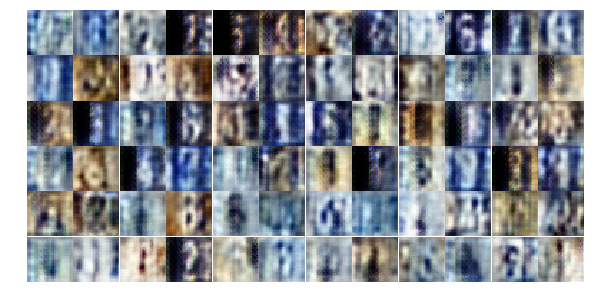

Epoch 16/25... Discriminator Loss: 0.9271... Generator Loss: 1.4166
Epoch 16/25... Discriminator Loss: 1.0198... Generator Loss: 3.5327
Epoch 16/25... Discriminator Loss: 0.9258... Generator Loss: 1.2121
Epoch 16/25... Discriminator Loss: 1.0435... Generator Loss: 1.1254
Epoch 16/25... Discriminator Loss: 1.1111... Generator Loss: 0.9391
Epoch 16/25... Discriminator Loss: 0.9994... Generator Loss: 1.4358
Epoch 16/25... Discriminator Loss: 0.9081... Generator Loss: 1.5174
Epoch 16/25... Discriminator Loss: 1.1252... Generator Loss: 1.1931
Epoch 16/25... Discriminator Loss: 0.9180... Generator Loss: 1.3997
Epoch 16/25... Discriminator Loss: 0.9218... Generator Loss: 1.4004


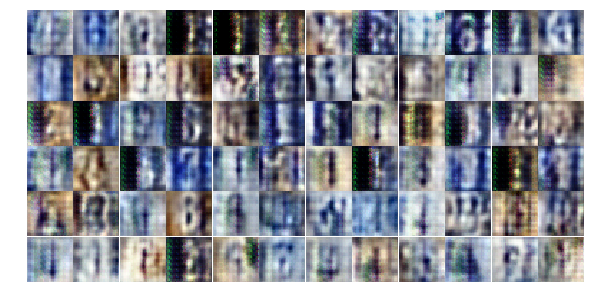

Epoch 16/25... Discriminator Loss: 0.9087... Generator Loss: 1.4545
Epoch 16/25... Discriminator Loss: 1.3895... Generator Loss: 2.8561
Epoch 16/25... Discriminator Loss: 0.9851... Generator Loss: 1.4810
Epoch 16/25... Discriminator Loss: 1.0145... Generator Loss: 0.9813
Epoch 16/25... Discriminator Loss: 1.0314... Generator Loss: 1.1226
Epoch 16/25... Discriminator Loss: 0.9105... Generator Loss: 1.4876
Epoch 16/25... Discriminator Loss: 1.0696... Generator Loss: 0.8811
Epoch 16/25... Discriminator Loss: 0.8213... Generator Loss: 1.6628
Epoch 16/25... Discriminator Loss: 1.6169... Generator Loss: 0.4977
Epoch 16/25... Discriminator Loss: 0.9346... Generator Loss: 1.1766


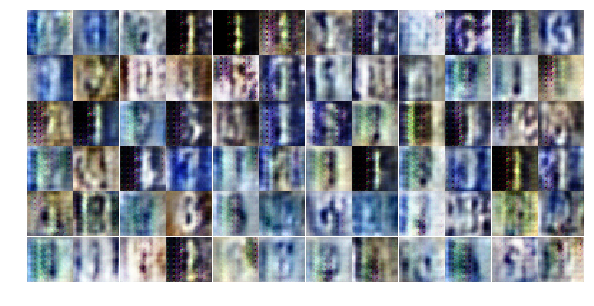

Epoch 16/25... Discriminator Loss: 0.8916... Generator Loss: 1.1726
Epoch 16/25... Discriminator Loss: 1.0711... Generator Loss: 0.7610
Epoch 16/25... Discriminator Loss: 0.6185... Generator Loss: 3.9866
Epoch 16/25... Discriminator Loss: 1.5087... Generator Loss: 2.5318
Epoch 16/25... Discriminator Loss: 0.9315... Generator Loss: 1.1010
Epoch 16/25... Discriminator Loss: 0.9742... Generator Loss: 1.2469
Epoch 16/25... Discriminator Loss: 0.8895... Generator Loss: 1.3622
Epoch 16/25... Discriminator Loss: 0.9232... Generator Loss: 1.6025
Epoch 16/25... Discriminator Loss: 1.0555... Generator Loss: 0.9448
Epoch 16/25... Discriminator Loss: 0.8403... Generator Loss: 1.4382


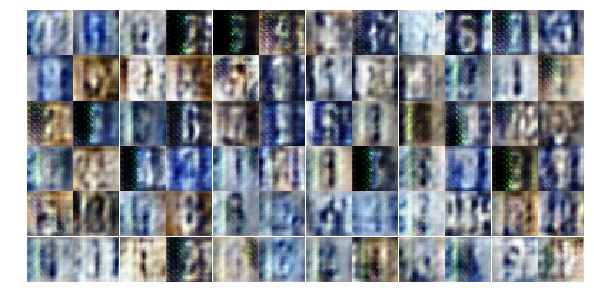

Epoch 16/25... Discriminator Loss: 0.9789... Generator Loss: 1.2497
Epoch 16/25... Discriminator Loss: 0.9084... Generator Loss: 1.1936
Epoch 16/25... Discriminator Loss: 0.8918... Generator Loss: 1.3084
Epoch 16/25... Discriminator Loss: 0.9386... Generator Loss: 0.9723
Epoch 16/25... Discriminator Loss: 0.9361... Generator Loss: 1.1332
Epoch 16/25... Discriminator Loss: 0.9533... Generator Loss: 1.1938
Epoch 16/25... Discriminator Loss: 0.9737... Generator Loss: 1.1018
Epoch 16/25... Discriminator Loss: 0.8956... Generator Loss: 1.3571
Epoch 16/25... Discriminator Loss: 0.8970... Generator Loss: 1.7145
Epoch 16/25... Discriminator Loss: 0.9180... Generator Loss: 1.4337


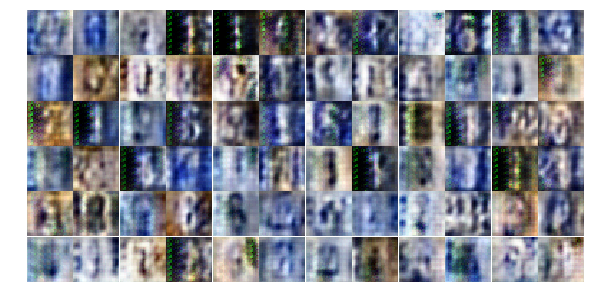

Epoch 16/25... Discriminator Loss: 0.9847... Generator Loss: 0.9969
Epoch 16/25... Discriminator Loss: 1.0290... Generator Loss: 1.0635
Epoch 16/25... Discriminator Loss: 1.0215... Generator Loss: 1.9038
Epoch 16/25... Discriminator Loss: 0.9582... Generator Loss: 1.0648
Epoch 16/25... Discriminator Loss: 0.7604... Generator Loss: 1.4257
Epoch 16/25... Discriminator Loss: 1.1005... Generator Loss: 1.1569
Epoch 17/25... Discriminator Loss: 1.0120... Generator Loss: 1.0910
Epoch 17/25... Discriminator Loss: 0.8478... Generator Loss: 1.3631
Epoch 17/25... Discriminator Loss: 0.7563... Generator Loss: 1.5445
Epoch 17/25... Discriminator Loss: 0.8304... Generator Loss: 1.6961


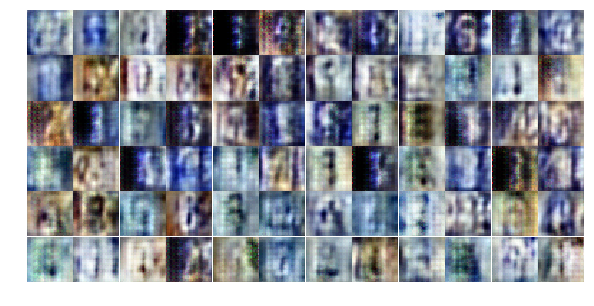

Epoch 17/25... Discriminator Loss: 0.8789... Generator Loss: 1.1809
Epoch 17/25... Discriminator Loss: 1.8305... Generator Loss: 2.7128
Epoch 17/25... Discriminator Loss: 1.0562... Generator Loss: 1.0272
Epoch 17/25... Discriminator Loss: 0.8648... Generator Loss: 1.2346
Epoch 17/25... Discriminator Loss: 1.0310... Generator Loss: 1.4783
Epoch 17/25... Discriminator Loss: 0.7202... Generator Loss: 1.9650
Epoch 17/25... Discriminator Loss: 0.9949... Generator Loss: 1.1866
Epoch 17/25... Discriminator Loss: 0.8194... Generator Loss: 1.4699
Epoch 17/25... Discriminator Loss: 0.8810... Generator Loss: 1.0023
Epoch 17/25... Discriminator Loss: 0.8946... Generator Loss: 1.3424


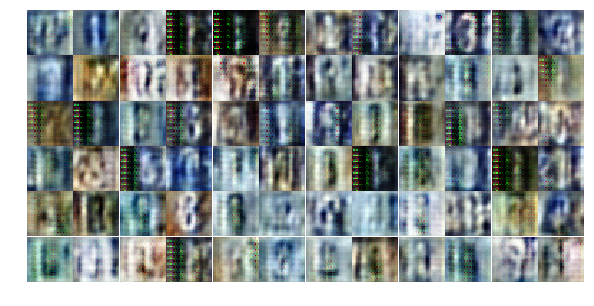

Epoch 17/25... Discriminator Loss: 1.2683... Generator Loss: 1.4355
Epoch 17/25... Discriminator Loss: 0.9077... Generator Loss: 1.9282
Epoch 17/25... Discriminator Loss: 0.9579... Generator Loss: 1.2581
Epoch 17/25... Discriminator Loss: 1.0382... Generator Loss: 1.2159
Epoch 17/25... Discriminator Loss: 1.0084... Generator Loss: 1.1924
Epoch 17/25... Discriminator Loss: 0.9635... Generator Loss: 1.8458
Epoch 17/25... Discriminator Loss: 0.9543... Generator Loss: 1.4999
Epoch 17/25... Discriminator Loss: 1.0171... Generator Loss: 2.1748
Epoch 17/25... Discriminator Loss: 0.9347... Generator Loss: 1.0198
Epoch 17/25... Discriminator Loss: 1.0440... Generator Loss: 1.1591


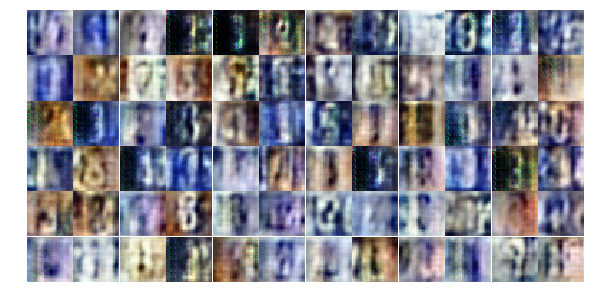

Epoch 17/25... Discriminator Loss: 0.8254... Generator Loss: 2.1152
Epoch 17/25... Discriminator Loss: 0.8601... Generator Loss: 1.9584
Epoch 17/25... Discriminator Loss: 0.7831... Generator Loss: 1.4740
Epoch 17/25... Discriminator Loss: 0.7644... Generator Loss: 1.5133
Epoch 17/25... Discriminator Loss: 0.9091... Generator Loss: 1.7554
Epoch 17/25... Discriminator Loss: 0.7684... Generator Loss: 1.2921
Epoch 17/25... Discriminator Loss: 0.7556... Generator Loss: 1.5906
Epoch 17/25... Discriminator Loss: 0.8244... Generator Loss: 1.4364
Epoch 17/25... Discriminator Loss: 1.2579... Generator Loss: 0.7799
Epoch 17/25... Discriminator Loss: 0.8930... Generator Loss: 1.5111


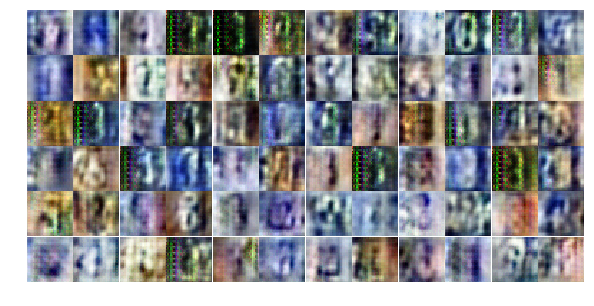

Epoch 17/25... Discriminator Loss: 0.8167... Generator Loss: 1.1554
Epoch 17/25... Discriminator Loss: 1.3100... Generator Loss: 0.6677
Epoch 17/25... Discriminator Loss: 0.9660... Generator Loss: 1.0801
Epoch 17/25... Discriminator Loss: 0.8732... Generator Loss: 1.2587
Epoch 17/25... Discriminator Loss: 0.9633... Generator Loss: 1.3559
Epoch 17/25... Discriminator Loss: 0.8528... Generator Loss: 1.0517
Epoch 17/25... Discriminator Loss: 0.8079... Generator Loss: 1.4100
Epoch 17/25... Discriminator Loss: 1.1521... Generator Loss: 2.1483
Epoch 17/25... Discriminator Loss: 1.1501... Generator Loss: 1.4968
Epoch 17/25... Discriminator Loss: 0.9291... Generator Loss: 1.2370


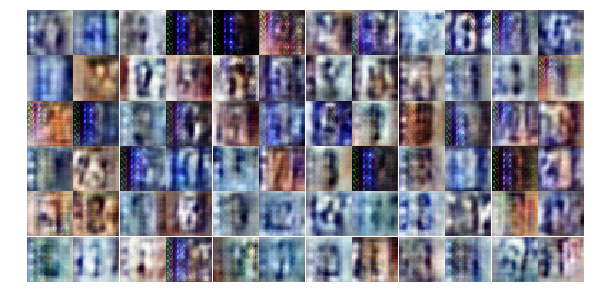

Epoch 17/25... Discriminator Loss: 1.0081... Generator Loss: 1.1318
Epoch 17/25... Discriminator Loss: 0.9892... Generator Loss: 1.3315
Epoch 17/25... Discriminator Loss: 0.9950... Generator Loss: 0.9820
Epoch 17/25... Discriminator Loss: 0.9634... Generator Loss: 1.0010
Epoch 17/25... Discriminator Loss: 0.9814... Generator Loss: 0.8499
Epoch 17/25... Discriminator Loss: 0.9039... Generator Loss: 1.1267
Epoch 17/25... Discriminator Loss: 0.9053... Generator Loss: 1.3480
Epoch 17/25... Discriminator Loss: 0.9146... Generator Loss: 1.0569
Epoch 17/25... Discriminator Loss: 0.9761... Generator Loss: 1.0966
Epoch 17/25... Discriminator Loss: 1.0492... Generator Loss: 1.0264


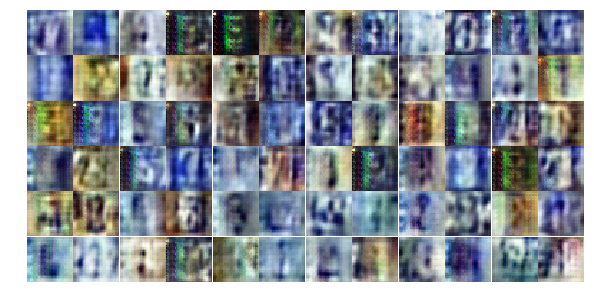

Epoch 17/25... Discriminator Loss: 0.7922... Generator Loss: 1.5329
Epoch 17/25... Discriminator Loss: 0.8127... Generator Loss: 1.2477
Epoch 17/25... Discriminator Loss: 0.7865... Generator Loss: 1.3102
Epoch 17/25... Discriminator Loss: 0.8789... Generator Loss: 1.3166
Epoch 18/25... Discriminator Loss: 0.9138... Generator Loss: 1.3108
Epoch 18/25... Discriminator Loss: 0.9760... Generator Loss: 1.0049
Epoch 18/25... Discriminator Loss: 0.7249... Generator Loss: 1.4089
Epoch 18/25... Discriminator Loss: 0.9514... Generator Loss: 1.0687
Epoch 18/25... Discriminator Loss: 0.8695... Generator Loss: 1.6659
Epoch 18/25... Discriminator Loss: 0.8210... Generator Loss: 1.3919


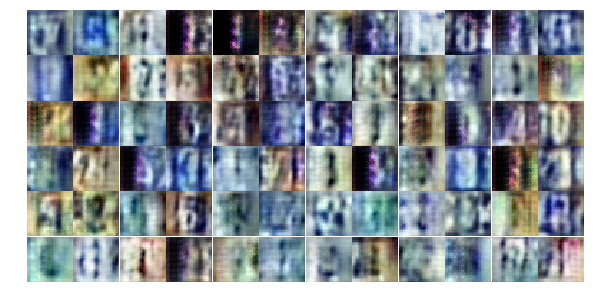

Epoch 18/25... Discriminator Loss: 0.8619... Generator Loss: 1.2077
Epoch 18/25... Discriminator Loss: 0.7522... Generator Loss: 1.3970
Epoch 18/25... Discriminator Loss: 0.9642... Generator Loss: 1.1594
Epoch 18/25... Discriminator Loss: 0.8748... Generator Loss: 1.2446
Epoch 18/25... Discriminator Loss: 0.9922... Generator Loss: 1.4695
Epoch 18/25... Discriminator Loss: 0.9559... Generator Loss: 1.1116
Epoch 18/25... Discriminator Loss: 0.9048... Generator Loss: 1.0965
Epoch 18/25... Discriminator Loss: 0.8867... Generator Loss: 1.8547
Epoch 18/25... Discriminator Loss: 0.5221... Generator Loss: 1.7504
Epoch 18/25... Discriminator Loss: 1.2030... Generator Loss: 0.5856


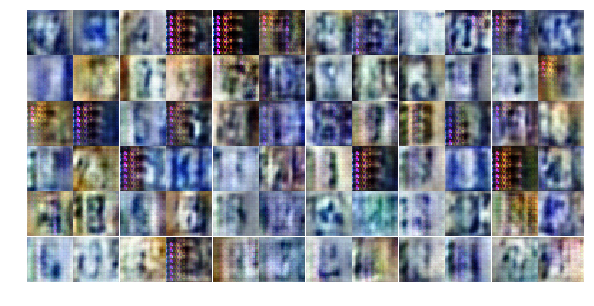

Epoch 18/25... Discriminator Loss: 0.8439... Generator Loss: 1.4448
Epoch 18/25... Discriminator Loss: 0.9270... Generator Loss: 1.5061
Epoch 18/25... Discriminator Loss: 1.0275... Generator Loss: 1.0993
Epoch 18/25... Discriminator Loss: 0.8627... Generator Loss: 1.2793
Epoch 18/25... Discriminator Loss: 0.9072... Generator Loss: 1.1048
Epoch 18/25... Discriminator Loss: 0.8034... Generator Loss: 1.3379
Epoch 18/25... Discriminator Loss: 0.8612... Generator Loss: 1.5480
Epoch 18/25... Discriminator Loss: 0.8052... Generator Loss: 1.3862
Epoch 18/25... Discriminator Loss: 0.7848... Generator Loss: 1.2516
Epoch 18/25... Discriminator Loss: 0.9192... Generator Loss: 1.8495


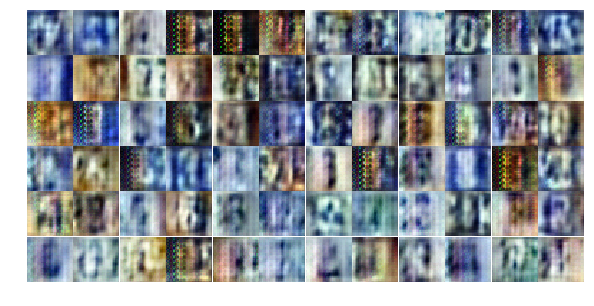

Epoch 18/25... Discriminator Loss: 0.9336... Generator Loss: 1.0633
Epoch 18/25... Discriminator Loss: 0.7877... Generator Loss: 1.6316
Epoch 18/25... Discriminator Loss: 0.8034... Generator Loss: 1.2386
Epoch 18/25... Discriminator Loss: 0.9313... Generator Loss: 1.3834
Epoch 18/25... Discriminator Loss: 0.9088... Generator Loss: 0.9390
Epoch 18/25... Discriminator Loss: 0.9750... Generator Loss: 1.0680
Epoch 18/25... Discriminator Loss: 0.7934... Generator Loss: 1.2110
Epoch 18/25... Discriminator Loss: 1.0859... Generator Loss: 2.3051
Epoch 18/25... Discriminator Loss: 0.8278... Generator Loss: 1.5171
Epoch 18/25... Discriminator Loss: 0.8094... Generator Loss: 1.1449


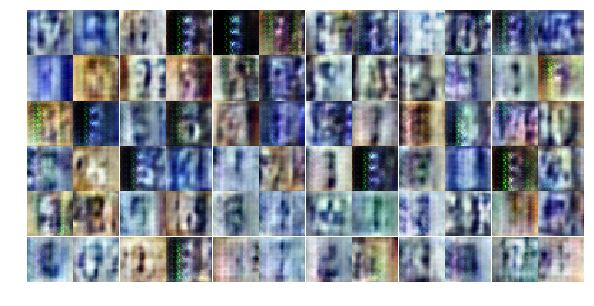

Epoch 18/25... Discriminator Loss: 0.6953... Generator Loss: 1.4483
Epoch 18/25... Discriminator Loss: 0.6835... Generator Loss: 1.5767
Epoch 18/25... Discriminator Loss: 0.9624... Generator Loss: 1.1379
Epoch 18/25... Discriminator Loss: 0.7200... Generator Loss: 1.7725
Epoch 18/25... Discriminator Loss: 0.7244... Generator Loss: 2.9615
Epoch 18/25... Discriminator Loss: 0.6472... Generator Loss: 1.7780
Epoch 18/25... Discriminator Loss: 1.0531... Generator Loss: 2.0473
Epoch 18/25... Discriminator Loss: 0.8630... Generator Loss: 1.3415
Epoch 18/25... Discriminator Loss: 0.9902... Generator Loss: 0.8961
Epoch 18/25... Discriminator Loss: 0.8478... Generator Loss: 1.3786


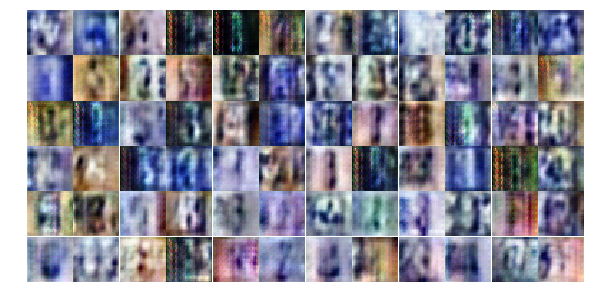

Epoch 18/25... Discriminator Loss: 0.7591... Generator Loss: 1.8125
Epoch 18/25... Discriminator Loss: 0.9709... Generator Loss: 1.0313
Epoch 18/25... Discriminator Loss: 0.7410... Generator Loss: 1.9772
Epoch 18/25... Discriminator Loss: 0.8024... Generator Loss: 1.3004
Epoch 18/25... Discriminator Loss: 0.7516... Generator Loss: 2.7548
Epoch 18/25... Discriminator Loss: 0.8582... Generator Loss: 1.9818
Epoch 18/25... Discriminator Loss: 0.6420... Generator Loss: 1.9864
Epoch 18/25... Discriminator Loss: 2.7453... Generator Loss: 3.6898
Epoch 18/25... Discriminator Loss: 0.8557... Generator Loss: 1.7974
Epoch 18/25... Discriminator Loss: 0.9155... Generator Loss: 1.5494


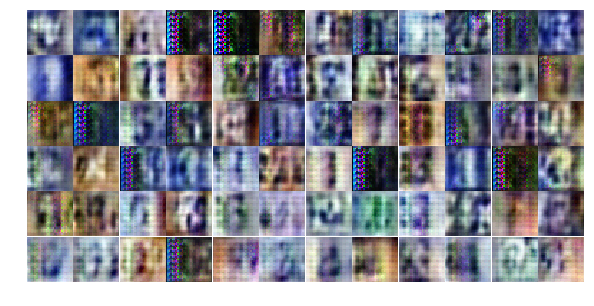

Epoch 18/25... Discriminator Loss: 0.8344... Generator Loss: 1.2151
Epoch 19/25... Discriminator Loss: 0.8506... Generator Loss: 1.3743
Epoch 19/25... Discriminator Loss: 0.8443... Generator Loss: 1.5112
Epoch 19/25... Discriminator Loss: 0.7611... Generator Loss: 1.3902
Epoch 19/25... Discriminator Loss: 0.7318... Generator Loss: 1.5103
Epoch 19/25... Discriminator Loss: 0.6437... Generator Loss: 1.6285
Epoch 19/25... Discriminator Loss: 1.3491... Generator Loss: 2.0517
Epoch 19/25... Discriminator Loss: 0.7945... Generator Loss: 1.3406
Epoch 19/25... Discriminator Loss: 0.6300... Generator Loss: 1.5716
Epoch 19/25... Discriminator Loss: 1.2401... Generator Loss: 2.2763


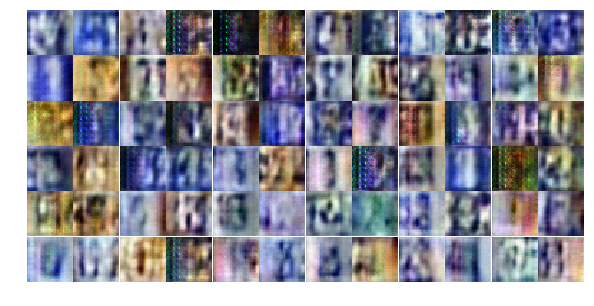

Epoch 19/25... Discriminator Loss: 0.8123... Generator Loss: 1.5241
Epoch 19/25... Discriminator Loss: 0.7657... Generator Loss: 1.6127
Epoch 19/25... Discriminator Loss: 0.7170... Generator Loss: 1.5728
Epoch 19/25... Discriminator Loss: 0.9015... Generator Loss: 0.9056
Epoch 19/25... Discriminator Loss: 0.7188... Generator Loss: 1.2859
Epoch 19/25... Discriminator Loss: 0.9842... Generator Loss: 1.0055
Epoch 19/25... Discriminator Loss: 0.7083... Generator Loss: 1.3090
Epoch 19/25... Discriminator Loss: 0.5742... Generator Loss: 2.5519
Epoch 19/25... Discriminator Loss: 0.6680... Generator Loss: 1.7347
Epoch 19/25... Discriminator Loss: 1.2674... Generator Loss: 1.0536


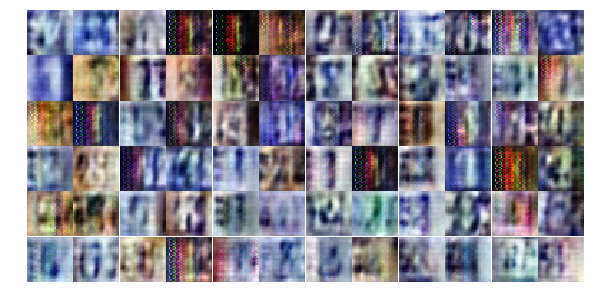

Epoch 19/25... Discriminator Loss: 0.9301... Generator Loss: 1.0196
Epoch 19/25... Discriminator Loss: 0.8689... Generator Loss: 1.5140
Epoch 19/25... Discriminator Loss: 0.8424... Generator Loss: 1.1723
Epoch 19/25... Discriminator Loss: 0.9579... Generator Loss: 0.8742
Epoch 19/25... Discriminator Loss: 0.9825... Generator Loss: 1.7857
Epoch 19/25... Discriminator Loss: 0.8478... Generator Loss: 1.6486
Epoch 19/25... Discriminator Loss: 0.7707... Generator Loss: 1.7604
Epoch 19/25... Discriminator Loss: 0.9630... Generator Loss: 1.2649
Epoch 19/25... Discriminator Loss: 0.7379... Generator Loss: 2.0545
Epoch 19/25... Discriminator Loss: 0.8197... Generator Loss: 1.1395


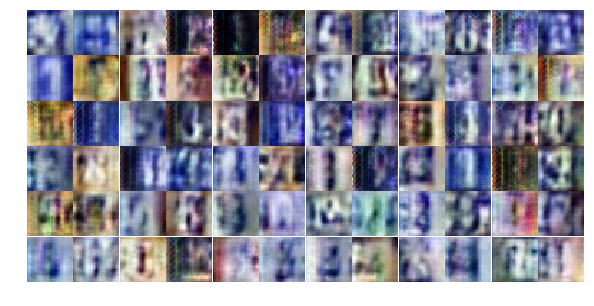

Epoch 19/25... Discriminator Loss: 0.9634... Generator Loss: 1.8432
Epoch 19/25... Discriminator Loss: 0.7657... Generator Loss: 1.2004
Epoch 19/25... Discriminator Loss: 0.7670... Generator Loss: 1.3767
Epoch 19/25... Discriminator Loss: 0.5186... Generator Loss: 1.6645
Epoch 19/25... Discriminator Loss: 4.1448... Generator Loss: 0.2323
Epoch 19/25... Discriminator Loss: 144.6339... Generator Loss: 39.5783
Epoch 19/25... Discriminator Loss: 2.2221... Generator Loss: 26.0951
Epoch 19/25... Discriminator Loss: 3.8045... Generator Loss: 13.9797
Epoch 19/25... Discriminator Loss: 3.0078... Generator Loss: 5.1325
Epoch 19/25... Discriminator Loss: 3.7987... Generator Loss: 19.5702


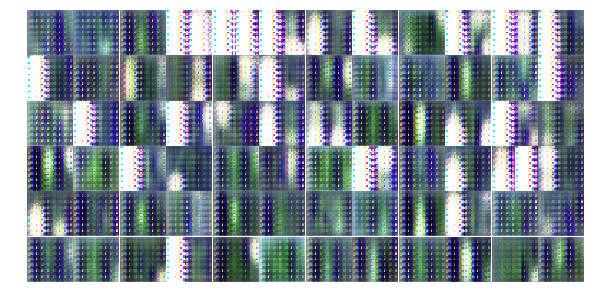

Epoch 19/25... Discriminator Loss: 0.7799... Generator Loss: 9.2555
Epoch 19/25... Discriminator Loss: 0.5002... Generator Loss: 4.5613
Epoch 19/25... Discriminator Loss: 0.6316... Generator Loss: 2.0101
Epoch 19/25... Discriminator Loss: 1.1251... Generator Loss: 11.5646
Epoch 19/25... Discriminator Loss: 0.1810... Generator Loss: 7.1924
Epoch 19/25... Discriminator Loss: 1.1318... Generator Loss: 13.5677
Epoch 19/25... Discriminator Loss: 0.1571... Generator Loss: 6.1835
Epoch 19/25... Discriminator Loss: 3.6998... Generator Loss: 10.3602
Epoch 19/25... Discriminator Loss: 0.9324... Generator Loss: 8.2304
Epoch 19/25... Discriminator Loss: 0.4661... Generator Loss: 3.1640


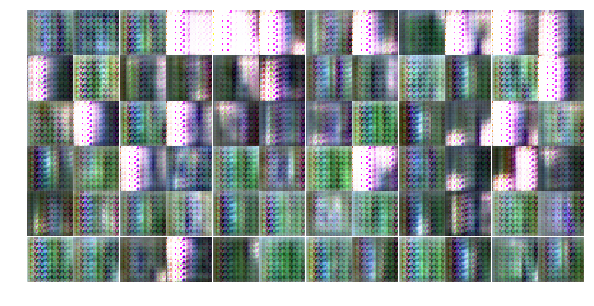

Epoch 19/25... Discriminator Loss: 1.1050... Generator Loss: 6.1464
Epoch 19/25... Discriminator Loss: 0.3227... Generator Loss: 4.3855
Epoch 19/25... Discriminator Loss: 0.3602... Generator Loss: 3.9699
Epoch 19/25... Discriminator Loss: 1.0341... Generator Loss: 2.9727
Epoch 19/25... Discriminator Loss: 0.3821... Generator Loss: 3.6625
Epoch 19/25... Discriminator Loss: 0.6884... Generator Loss: 5.1715
Epoch 19/25... Discriminator Loss: 2.2403... Generator Loss: 8.0851
Epoch 19/25... Discriminator Loss: 0.4624... Generator Loss: 2.6203
Epoch 20/25... Discriminator Loss: 0.8185... Generator Loss: 5.5586
Epoch 20/25... Discriminator Loss: 0.6286... Generator Loss: 3.5926


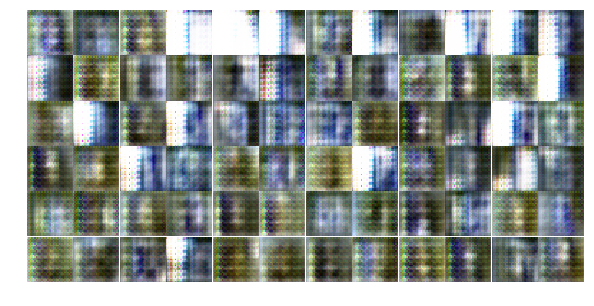

Epoch 20/25... Discriminator Loss: 0.2735... Generator Loss: 4.3473
Epoch 20/25... Discriminator Loss: 0.4950... Generator Loss: 2.9605
Epoch 20/25... Discriminator Loss: 0.6623... Generator Loss: 2.1327
Epoch 20/25... Discriminator Loss: 0.2268... Generator Loss: 3.8185
Epoch 20/25... Discriminator Loss: 0.7204... Generator Loss: 4.6550
Epoch 20/25... Discriminator Loss: 0.5338... Generator Loss: 2.5784
Epoch 20/25... Discriminator Loss: 0.2916... Generator Loss: 5.4068
Epoch 20/25... Discriminator Loss: 0.8791... Generator Loss: 2.0581
Epoch 20/25... Discriminator Loss: 0.7106... Generator Loss: 1.8502
Epoch 20/25... Discriminator Loss: 0.7420... Generator Loss: 6.5036


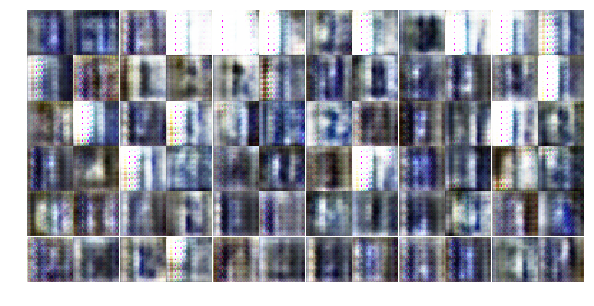

Epoch 20/25... Discriminator Loss: 1.0451... Generator Loss: 4.1779
Epoch 20/25... Discriminator Loss: 0.5533... Generator Loss: 2.5293
Epoch 20/25... Discriminator Loss: 0.6800... Generator Loss: 1.9333
Epoch 20/25... Discriminator Loss: 0.5939... Generator Loss: 2.4395
Epoch 20/25... Discriminator Loss: 0.7990... Generator Loss: 4.5250
Epoch 20/25... Discriminator Loss: 0.6419... Generator Loss: 2.3656
Epoch 20/25... Discriminator Loss: 0.5673... Generator Loss: 1.9388
Epoch 20/25... Discriminator Loss: 0.3557... Generator Loss: 2.9751
Epoch 20/25... Discriminator Loss: 0.6263... Generator Loss: 1.6830
Epoch 20/25... Discriminator Loss: 0.3563... Generator Loss: 2.5504


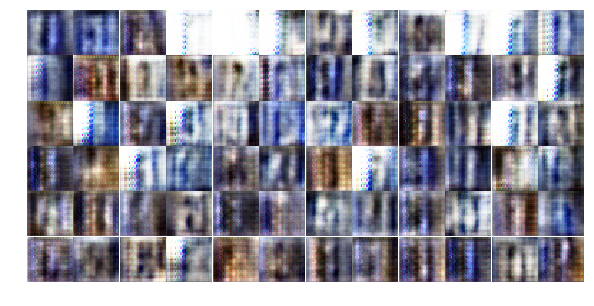

Epoch 20/25... Discriminator Loss: 0.8978... Generator Loss: 3.0713
Epoch 20/25... Discriminator Loss: 0.6780... Generator Loss: 1.7609
Epoch 20/25... Discriminator Loss: 0.8962... Generator Loss: 1.2820
Epoch 20/25... Discriminator Loss: 0.9371... Generator Loss: 3.2249
Epoch 20/25... Discriminator Loss: 0.6716... Generator Loss: 1.6591
Epoch 20/25... Discriminator Loss: 0.8672... Generator Loss: 1.9223
Epoch 20/25... Discriminator Loss: 1.3122... Generator Loss: 4.0803
Epoch 20/25... Discriminator Loss: 1.4447... Generator Loss: 3.4183
Epoch 20/25... Discriminator Loss: 0.8312... Generator Loss: 1.9142
Epoch 20/25... Discriminator Loss: 0.3901... Generator Loss: 3.0329


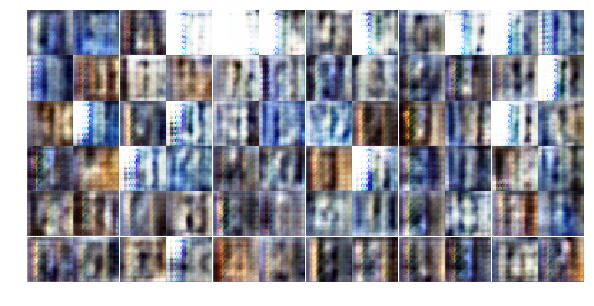

Epoch 20/25... Discriminator Loss: 0.5452... Generator Loss: 4.0261
Epoch 20/25... Discriminator Loss: 0.8749... Generator Loss: 2.4437
Epoch 20/25... Discriminator Loss: 0.5280... Generator Loss: 3.6261
Epoch 20/25... Discriminator Loss: 0.9732... Generator Loss: 1.5460
Epoch 20/25... Discriminator Loss: 0.7044... Generator Loss: 1.6874
Epoch 20/25... Discriminator Loss: 0.7832... Generator Loss: 1.6060
Epoch 20/25... Discriminator Loss: 1.8046... Generator Loss: 4.2372
Epoch 20/25... Discriminator Loss: 0.5306... Generator Loss: 2.4140
Epoch 20/25... Discriminator Loss: 0.6300... Generator Loss: 2.4274
Epoch 20/25... Discriminator Loss: 0.6207... Generator Loss: 5.0323


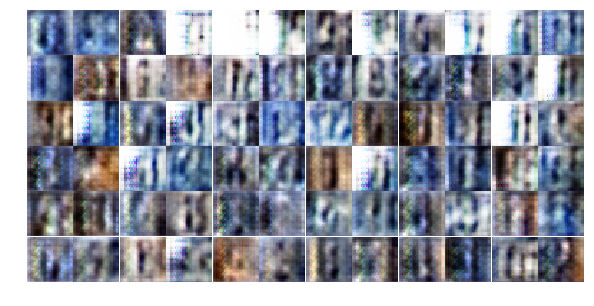

Epoch 20/25... Discriminator Loss: 0.8314... Generator Loss: 1.4879
Epoch 20/25... Discriminator Loss: 1.3974... Generator Loss: 1.1822
Epoch 20/25... Discriminator Loss: 0.6486... Generator Loss: 2.0980
Epoch 20/25... Discriminator Loss: 0.7177... Generator Loss: 2.2169
Epoch 20/25... Discriminator Loss: 0.6534... Generator Loss: 1.3868
Epoch 20/25... Discriminator Loss: 0.6261... Generator Loss: 1.4545
Epoch 20/25... Discriminator Loss: 0.7328... Generator Loss: 2.4000
Epoch 20/25... Discriminator Loss: 0.7487... Generator Loss: 2.0311
Epoch 20/25... Discriminator Loss: 0.9429... Generator Loss: 1.9304
Epoch 20/25... Discriminator Loss: 0.6677... Generator Loss: 2.1264


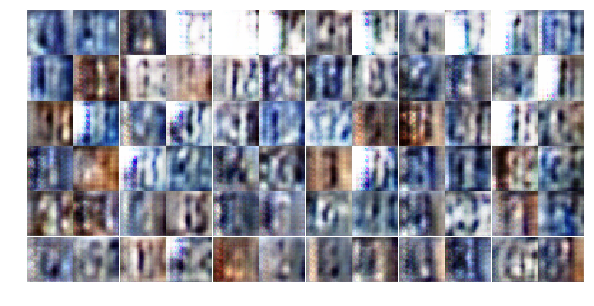

Epoch 20/25... Discriminator Loss: 0.7690... Generator Loss: 1.1627
Epoch 20/25... Discriminator Loss: 1.4292... Generator Loss: 2.6947
Epoch 20/25... Discriminator Loss: 0.9689... Generator Loss: 1.4934
Epoch 20/25... Discriminator Loss: 0.4682... Generator Loss: 3.9482
Epoch 20/25... Discriminator Loss: 1.0723... Generator Loss: 3.2962
Epoch 20/25... Discriminator Loss: 0.2864... Generator Loss: 3.3173
Epoch 21/25... Discriminator Loss: 0.8789... Generator Loss: 1.3053
Epoch 21/25... Discriminator Loss: 0.7987... Generator Loss: 1.4957
Epoch 21/25... Discriminator Loss: 1.0509... Generator Loss: 1.2482
Epoch 21/25... Discriminator Loss: 0.5989... Generator Loss: 1.9932


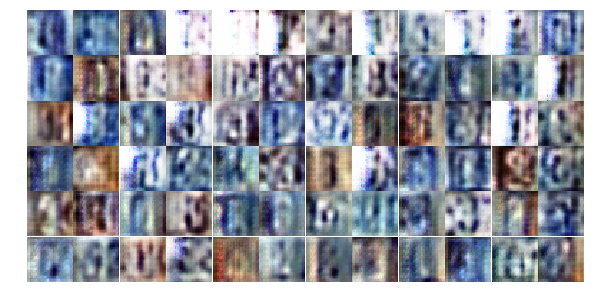

Epoch 21/25... Discriminator Loss: 0.5236... Generator Loss: 3.1083
Epoch 21/25... Discriminator Loss: 0.7928... Generator Loss: 2.1924
Epoch 21/25... Discriminator Loss: 0.5492... Generator Loss: 3.0864
Epoch 21/25... Discriminator Loss: 0.6141... Generator Loss: 2.4247
Epoch 21/25... Discriminator Loss: 0.7987... Generator Loss: 2.1200
Epoch 21/25... Discriminator Loss: 0.8404... Generator Loss: 1.5715
Epoch 21/25... Discriminator Loss: 0.7228... Generator Loss: 1.5450
Epoch 21/25... Discriminator Loss: 0.9087... Generator Loss: 2.8955
Epoch 21/25... Discriminator Loss: 0.7315... Generator Loss: 1.7816
Epoch 21/25... Discriminator Loss: 0.6572... Generator Loss: 1.7736


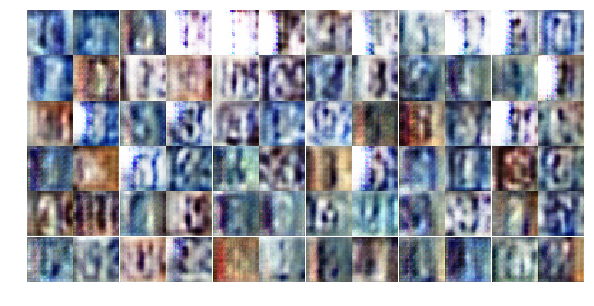

Epoch 21/25... Discriminator Loss: 0.6924... Generator Loss: 2.0113
Epoch 21/25... Discriminator Loss: 0.8283... Generator Loss: 1.5105
Epoch 21/25... Discriminator Loss: 0.7289... Generator Loss: 1.9634
Epoch 21/25... Discriminator Loss: 0.5334... Generator Loss: 2.0549
Epoch 21/25... Discriminator Loss: 0.8906... Generator Loss: 1.2153
Epoch 21/25... Discriminator Loss: 0.7634... Generator Loss: 1.2039
Epoch 21/25... Discriminator Loss: 1.0439... Generator Loss: 1.8160
Epoch 21/25... Discriminator Loss: 0.8531... Generator Loss: 1.8924
Epoch 21/25... Discriminator Loss: 0.8857... Generator Loss: 1.7820
Epoch 21/25... Discriminator Loss: 0.6475... Generator Loss: 2.1064


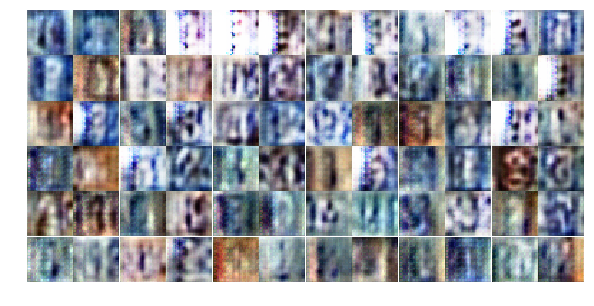

Epoch 21/25... Discriminator Loss: 0.8656... Generator Loss: 1.5169
Epoch 21/25... Discriminator Loss: 0.7774... Generator Loss: 1.9523
Epoch 21/25... Discriminator Loss: 1.2082... Generator Loss: 1.5850
Epoch 21/25... Discriminator Loss: 0.7997... Generator Loss: 1.9499
Epoch 21/25... Discriminator Loss: 0.7391... Generator Loss: 2.2676
Epoch 21/25... Discriminator Loss: 0.8086... Generator Loss: 2.0033
Epoch 21/25... Discriminator Loss: 0.6205... Generator Loss: 2.1688
Epoch 21/25... Discriminator Loss: 1.1225... Generator Loss: 1.3668
Epoch 21/25... Discriminator Loss: 0.7101... Generator Loss: 2.0463
Epoch 21/25... Discriminator Loss: 0.7533... Generator Loss: 2.0746


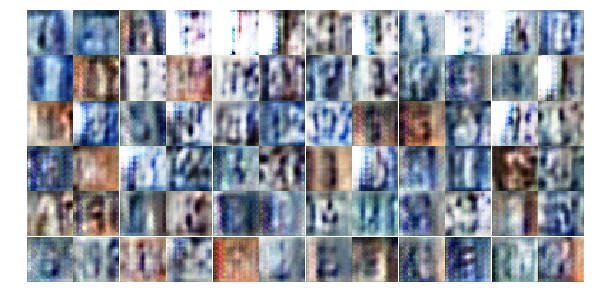

Epoch 21/25... Discriminator Loss: 0.8527... Generator Loss: 2.1582
Epoch 21/25... Discriminator Loss: 0.6305... Generator Loss: 1.7363
Epoch 21/25... Discriminator Loss: 0.7562... Generator Loss: 2.0361
Epoch 21/25... Discriminator Loss: 0.7824... Generator Loss: 1.2977
Epoch 21/25... Discriminator Loss: 0.7302... Generator Loss: 2.4122
Epoch 21/25... Discriminator Loss: 0.7467... Generator Loss: 1.7773
Epoch 21/25... Discriminator Loss: 0.6452... Generator Loss: 1.7033
Epoch 21/25... Discriminator Loss: 0.7730... Generator Loss: 1.5599
Epoch 21/25... Discriminator Loss: 0.7331... Generator Loss: 1.5293
Epoch 21/25... Discriminator Loss: 0.7868... Generator Loss: 2.6145


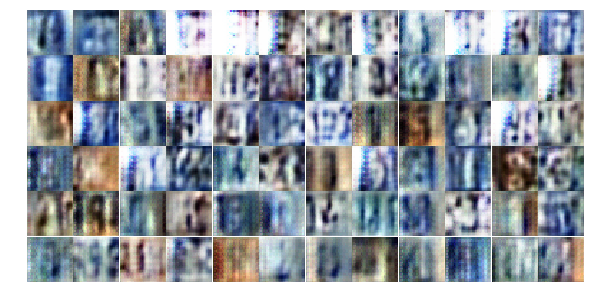

Epoch 21/25... Discriminator Loss: 0.9031... Generator Loss: 1.3509
Epoch 21/25... Discriminator Loss: 0.8744... Generator Loss: 1.5194
Epoch 21/25... Discriminator Loss: 1.1298... Generator Loss: 3.3208
Epoch 21/25... Discriminator Loss: 0.6952... Generator Loss: 1.6287
Epoch 21/25... Discriminator Loss: 0.6321... Generator Loss: 1.8126
Epoch 21/25... Discriminator Loss: 0.7968... Generator Loss: 1.2410
Epoch 21/25... Discriminator Loss: 0.7767... Generator Loss: 1.6173
Epoch 21/25... Discriminator Loss: 0.8218... Generator Loss: 1.6247
Epoch 21/25... Discriminator Loss: 0.9252... Generator Loss: 1.8181
Epoch 21/25... Discriminator Loss: 0.9323... Generator Loss: 2.1878


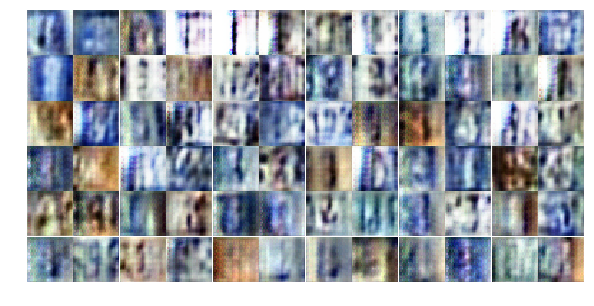

Epoch 21/25... Discriminator Loss: 0.6129... Generator Loss: 2.5794
Epoch 21/25... Discriminator Loss: 0.8936... Generator Loss: 1.5812
Epoch 21/25... Discriminator Loss: 0.5878... Generator Loss: 1.9496
Epoch 22/25... Discriminator Loss: 0.8213... Generator Loss: 1.8742
Epoch 22/25... Discriminator Loss: 0.6487... Generator Loss: 1.7079
Epoch 22/25... Discriminator Loss: 0.8212... Generator Loss: 1.3868
Epoch 22/25... Discriminator Loss: 0.7949... Generator Loss: 1.3171
Epoch 22/25... Discriminator Loss: 0.8054... Generator Loss: 1.3520
Epoch 22/25... Discriminator Loss: 0.7704... Generator Loss: 1.4264
Epoch 22/25... Discriminator Loss: 0.7512... Generator Loss: 1.8173


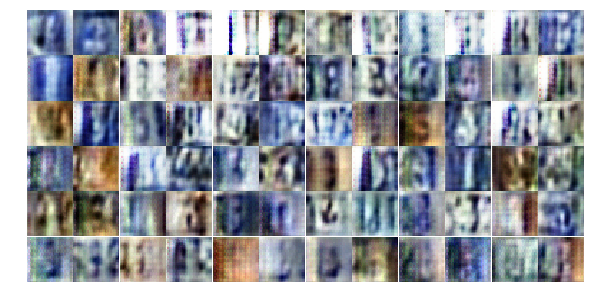

Epoch 22/25... Discriminator Loss: 0.8373... Generator Loss: 1.4291
Epoch 22/25... Discriminator Loss: 0.6260... Generator Loss: 1.8429
Epoch 22/25... Discriminator Loss: 0.7753... Generator Loss: 1.6158
Epoch 22/25... Discriminator Loss: 0.9120... Generator Loss: 1.1389
Epoch 22/25... Discriminator Loss: 0.9644... Generator Loss: 1.2410
Epoch 22/25... Discriminator Loss: 0.9126... Generator Loss: 1.3731
Epoch 22/25... Discriminator Loss: 0.8667... Generator Loss: 1.2328
Epoch 22/25... Discriminator Loss: 0.7353... Generator Loss: 2.0019
Epoch 22/25... Discriminator Loss: 0.9340... Generator Loss: 1.6053
Epoch 22/25... Discriminator Loss: 0.7856... Generator Loss: 2.1180


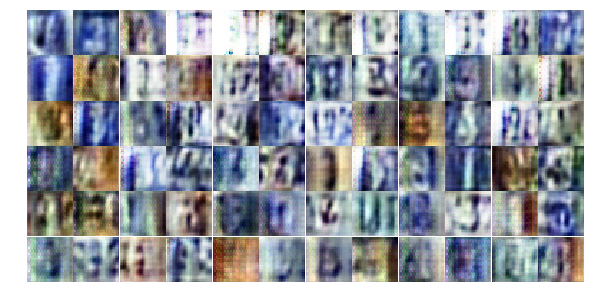

Epoch 22/25... Discriminator Loss: 0.6035... Generator Loss: 1.6396
Epoch 22/25... Discriminator Loss: 0.7580... Generator Loss: 1.4796
Epoch 22/25... Discriminator Loss: 0.8764... Generator Loss: 1.3300
Epoch 22/25... Discriminator Loss: 0.5725... Generator Loss: 1.8363
Epoch 22/25... Discriminator Loss: 0.8389... Generator Loss: 1.3709
Epoch 22/25... Discriminator Loss: 0.7551... Generator Loss: 1.3622
Epoch 22/25... Discriminator Loss: 0.7305... Generator Loss: 1.4289
Epoch 22/25... Discriminator Loss: 0.8307... Generator Loss: 1.4622
Epoch 22/25... Discriminator Loss: 0.6756... Generator Loss: 1.9269
Epoch 22/25... Discriminator Loss: 1.4317... Generator Loss: 1.9942


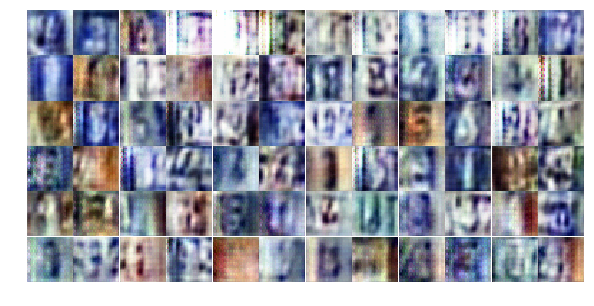

Epoch 22/25... Discriminator Loss: 0.6972... Generator Loss: 1.7644
Epoch 22/25... Discriminator Loss: 0.8038... Generator Loss: 1.7463
Epoch 22/25... Discriminator Loss: 0.7014... Generator Loss: 1.6247
Epoch 22/25... Discriminator Loss: 0.7434... Generator Loss: 1.4722
Epoch 22/25... Discriminator Loss: 0.8315... Generator Loss: 1.4120
Epoch 22/25... Discriminator Loss: 1.0994... Generator Loss: 1.0263
Epoch 22/25... Discriminator Loss: 0.9362... Generator Loss: 1.2551
Epoch 22/25... Discriminator Loss: 0.8463... Generator Loss: 1.4367
Epoch 22/25... Discriminator Loss: 0.8421... Generator Loss: 1.4549
Epoch 22/25... Discriminator Loss: 0.7711... Generator Loss: 2.3536


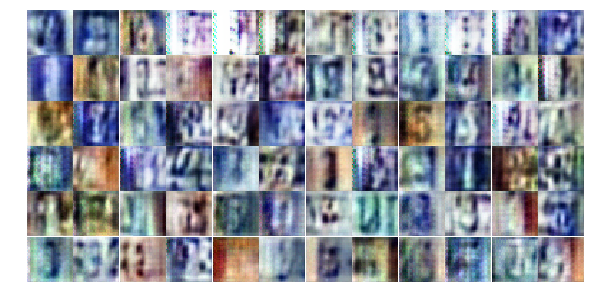

Epoch 22/25... Discriminator Loss: 0.8854... Generator Loss: 1.9865
Epoch 22/25... Discriminator Loss: 0.6395... Generator Loss: 1.9219
Epoch 22/25... Discriminator Loss: 0.9237... Generator Loss: 1.5666
Epoch 22/25... Discriminator Loss: 0.6004... Generator Loss: 1.8013
Epoch 22/25... Discriminator Loss: 0.9358... Generator Loss: 0.8822
Epoch 22/25... Discriminator Loss: 0.7366... Generator Loss: 1.3315
Epoch 22/25... Discriminator Loss: 0.9196... Generator Loss: 1.1651
Epoch 22/25... Discriminator Loss: 0.7369... Generator Loss: 1.2627
Epoch 22/25... Discriminator Loss: 1.1013... Generator Loss: 1.2197
Epoch 22/25... Discriminator Loss: 0.8148... Generator Loss: 1.4768


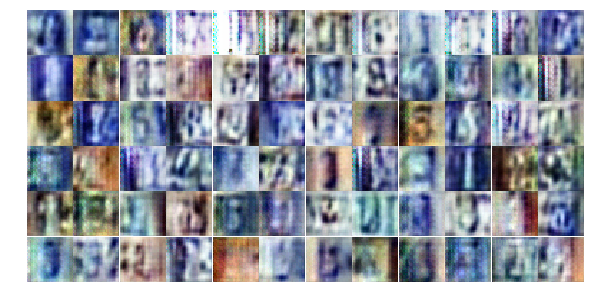

Epoch 22/25... Discriminator Loss: 0.7371... Generator Loss: 1.3271
Epoch 22/25... Discriminator Loss: 0.7418... Generator Loss: 1.5656
Epoch 22/25... Discriminator Loss: 1.0219... Generator Loss: 1.1206
Epoch 22/25... Discriminator Loss: 0.7781... Generator Loss: 1.3787
Epoch 22/25... Discriminator Loss: 0.7912... Generator Loss: 1.7140
Epoch 22/25... Discriminator Loss: 0.6530... Generator Loss: 2.2261
Epoch 22/25... Discriminator Loss: 0.7915... Generator Loss: 1.4695
Epoch 22/25... Discriminator Loss: 0.8094... Generator Loss: 1.6454
Epoch 22/25... Discriminator Loss: 0.7303... Generator Loss: 1.6661
Epoch 22/25... Discriminator Loss: 0.7381... Generator Loss: 1.5154


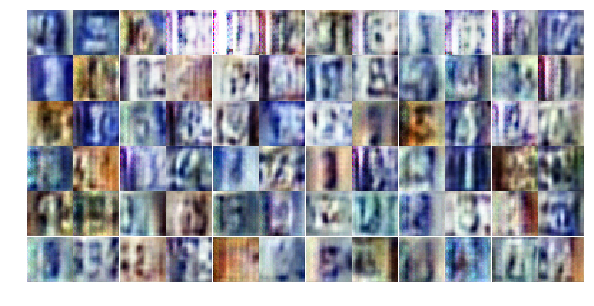

Epoch 23/25... Discriminator Loss: 1.0932... Generator Loss: 1.6928
Epoch 23/25... Discriminator Loss: 0.8177... Generator Loss: 1.4368
Epoch 23/25... Discriminator Loss: 0.8842... Generator Loss: 1.4345
Epoch 23/25... Discriminator Loss: 0.8264... Generator Loss: 1.5671
Epoch 23/25... Discriminator Loss: 0.7505... Generator Loss: 1.5978
Epoch 23/25... Discriminator Loss: 1.1220... Generator Loss: 2.1128
Epoch 23/25... Discriminator Loss: 0.8489... Generator Loss: 1.1285
Epoch 23/25... Discriminator Loss: 1.0991... Generator Loss: 1.2486
Epoch 23/25... Discriminator Loss: 0.7786... Generator Loss: 1.3167
Epoch 23/25... Discriminator Loss: 1.0335... Generator Loss: 1.8691


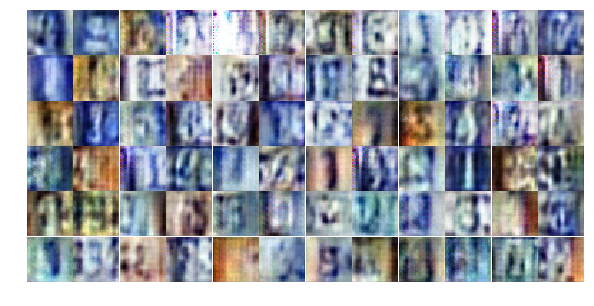

Epoch 23/25... Discriminator Loss: 0.8103... Generator Loss: 1.3306
Epoch 23/25... Discriminator Loss: 0.7421... Generator Loss: 1.9309
Epoch 23/25... Discriminator Loss: 0.8108... Generator Loss: 1.4156
Epoch 23/25... Discriminator Loss: 0.8785... Generator Loss: 1.6379
Epoch 23/25... Discriminator Loss: 1.0794... Generator Loss: 0.9898
Epoch 23/25... Discriminator Loss: 0.8580... Generator Loss: 1.4302
Epoch 23/25... Discriminator Loss: 1.0869... Generator Loss: 0.9623
Epoch 23/25... Discriminator Loss: 0.7474... Generator Loss: 1.6425
Epoch 23/25... Discriminator Loss: 1.2017... Generator Loss: 0.9020
Epoch 23/25... Discriminator Loss: 0.9499... Generator Loss: 1.1396


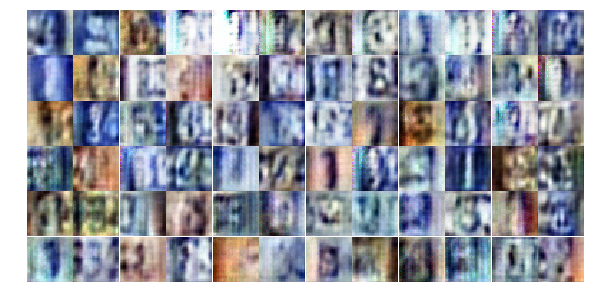

Epoch 23/25... Discriminator Loss: 0.8234... Generator Loss: 1.6691
Epoch 23/25... Discriminator Loss: 0.5768... Generator Loss: 2.0495
Epoch 23/25... Discriminator Loss: 1.1871... Generator Loss: 0.8778
Epoch 23/25... Discriminator Loss: 0.8381... Generator Loss: 1.3409
Epoch 23/25... Discriminator Loss: 0.6943... Generator Loss: 1.7261
Epoch 23/25... Discriminator Loss: 0.6622... Generator Loss: 2.0603
Epoch 23/25... Discriminator Loss: 0.7412... Generator Loss: 1.4864
Epoch 23/25... Discriminator Loss: 0.7430... Generator Loss: 1.5686
Epoch 23/25... Discriminator Loss: 0.9068... Generator Loss: 1.0063
Epoch 23/25... Discriminator Loss: 0.9222... Generator Loss: 1.6715


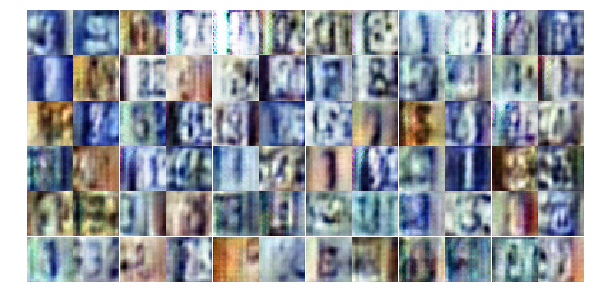

Epoch 23/25... Discriminator Loss: 0.8108... Generator Loss: 1.3062
Epoch 23/25... Discriminator Loss: 0.7973... Generator Loss: 1.2588
Epoch 23/25... Discriminator Loss: 0.6306... Generator Loss: 1.7007
Epoch 23/25... Discriminator Loss: 0.9924... Generator Loss: 0.8379
Epoch 23/25... Discriminator Loss: 0.9351... Generator Loss: 1.0613
Epoch 23/25... Discriminator Loss: 0.8741... Generator Loss: 1.3495
Epoch 23/25... Discriminator Loss: 0.7712... Generator Loss: 1.4410
Epoch 23/25... Discriminator Loss: 0.8997... Generator Loss: 1.8050
Epoch 23/25... Discriminator Loss: 0.8487... Generator Loss: 1.2759
Epoch 23/25... Discriminator Loss: 0.8563... Generator Loss: 1.4913


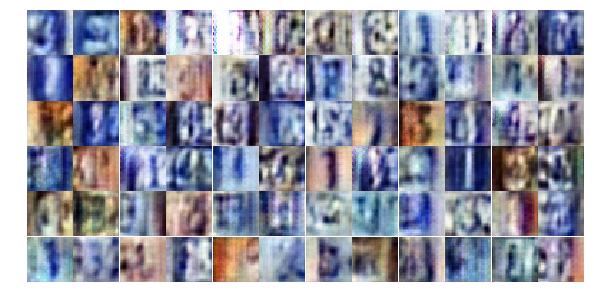

Epoch 23/25... Discriminator Loss: 0.7825... Generator Loss: 1.5461
Epoch 23/25... Discriminator Loss: 0.7565... Generator Loss: 1.5690
Epoch 23/25... Discriminator Loss: 0.7487... Generator Loss: 1.6041
Epoch 23/25... Discriminator Loss: 0.7922... Generator Loss: 1.4652
Epoch 23/25... Discriminator Loss: 0.9815... Generator Loss: 1.1951
Epoch 23/25... Discriminator Loss: 0.9309... Generator Loss: 1.1399
Epoch 23/25... Discriminator Loss: 0.9680... Generator Loss: 1.1934
Epoch 23/25... Discriminator Loss: 0.7849... Generator Loss: 1.8974
Epoch 23/25... Discriminator Loss: 0.9019... Generator Loss: 1.1984
Epoch 23/25... Discriminator Loss: 0.8092... Generator Loss: 1.6690


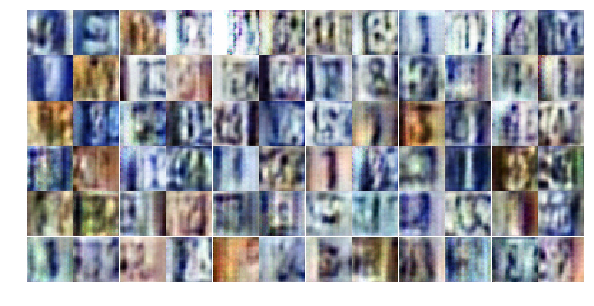

Epoch 23/25... Discriminator Loss: 0.9304... Generator Loss: 1.1732
Epoch 23/25... Discriminator Loss: 0.8127... Generator Loss: 1.1928
Epoch 23/25... Discriminator Loss: 0.9132... Generator Loss: 1.0887
Epoch 23/25... Discriminator Loss: 0.8582... Generator Loss: 1.1428
Epoch 23/25... Discriminator Loss: 0.9076... Generator Loss: 1.8337
Epoch 23/25... Discriminator Loss: 1.0097... Generator Loss: 1.7501
Epoch 23/25... Discriminator Loss: 0.8169... Generator Loss: 1.3027
Epoch 24/25... Discriminator Loss: 0.9846... Generator Loss: 1.1765
Epoch 24/25... Discriminator Loss: 0.9108... Generator Loss: 1.3347
Epoch 24/25... Discriminator Loss: 0.8186... Generator Loss: 1.2552


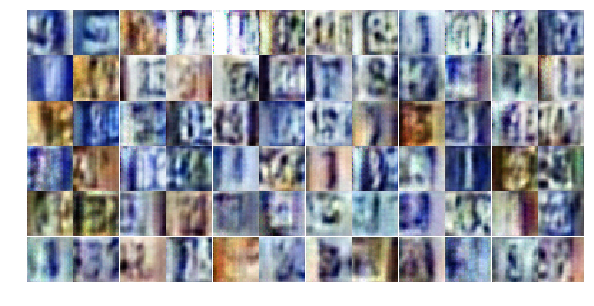

Epoch 24/25... Discriminator Loss: 0.9357... Generator Loss: 1.7389
Epoch 24/25... Discriminator Loss: 0.9457... Generator Loss: 1.2570
Epoch 24/25... Discriminator Loss: 0.7707... Generator Loss: 1.1931
Epoch 24/25... Discriminator Loss: 0.9012... Generator Loss: 1.3025
Epoch 24/25... Discriminator Loss: 1.0676... Generator Loss: 1.3746
Epoch 24/25... Discriminator Loss: 0.8205... Generator Loss: 1.2957
Epoch 24/25... Discriminator Loss: 0.9757... Generator Loss: 1.1213
Epoch 24/25... Discriminator Loss: 1.0894... Generator Loss: 0.8890
Epoch 24/25... Discriminator Loss: 0.9488... Generator Loss: 1.0812
Epoch 24/25... Discriminator Loss: 0.8124... Generator Loss: 1.5479


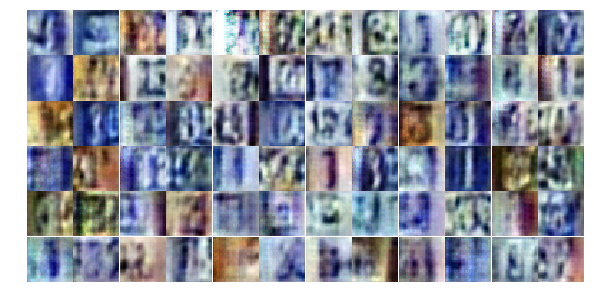

Epoch 24/25... Discriminator Loss: 0.9129... Generator Loss: 1.2485
Epoch 24/25... Discriminator Loss: 0.8099... Generator Loss: 1.2724
Epoch 24/25... Discriminator Loss: 0.9221... Generator Loss: 1.0634
Epoch 24/25... Discriminator Loss: 0.8763... Generator Loss: 1.1928
Epoch 24/25... Discriminator Loss: 0.9749... Generator Loss: 1.6829
Epoch 24/25... Discriminator Loss: 0.8133... Generator Loss: 1.2157
Epoch 24/25... Discriminator Loss: 0.8586... Generator Loss: 1.5195
Epoch 24/25... Discriminator Loss: 0.7673... Generator Loss: 1.4484
Epoch 24/25... Discriminator Loss: 0.8184... Generator Loss: 1.5877
Epoch 24/25... Discriminator Loss: 0.9499... Generator Loss: 0.9516


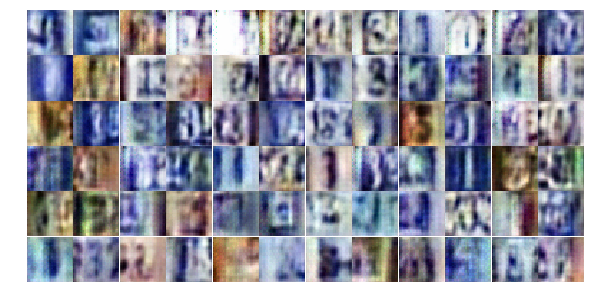

Epoch 24/25... Discriminator Loss: 0.9196... Generator Loss: 1.3150
Epoch 24/25... Discriminator Loss: 0.8520... Generator Loss: 1.4708
Epoch 24/25... Discriminator Loss: 0.7533... Generator Loss: 1.5230
Epoch 24/25... Discriminator Loss: 0.8051... Generator Loss: 1.3652
Epoch 24/25... Discriminator Loss: 0.9358... Generator Loss: 1.1619
Epoch 24/25... Discriminator Loss: 0.9151... Generator Loss: 1.7284
Epoch 24/25... Discriminator Loss: 0.9099... Generator Loss: 1.1254
Epoch 24/25... Discriminator Loss: 0.8456... Generator Loss: 1.3319
Epoch 24/25... Discriminator Loss: 0.7944... Generator Loss: 1.3565
Epoch 24/25... Discriminator Loss: 0.8146... Generator Loss: 1.6156


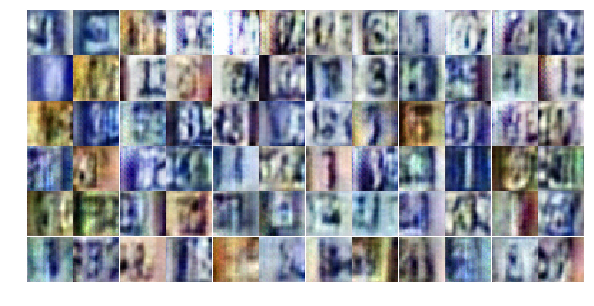

Epoch 24/25... Discriminator Loss: 0.9537... Generator Loss: 2.3698
Epoch 24/25... Discriminator Loss: 0.8396... Generator Loss: 1.2630
Epoch 24/25... Discriminator Loss: 0.8937... Generator Loss: 1.1386
Epoch 24/25... Discriminator Loss: 0.7089... Generator Loss: 1.6677
Epoch 24/25... Discriminator Loss: 0.8917... Generator Loss: 1.3095
Epoch 24/25... Discriminator Loss: 0.9218... Generator Loss: 1.3888
Epoch 24/25... Discriminator Loss: 0.7641... Generator Loss: 1.3273
Epoch 24/25... Discriminator Loss: 0.9116... Generator Loss: 2.1755
Epoch 24/25... Discriminator Loss: 0.9602... Generator Loss: 1.5038
Epoch 24/25... Discriminator Loss: 0.8048... Generator Loss: 1.4048


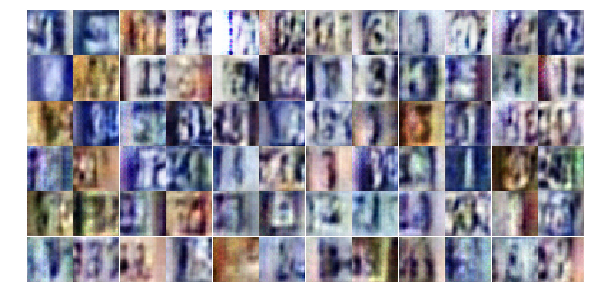

Epoch 24/25... Discriminator Loss: 0.9557... Generator Loss: 1.1777
Epoch 24/25... Discriminator Loss: 0.9707... Generator Loss: 0.9287
Epoch 24/25... Discriminator Loss: 1.0289... Generator Loss: 1.0361
Epoch 24/25... Discriminator Loss: 0.7948... Generator Loss: 1.8843
Epoch 24/25... Discriminator Loss: 0.8776... Generator Loss: 1.4632
Epoch 24/25... Discriminator Loss: 1.0673... Generator Loss: 1.1231
Epoch 24/25... Discriminator Loss: 0.8137... Generator Loss: 1.5383
Epoch 24/25... Discriminator Loss: 0.8831... Generator Loss: 1.1988
Epoch 24/25... Discriminator Loss: 0.8268... Generator Loss: 1.2687
Epoch 24/25... Discriminator Loss: 0.9076... Generator Loss: 1.1355


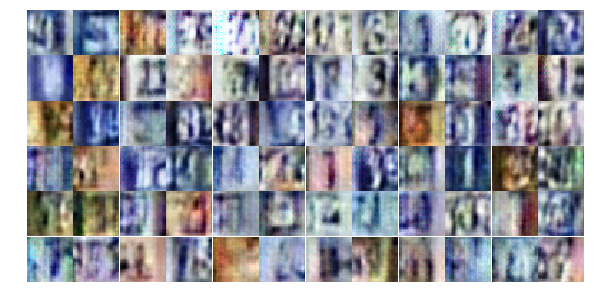

Epoch 24/25... Discriminator Loss: 0.8157... Generator Loss: 1.2574
Epoch 24/25... Discriminator Loss: 0.9592... Generator Loss: 1.3501
Epoch 24/25... Discriminator Loss: 1.0177... Generator Loss: 1.2098
Epoch 24/25... Discriminator Loss: 1.0045... Generator Loss: 0.9450
Epoch 24/25... Discriminator Loss: 0.8555... Generator Loss: 1.4220
Epoch 25/25... Discriminator Loss: 0.8921... Generator Loss: 0.9777
Epoch 25/25... Discriminator Loss: 0.9450... Generator Loss: 1.6435
Epoch 25/25... Discriminator Loss: 0.8878... Generator Loss: 1.1389
Epoch 25/25... Discriminator Loss: 0.8750... Generator Loss: 1.2827
Epoch 25/25... Discriminator Loss: 0.8631... Generator Loss: 1.4198


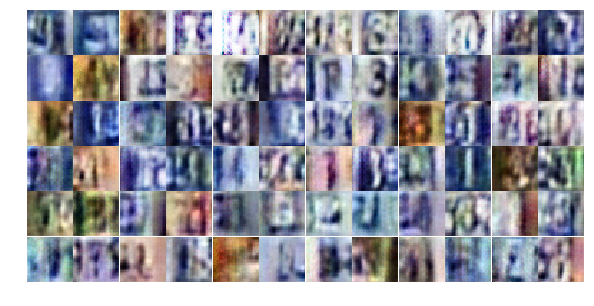

Epoch 25/25... Discriminator Loss: 0.8047... Generator Loss: 1.2215
Epoch 25/25... Discriminator Loss: 0.9987... Generator Loss: 1.1776
Epoch 25/25... Discriminator Loss: 0.9133... Generator Loss: 1.2657
Epoch 25/25... Discriminator Loss: 0.8314... Generator Loss: 1.4030
Epoch 25/25... Discriminator Loss: 0.8675... Generator Loss: 1.0381
Epoch 25/25... Discriminator Loss: 0.9070... Generator Loss: 1.0775
Epoch 25/25... Discriminator Loss: 1.0017... Generator Loss: 1.5645
Epoch 25/25... Discriminator Loss: 0.8589... Generator Loss: 1.5989
Epoch 25/25... Discriminator Loss: 0.8735... Generator Loss: 1.7097
Epoch 25/25... Discriminator Loss: 0.9232... Generator Loss: 1.0036


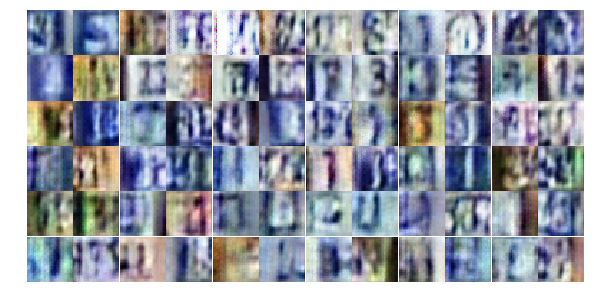

Epoch 25/25... Discriminator Loss: 0.9766... Generator Loss: 0.9971
Epoch 25/25... Discriminator Loss: 1.0323... Generator Loss: 0.9442
Epoch 25/25... Discriminator Loss: 0.7422... Generator Loss: 1.4921
Epoch 25/25... Discriminator Loss: 0.9917... Generator Loss: 1.4994
Epoch 25/25... Discriminator Loss: 0.8040... Generator Loss: 1.2890
Epoch 25/25... Discriminator Loss: 0.9077... Generator Loss: 1.6048
Epoch 25/25... Discriminator Loss: 0.9543... Generator Loss: 1.6705
Epoch 25/25... Discriminator Loss: 1.0818... Generator Loss: 0.9987
Epoch 25/25... Discriminator Loss: 0.9090... Generator Loss: 1.2169
Epoch 25/25... Discriminator Loss: 0.8588... Generator Loss: 1.2222


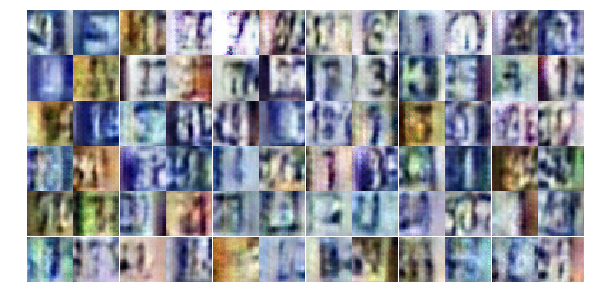

Epoch 25/25... Discriminator Loss: 1.0655... Generator Loss: 1.5899
Epoch 25/25... Discriminator Loss: 0.7057... Generator Loss: 1.2896
Epoch 25/25... Discriminator Loss: 0.9825... Generator Loss: 1.0339
Epoch 25/25... Discriminator Loss: 0.9385... Generator Loss: 1.3928
Epoch 25/25... Discriminator Loss: 0.8960... Generator Loss: 1.0230
Epoch 25/25... Discriminator Loss: 1.1436... Generator Loss: 1.4772
Epoch 25/25... Discriminator Loss: 0.8282... Generator Loss: 1.3191
Epoch 25/25... Discriminator Loss: 0.8405... Generator Loss: 1.3049
Epoch 25/25... Discriminator Loss: 1.2071... Generator Loss: 0.7443
Epoch 25/25... Discriminator Loss: 0.8437... Generator Loss: 1.2119


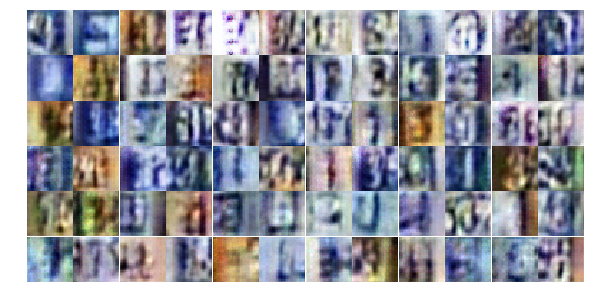

Epoch 25/25... Discriminator Loss: 1.0520... Generator Loss: 2.0295
Epoch 25/25... Discriminator Loss: 0.9436... Generator Loss: 1.3024
Epoch 25/25... Discriminator Loss: 0.8497... Generator Loss: 1.5274
Epoch 25/25... Discriminator Loss: 1.2183... Generator Loss: 0.9835
Epoch 25/25... Discriminator Loss: 0.9169... Generator Loss: 1.0054
Epoch 25/25... Discriminator Loss: 0.9032... Generator Loss: 1.4314
Epoch 25/25... Discriminator Loss: 0.9701... Generator Loss: 1.3413
Epoch 25/25... Discriminator Loss: 1.0689... Generator Loss: 0.8794
Epoch 25/25... Discriminator Loss: 0.8863... Generator Loss: 1.0700
Epoch 25/25... Discriminator Loss: 1.0253... Generator Loss: 0.8578


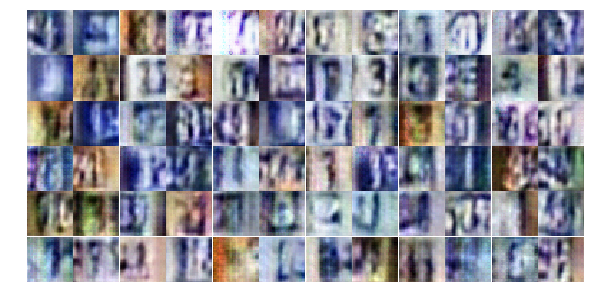

Epoch 25/25... Discriminator Loss: 1.0440... Generator Loss: 1.3228
Epoch 25/25... Discriminator Loss: 0.7172... Generator Loss: 1.3085
Epoch 25/25... Discriminator Loss: 0.8598... Generator Loss: 1.3615
Epoch 25/25... Discriminator Loss: 0.9122... Generator Loss: 1.3193
Epoch 25/25... Discriminator Loss: 0.9745... Generator Loss: 1.1044
Epoch 25/25... Discriminator Loss: 0.8931... Generator Loss: 1.1961
Epoch 25/25... Discriminator Loss: 0.8816... Generator Loss: 1.0717
Epoch 25/25... Discriminator Loss: 0.9987... Generator Loss: 0.8954
Epoch 25/25... Discriminator Loss: 1.0405... Generator Loss: 0.9433
Epoch 25/25... Discriminator Loss: 0.8534... Generator Loss: 1.1778


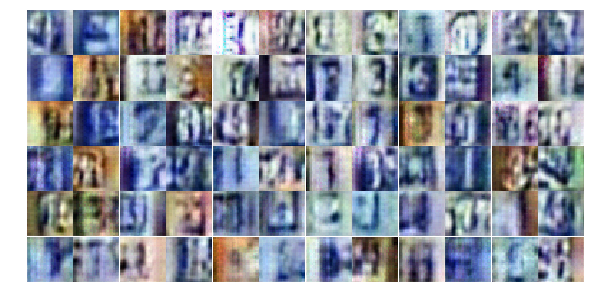

Epoch 25/25... Discriminator Loss: 0.9501... Generator Loss: 1.1123
Epoch 25/25... Discriminator Loss: 0.7172... Generator Loss: 1.4230


In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

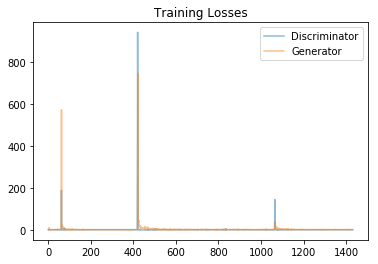

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

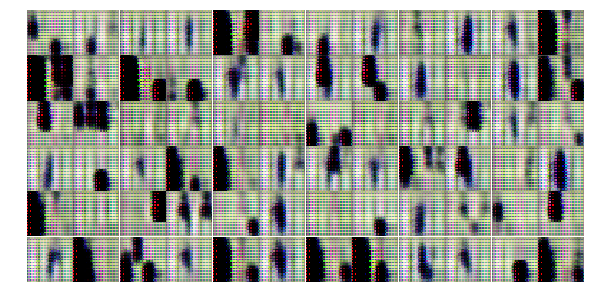

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))